In [4]:
import pandas as pd
data_location =  "../input/flickr8k"
caption_file = '../input/flickr8k/captions.txt'


## Custom dataset loader

In [5]:
import torch
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cpu')

In [6]:
import os
import pandas as pd
import spacy # for tokenizer
import torch
from torch.nn.utils.rnn import pad_sequence
from torch.utils.data import DataLoader, Dataset
from PIL import Image
import matplotlib.pyplot as plt
import torchvision.transforms as transforms

# python -m spacy download en
spacy_eng = spacy.load("en")

class Vocab_Builder:
    
    def __init__ (self,freq_threshold):

        # freq_threshold is to allow only words with a frequency higher 
        # than the threshold

        self.itos = {0 : "<PAD>", 1 : "<SOS>", 2 : "<EOS>", 3 : "<UNK>"}  #index to string mapping
        self.stoi = {"<PAD>" : 0, "<SOS>" : 1, "<EOS>" : 2, "<UNK>" : 3}  # string to index mapping
        self.freq_threshold = freq_threshold

    def __len__(self):
        return len(self.itos)
    
    @staticmethod
    def tokenizer_eng(text):
        #Removing spaces, lower, general vocab related work

        return [token.text.lower() for token in spacy_eng.tokenizer(text)]
    
    def build_vocabulary(self, sentence_list):
        frequencies = {} # dict to lookup for words
        idx = 4

        # FIXME better ways to do this are there
        for sentence in sentence_list:
            for word in self.tokenizer_eng(sentence):
                if word not in frequencies:
                    frequencies[word] = 1
                else:
                    frequencies[word] += 1 
                if(frequencies[word] == self.freq_threshold):
                    #Include it
                    self.stoi[word] = idx
                    self.itos[idx] = word
                    idx += 1
    
    # Convert text to numericalized values
    def numericalize(self,text):
        tokenized_text = self.tokenizer_eng(text) # Get the tokenized text
        
        # Stoi contains words which passed the freq threshold. Otherwise, get the <UNK> token
        return [self.stoi[token] if token in self.stoi else self.stoi["<UNK>"]
        for token in tokenized_text ]
    
    def denumericalize(self, tensors):
        text = [self.itos[token] if token in self.itos else self.itos[3]]
        return text

class FlickrDataset(Dataset):
    def __init__(self, root_dir, captions_file, test, transform = None, freq_threshold = 2):
        self.root_dir = root_dir
        self.df = pd.read_csv(caption_file)
        self.transform = transform
        # Get images, caption column from pandas
        split_factor = 37500 # 4000/ 5 = reserving 200 images for testing
        
        self.imgs = self.df["image"]
        self.imgs_test = self.imgs[split_factor:]
        self.imgs = self.imgs[0:split_factor]
        self.captions = self.df["caption"]
        self.captions_test = self.captions[split_factor:]
        self.captions = self.captions[0:split_factor]
        self.test = test
        #Init and Build vocab
        self.vocab = Vocab_Builder(freq_threshold) # freq threshold is experimental
        self.vocab.build_vocabulary(self.captions.tolist())

    def __len__(self):
        if (self.test == True):
            return len(self.imgs_test)
        
        return len(self.imgs)
    
    def __getitem__(self, index: int):
        
        if self.test == False:
            caption = self.captions[index]
            img_id = self.imgs[index]
        elif self.test == True:
            index += 37500
            caption = self.captions_test[index]
            img_id = self.imgs_test[index]
            
        img = Image.open(os.path.join(self.root_dir, img_id)).convert("RGB")
        if self.transform is not None:
            img = self.transform(img)
        
        numericalized_caption = [self.vocab.stoi["<SOS>"]] #stoi is string to index, start of sentence
        numericalized_caption += self.vocab.numericalize(caption) # Convert each word to a number in our vocab
        numericalized_caption.append(self.vocab.stoi["<EOS>"])

        #return tensor
        
        return img, torch.tensor(numericalized_caption)
    
    @staticmethod
    def evaluation(self, index : int):
        caption = self.captions_test[index]
        img_id = self.imgs_test[index]
        img = Image.open(os.path.join(self.root_dir, img_id)).convert("RGB")

        if self.transform is not None:
            img = self.transform(img)
        return img, caption
# Caption lengths will be different, in our batch all have to be same length


'''
Goes to the dataloader
'''
class Collate:
    def __init__(self, pad_idx):
        self.pad_idx = pad_idx

    def __call__(self, batch):
        imgs = [item[0].unsqueeze(0) for item in batch]
        
        imgs = torch.cat(imgs, dim=0)
        
        targets = [item[1] for item in batch]
        
        lengths = torch.tensor([len(cap) for cap in targets]).long()
        
        targets = pad_sequence(targets, batch_first=True, padding_value=self.pad_idx)
        
        return imgs, targets, lengths

# caption file, Maybe change num_workers

def get_loader( root_folder,annotation_file,  transform, batch_size = 32,  num_workers = 8, shuffle = True, pin_memory = False, test = False):
    


    dataset =  FlickrDataset(root_folder,  annotation_file, test, transform = transform)
    pad_idx = dataset.vocab.stoi["<PAD>"]

    loader = DataLoader(
        dataset = dataset,
        batch_size = batch_size,
        num_workers = num_workers,
        shuffle = shuffle,
        pin_memory = pin_memory,
        collate_fn =  Collate(pad_idx = pad_idx)
    )

    return loader, dataset

In [ ]:
vocabulary = Vocab_Builder(freq_threshold = 2)

df = pd.read_csv(data_location+"/captions.txt")

captions = df["caption"]

split_factor = 37500

captions = captions[0:split_factor]

vocabulary.build_vocabulary(captions.tolist())

In [ ]:
import pickle
with open('vocab.pickle', 'wb') as f:
    pickle.dump(vocabulary, f, protocol=pickle.HIGHEST_PROTOCOL)

In [7]:
import torch
import torch.nn as nn
import torchvision.models as models
# resnet50 = models.resnet50(pretrained = True)
import torch.nn.functional as F



In [8]:
class BahdanauAttention(nn.Module):
    
    '''
    Soft attention which is deterministic in nature. First introducted in 
    the paper Neural Machine Translation by Jointly Learning to Align and Translate (Bahdanau Et Al)
    '''
    
    def __init__(self, encoder_dim, decoder_dim, attention_dim):
        
        # Get the L attention dimension vector using this. Pass through softmax to get the 
        # score
        super(BahdanauAttention, self).__init__()
        
        self.attention = nn.Linear(attention_dim, 1)

        self.softmax = nn.Softmax(dim=1)
        
        self.relu = nn.ReLU()
        
        self.encoder_to_attention_dim = nn.Linear(encoder_dim, attention_dim)
        
        self.decoder_to_attention_dim = nn.Linear(decoder_dim, attention_dim)
        
        self.dropout = nn.Dropout(0.5)
        
        self.tanh = nn.Tanh()
        
    def forward(self, encoder_output, hidden_states):
        
        '''
        encoder_output : shape (batch_size, L, D)
        decoder_output : shape (batch_size, hidden_state dimension) 
        
        '''
      
        
        encoder_attention = self.encoder_to_attention_dim(encoder_output) # (batch_size, L, attention_dim)
        
        decoder_attention = self.decoder_to_attention_dim(hidden_states) # (batch_size, attention_dim)
        
        # Torch.cat() ?? 
        # >>> a = torch.cat((encoder,decoder.unsqueeze(1)),dim=1)
        # No, its actually adds the dim = 1 (Adds one more item in dim = 1)
        # We just want to add.
        
        
        #   (batch_size, L, attention_dim) + (batch_size, 1, attention_dim) 
        encoder_decoder = encoder_attention + decoder_attention.unsqueeze(1)  # (batch_size, L, attention_dim)
        
        encoder_decoder = self.tanh(encoder_decoder)
        
        attention_full = (self.attention(encoder_decoder)).squeeze(2) # (batch_size, L)
        
        alpha = self.softmax(attention_full) # Take the softmax across L(acc to paper)
        
        # One of the places where softmax is not used for classification only
        # but has a big role in life.(Mentioned in some lecture) Get a probablity distribution
        # where everything sums up to 1
        
        # Context vector is z
        # encoder_output is a aka annotation vector
        
        '''
        Equation 13 in the paper - classic Bahdanau attention
        '''
        
        z = (encoder_output * alpha.unsqueeze(2) ).sum(dim = 1) # Sum across L (pixels)
        
        return z, alpha
        
        


In [9]:


# Major changes include the ignoring of the last two layers. Author use a lower layer for more dense features.


class EncoderCNN(nn.Module):
   
    '''Takes in the image, encode it in shape (L,D) and return to decoder
        
        "The extractor produces L vectors, each of which is
        a D-dimensional representation corresponding to a part of
        the image"
        
    '''

    def __init__(self, encoded_size=14, train_CNN = False):
        
        super(EncoderCNN, self).__init__()
        
        # Fine-tune parameter
        self.train_CNN = train_CNN
        
        self.encoded_size =encoded_size
        
        # Load the resnet
        self.resnet50 = models.resnet50(pretrained=True)
        
        # Remove adaptive pool and FC from the end
        layers_to_use = list(self.resnet50.children())[:-3]
        
        # Unpack and make it the conv_net
        self.resnet = nn.Sequential(*layers_to_use)
        
#         self.fc = nn.Linear(in_features,encoded_size)
        
        self.adaptive_pool = nn.AdaptiveAvgPool2d((encoded_size, encoded_size))
        
        self.relu = nn.ReLU()
        
        self.dropout = nn.Dropout(0.5)
        
        if not train_CNN:
            for param in self.resnet.parameters():
                param.requires_grad = False
           
        
    def forward(self, images):
         
        # images.shape (batch_size, 3, image_size, image_size)    
            
        # Change the image_size dimensions. Check them yourself.
        batch_size = images.shape[0]
        
        with torch.no_grad():
            features = self.resnet(images) # Shape : (batch_size, encoder_dim, image_size/32, image_size/32)
        
        features = self.adaptive_pool(features) # Shape (batch_size, encoder_dim, encoded_size, encoded_size)
        
        features = features.permute(0, 2, 3, 1) # Shape : (batch_size, encoded_size, encoded_size, encoder_dim)
        
        # The above transformation is needed because we are going to do some computation in the 
        # decoder.
        encoder_dim = features.shape[-1]
        # When in doubt https://stackoverflow.com/questions/42479902/how-does-the-view-method-work-in-pytorch
        features = features.view(batch_size, -1, encoder_dim)  # (batch_size, L, D)
        
#         print("-" * 80 )
        
#         print("Features shape : " , features.shape)
        
#         print("-" * 80 )
        
        return features
    
    
# In decoder, we use an LSTM cell. So, remove num_layers
# https://stackoverflow.com/questions/57048120/pytorch-lstm-vs-lstmcell
# In seq to seq model, it's more like gettign the state and ending the for loop when 
# you get the <EOS>

class Decoder(nn.Module):
    def __init__(self,encoder_dim, decoder_dim, embed_size, vocab_size, attention_dim, dropout = 0.5):
        
        super(Decoder,self).__init__()
        
        # Setting everything for the perfect model!
        
        self.embed = nn.Embedding(vocab_size, embed_size) # Embedding layer courtesy Pytorch
        
        
        self.encoder_dim = encoder_dim
        
        self.decoder_dim = decoder_dim
        
        self.attention_dim = attention_dim
        
        self.embed_dim = embed_size
        
        self.vocab_size = vocab_size
        
        self.dropout = dropout
        
        # Note, it's an LSTM Cell, features + embedding
        self.lstm = nn.LSTMCell(self.encoder_dim + self.embed_dim, self.decoder_dim, bias=True)
        
        self.attention = BahdanauAttention(encoder_dim, decoder_dim, attention_dim)
        
        self.f_beta = nn.Linear(self.decoder_dim, self.encoder_dim)
        
        self.sigmoid = nn.Sigmoid()
        
        # See the paper 
        '''
        The initial memory state and hidden state of the LSTM
        are predicted by an average of the annotation vectors fed.
        through two separate MLPs (init,c and init,h):
        '''
        
        self.init_h = nn.Linear(encoder_dim, decoder_dim)
        self.init_c = nn.Linear(encoder_dim, decoder_dim)
        
        # Not sure if I will use deep output layers
        # deep output layers
        self.L_h = nn.Linear(decoder_dim, embed_size, bias=False)
        self.L_z = nn.Linear(encoder_dim, embed_size, bias=False)
        self.L_o = nn.Linear(embed_size, vocab_size, bias=False)
        
        self.tanh = nn.Tanh()
        self.fc = nn.Linear(decoder_dim, vocab_size)  # linear layer to find scores over vocabulary
        self.init_weights()
        self.init_weights()
        
    # Encoder output is the annotated vector a (L,D) in the paper
    
    def initialise_hidden_states(self, encoder_output):
        
        '''
        Initialise the hidden states before forward prop. As given in the paper.
        Authors take the mean of annotation vector across L dimension. Pass it through an MLP.
        '''
        
        # encoder_output : shape (batch_size, L, encoder_dim=D)
        
        mean = (encoder_output).mean(dim = 1) # Take mean over L
        
        # Pass through Fully connected
        
        c_0 = self.init_c(mean)
        c_0 = self.tanh(c_0)
        h_0 = self.init_h(mean)
        h_0 = self.tanh(h_0)
        
        return h_0, c_0, 

    def init_weights(self):
        
        # This helps initially. Fill the following weights before starting.
        
        self.embed.weight.data.uniform_(-0.1,0.1)
        self.fc.weight.data.uniform_(-0.1,0.1)
        self.fc.bias.data.fill_(0)
    
    
    # Thankful to sgrvinod for this part. b
    def forward(self, encoder_output, caption, caption_lengths):
        
        '''
        encoder_output : shape(batch_size, L, D)
        caption : (max_length, batch_size )
        
        Get the encoder_output i.e the features.
        '''
        
        batch_size = encoder_output.size(0)
        # num_pixels 
        L = encoder_output.size(1)
        
        max_caption_length = caption.shape[-1] # shape : (batch_size, max_caption) 
        
        caption_lengths, sort_ind = caption_lengths.sort(dim=0, descending=True)
        encoder_output = encoder_output[sort_ind]
        caption = caption[sort_ind]
        
#         print(sort_ind)
        
        lengths = [l - 1 for l in caption_lengths]
        
        embedding_of_all_captions = self.embed(caption)
        
        predictions = torch.zeros(batch_size, max_caption_length - 1, self.vocab_size).to(device)
        alphas = torch.zeros(batch_size, max_caption_length - 1, L).to(device)  
        
        # Concat and pass through lstm to get hidden states
        
        h, c = self.initialise_hidden_states(encoder_output)
        
        
        
        # Exclude <EOS>, t is the th timestep
        # We get all the embeddings for the t timestep
        # Then we get the encoded_output aka annotation vector
        # Use soft attention to get the context vector.
        # Concat and pass through the lstm cell to get hidden states --> predictions
        
#         print(max_caption_length)
        
        for t in range(max_caption_length - 1):
            
            batch_size_t = sum([l > t for l in lengths]) 
            
            # z from the returning function
            context_vector, alpha = self.attention(encoder_output[:batch_size_t], h[:batch_size_t])
            
            # Changes inspirsed from SgdrVinod(Suggested in paper also)
            gate = self.sigmoid(self.f_beta(h[:batch_size_t]))
            
            gated_context = gate * context_vector
#             context_vector : torch.Size([32, 1024]), embedded_caption_t : torch.Size([32, 256])

            h, c = self.lstm(torch.cat([ embedding_of_all_captions[:batch_size_t,t,:], gated_context], dim=1),(h[:batch_size_t], c[:batch_size_t]))
            
            predict_deep = self.deep_output_layer(embedding_of_all_captions[:batch_size_t,t,:], h, context_vector)
            
            predictions[:batch_size_t, t, :] = predict_deep 
            
            alphas[:batch_size_t, t, :] = alpha
            
        return predictions, alphas, caption, lengths
        
        
 
    def deep_output_layer(self, embedded_caption, h, context_vector):
        """
        :param embedded_caption: embedded caption, a tensor with shape (batch_size, embed_dim)
        :param h: hidden state, a tensor with shape (batch_size, decoder_dim
        :param context_vector: context vector, a tensor with shape (batch_size, encoder_dim)
        :return: output
        """
        
        # Not working properly in early part of training. I don't know about this clearly.
        # scores = self.L_o(self.dropout(embedded_caption + self.L_h(h) + self.L_z(context_vector)))
        
        dropout = nn.Dropout(0.2)
        scores = dropout(self.fc(h))
        return scores
    
    def predict_caption(self, encoder_output, captions):
        
        # "<SOS>" 1
        caption_list = [1]
        alphas = [] 
        h, c = self.initialise_hidden_states(encoder_output)
        
        
        # 2 is <EOS>
        while len(caption_list) < 40 :
            word = caption_list[-1]
            
            embedded_caption = self.embed(  torch.LongTensor([word]).to(device)  )  # (1, embed_dim)
            
            context_vector, alpha = self.attention(encoder_output, h);
            
            gate = self.sigmoid(self.f_beta(h))
            
            gated_context = gate * context_vector
            
            h, c = self.lstm(torch.cat([embedded_caption, gated_context], dim=1), (h, c))
            
            predictions = self.deep_output_layer(embedded_caption, h, context_vector)  # (1, vocab_size)
            
            # item converts to python scalar otherwise expect CUDA re-assert trigger
            
            next_word = (torch.argmax(predictions, dim=1, keepdim=True).squeeze()).item()
            
            caption_list.append(next_word)
            
            alphas.append(alpha)
            
            if(caption_list[-1] == 2):
                break
        return caption_list, alphas
      
    def beam_search(self, encoder_output, beam_size = 3):
        
        k = beam_size
        
        vocab_size = self.vocab_size
        
        encoder_size = encoder_output.size(-1)
        
        encoder_output = encoder_output.view(1, -1, encoder_size)
        
        num_pixels = encoder_output.size(1)
        
        encoder_output = encoder_output.expand(k, num_pixels, encoder_size)  # (k, num_pixels, encoder_dim)
        
        # Vocab.stoi(SOS)
        k_prev_words = torch.LongTensor([[1]] * k).to(device) 
        seqs = k_prev_words
        
        top_k_scores = torch.zeros(k, 1).to(device)  # (k, 1)
        
        complete_seqs = list()
        complete_seqs_scores = list()
        
        step = 1
        
        h, c = self.initialise_hidden_states(encoder_output)
        
        while True:
            embedded_caption = self.embed(k_prev_words).squeeze(1)
            
            context_vector, alpha = self.attention(encoder_output, h);
            
            gate = self.sigmoid(self.f_beta(h))
            
            gated_context = gate * context_vector
            
            h, c = self.lstm(torch.cat([embedded_caption, gated_context], dim=1), (h, c))
            
            scores = self.deep_output_layer(embedded_caption, h, context_vector)
            
            scores = F.log_softmax(scores, dim=1)
            
            scores = top_k_scores.expand_as(scores) + scores
            
            if step == 1:
                top_k_scores, top_k_words = scores[0].topk(k, dim=0)  # (s)
            else:
                top_k_scores, top_k_words = scores.view(-1).topk(k, dim=0)  # (s)
                
            prev_word_inds = torch.true_divide(top_k_words , vocab_size).long().cpu()  # (s)
            next_word_inds = top_k_words % vocab_size  # (s)
            
             # Add new words to sequences
            seqs = torch.cat([seqs[prev_word_inds], next_word_inds.unsqueeze(1)], dim=1)  # (s, step+1)

            # Which sequences are incomplete (didn't reach <EOS>)?
            incomplete_inds = [ind for ind, next_word in enumerate(next_word_inds) if
                               next_word != 2 ] #vocab.itos['<EOS>']
            complete_inds = list(set(range(len(next_word_inds))) - set(incomplete_inds))

            # Set aside complete sequences
            if len(complete_inds) > 0:
                complete_seqs.extend(seqs[complete_inds].tolist())
                complete_seqs_scores.extend(top_k_scores[complete_inds])
            
            k -= len(complete_inds)  # reduce beam length accordingly

            # Proceed with incomplete sequences
            if k == 0:
                break
                
            seqs = seqs[incomplete_inds]
            
            h = h[prev_word_inds[incomplete_inds]]
            c = c[prev_word_inds[incomplete_inds]]
            
            encoder_output = encoder_output[prev_word_inds[incomplete_inds]]
            top_k_scores = top_k_scores[incomplete_inds].unsqueeze(1)
            k_prev_words = next_word_inds[incomplete_inds].unsqueeze(1)

            if step > 50:
                break
            step += 1
        
        if len(complete_seqs_scores) > 0:
            i = complete_seqs_scores.index(max(complete_seqs_scores))
            seq = complete_seqs[i]
            return seq
        else:
            return [1,2]
        return complete_seqs


         

In [10]:
import torch
import torchvision.transforms as transforms
from PIL import Image


def save_checkpoint(state, filename="./LastModel.pth.tar"):
    print("=> Saving checkpoint")
    torch.save(state, filename)


def load_checkpoint(checkpoint, model, optimizer):
    print("=> Loading checkpoint")
    model.load_state_dict(checkpoint["state_dict"])
    optimizer.load_state_dict(checkpoint["optimizer"])
    step = checkpoint["step"]
    return step

In [11]:
from matplotlib import pyplot as plt
import random


def show_image(inp, title=None):
    """Imshow for Tensor."""
    inp = inp.numpy().transpose((1, 2, 0))
    plt.imshow(inp)
    
 
    if title is not None:
        plt.title(title)
    plt.savefig('foo.png', bbox_inches='tight')
    
    plt.pause(0.001)  # pause a bit so that plots are updated

# Model parameters

In [12]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
from torch.utils.tensorboard import SummaryWriter
import torch.nn.functional as F
from torch.nn.utils.rnn import pack_padded_sequence
# from convert_text import get_loader
# from utils import *
# from model import CNNtoRNN
# from utils save_checkpoint, load_checkpoint, print_examples


# Training loop


In [40]:


mean = [0.485, 0.456, 0.406]

std = [0.229, 0.224, 0.225]

transform = transforms.Compose(
    [transforms.Resize((256,256)),
    transforms.ToTensor(),
    transforms.Normalize(mean, std)]
)

train_loader, dataset = get_loader(
    root_folder = data_location+"/Images",
    annotation_file = data_location+"/captions.txt",
    transform = transform, 
    num_workers = 4,
    test = False
)
test_loader, test_dataset = get_loader(
    root_folder = data_location+"/Images",
    annotation_file = data_location+"/captions.txt",
    transform = transform, 
    num_workers = 4,
    test = True
)


# Test_dataset gonna come here soon
# Think about that later. We will do some training phases. It will take time but keep your calm.

torch.backends.cudnn.benchmark = True # Get some boost probaby

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

load_model = True

save_model = False

train_CNN = False
#Hyperparameters

embed_size = 256
encoder_dim = 1024
decoder_dim = 400
attention_dim = 400
vocab_size = len(dataset.vocab)
learning_rate = 2e-4 # Earlier 3e-4
num_epochs = 21

# Tensorboard
writer = SummaryWriter("runs/flickr")

step = 0
# init model, loss
encoder = EncoderCNN() # Default arguments already given as encoder_size 14, train_CNN = False
# m_state_dict = torch.load('./resnet50_captioning.pt')
# encoder.load_state_dict(m_state_dict)
encoder = encoder.to(device)

decoder = Decoder(encoder_dim, decoder_dim, embed_size, vocab_size, attention_dim)    
decoder = decoder.to(device)
print(device)

alpha_c = 1.0  # Not used variable in code, used just 1.0  
# regularization parameter for 'doubly stochastic attention', as in the paper

# https://pytorch.org/tutorials/beginner/torchtext_translation_tutorial.html
# criterion = nn.CrossEntropyLoss(ignore_index=dataset.vocab.stoi["<PAD>"]).to(device)

criterion = nn.CrossEntropyLoss().to(device)


# Optimizer only for the decoder
optimizer = optim.Adam(decoder.parameters(), lr = learning_rate)

decoder.train()

if load_model:
    step = load_checkpoint(torch.load("../input/resnet15/LastModelResnet50_v2_16.pth.tar", map_location = 'cpu'), decoder, optimizer)

decoder.eval()
encoder.eval()
# Change the epoch before changing    
for epoch in range(0, 0):
    if save_model:
        checkpoint = {
            "state_dict" : decoder.state_dict(),
            "optimizer" : optimizer.state_dict(),
            "step" : step
        }

        if epoch % 5 == 0 and epoch != 0 or epoch > 15:
            filename = './LastModelResnet50_v2_' + str(epoch) +  '.pth.tar'
            save_checkpoint(checkpoint, filename)
    losses = []
    mvl = []
    for idx, (imgs, captions, lengths) in enumerate(train_loader):
#         optimizer.zero_grad() Init config

        imgs = imgs.to(device)
        captions = captions.to(device)
        lengths = lengths.to(device)
        # Pass through the encoder and get the annotation vector
        encoded_images = encoder(imgs)

        scores, alphas, sorted_cap, decode_lengths = decoder(encoded_images, captions, lengths)
        
        # We don't want <SOS>
        sorted_cap = sorted_cap[:,1:] # shape (batch_size, max_caption)
        
        # Remove timesteps that we didn't decode at, or are pads
        # pack_padded_sequence is an easy trick to do this
        
        scores = pack_padded_sequence(scores, decode_lengths, batch_first=True).data
        targets = pack_padded_sequence(sorted_cap, decode_lengths, batch_first=True).data
        

        # Calculate loss
        loss = criterion(scores, targets)
        
        
#         batch_size = sorted_cap.shape[0]
#         caption_length = sorted_cap.shape[1]
        
#         loss = criterion(predictions.view(batch_size * caption_length, -1), sorted_cap.reshape(-1))

#       Doubly stochastic attention regularization but not using the beta so not proper
        loss += 1.0 * ((1. - alphas.sum(dim=1)) ** 2).mean()

        losses.append(loss.item())
        
        decoder.zero_grad()
        encoder.zero_grad()
        
        loss.backward()

        print("Step", idx, loss.item())

        writer.add_scalar("training loss", loss.item(), global_step = step)

        step += 1


        optimizer.step()

        if (idx )% 100 == 0:
            print("Epoch: {} loss: {:.5f}".format(epoch,loss.item()))
            encoder.eval()
            decoder.eval()
            with torch.no_grad():
                bleu_score_checker() # BLEU should be done separately
                dataiter = iter(train_loader)
                imgs,captions, lengths = next(dataiter)
                imgs = imgs
                captions = captions.to(device)
                encoded_output = encoder( (imgs[0].unsqueeze(0).to(device)) )

                # Does not make a difference for the caption since we are not using it
                caption_greedy, alphas = decoder.predict_caption(encoded_output, captions)
                caps_greedy =[dataset.vocab.itos[idx] for idx in caption_greedy]
                caption = ' '.join(caps_greedy)
                print("Greedy search", caption)
                
                caption = decoder.beam_search(encoded_output, 4)
                caps = [dataset.vocab.itos[idx] for idx in caption]
                print("Beam search", ' '.join(caps) )

                show_image(imgs[0],title=' '.join(caps))
            decoder.train()
        # Valid loss
        if (idx ) % 200 == 0 :
            valid_losses = []
            decoder.eval()
            encoder.eval()
            print("Valid section")
            with torch.no_grad():
                for index, (imgs, captions, lengths) in enumerate(test_loader):
                    imgs = imgs.to(device)
                    captions = captions.to(device)
                    lengths = lengths.to(device)
                    
                    encoded_images = encoder(imgs)
                    scores, alphas, sorted_cap, decode_lengths = decoder(encoded_images, captions, lengths)

                    # We don't want <SOS>
                    sorted_cap = sorted_cap[:,1:] # shape (batch_size, max_caption)

                    scores = pack_padded_sequence(scores, decode_lengths, batch_first=True).data
                    targets = pack_padded_sequence(sorted_cap, decode_lengths, batch_first=True).data

                    valid_loss = criterion(scores, targets)
# 
#                     batch_size = sorted_cap.shape[0]
#                     caption_length = sorted_cap.shape[1]
# 
#                     valid_loss = criterion(predictions.view(batch_size * caption_length, -1), sorted_cap.reshape(-1))
                    
                    valid_loss += 1.0 * ((1. - alphas.sum(dim=1)) ** 2).mean()
                    
                    valid_losses.append(valid_loss.item())

                    print("Step", index, valid_loss.item())
            decoder.train()

            print("-" * 80)
            mean_valid_loss = sum(valid_losses)/len(valid_losses)
            mvl.append(mean_valid_loss)
            print(mean_valid_loss)        
            print("-" * 80)                        
    
    mean_loss = sum(losses)/len(losses)
    print("-" * 80)
    print("Mean loss", mean_loss)
    print(mvl)
    print("-" * 80)




cpu
=> Loading checkpoint


## Saving resnet weights for deployment purpose

In [41]:
# # torch.save(encoder.state_dict(), 'resnet50_captioning.pt')
# rand_encoder = EncoderCNN()
# m_state_dict = torch.load('./resnet50_captioning.pt')
# rand_encoder.load_state_dict(m_state_dict)
# rand_encoder = rand_encoder.to(device)
# rand_encoder.eval()

In [42]:
from torchtext.data.metrics import bleu_score

['two', 'women', 'in', 'pink', 'sit', 'on', 'a', 'bench']
['two', 'girls', 'sit', 'on', 'the', 'stairs', 'outside', 'of', 'a', 'restaurant']
['two', 'people', 'sitting', 'on', 'a', 'bench', 'at', 'a', 'bar']
['the', 'two', 'girls', 'are', 'sitting', 'at', 'an', 'outdoor', 'cafe', 'table']


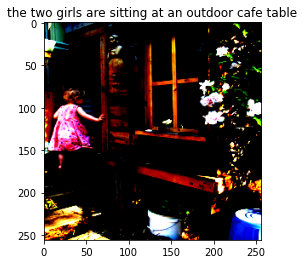

Original ['A', 'child', 'in', 'a', 'pink', 'dress', 'is', 'climbing', 'up', 'a', 'set', 'of', 'stairs', 'in', 'an', 'entry', 'way']
['two', 'dogs', ',', 'one', 'black', 'and', 'one', 'black', 'and', 'white', 'dog', ',', 'run', 'on', 'the', 'grass', ',', 'a', 'larger', 'dog', 'and', 'a', 'ball']
['three', 'dogs', 'are', 'playing', 'together', 'on', 'the', 'dirt']
['a', 'black', 'dog', 'and', 'a', 'brown', 'dog', 'are', 'playing', 'together']
['a', 'black', 'dog', 'and', 'a', 'brown', 'dog', 'play', 'together']


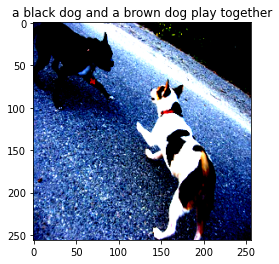

Original ['A', 'black', 'dog', 'and', 'a', 'spotted', 'dog', 'are']
['a', 'little', 'girl', 'is', 'in', 'a', 'field', 'of', 'colorful', 'water', '.']
['a', 'little', 'girl', 'is', 'sitting', 'in', 'a', 'colorful', 'tent', 'with', 'a', 'hose']
['a', 'young', 'girl', 'sits', 'in', 'front', 'of', 'a', 'painted', 'rainbow']
['a', 'little', 'girl', 'is', 'sitting', 'in', 'a', 'bright', 'colored', 'kayak']


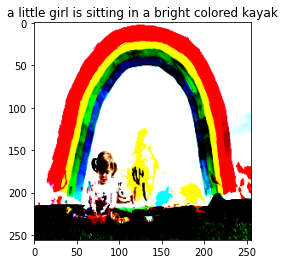

Original ['A', 'little', 'girl', 'covered', 'in', 'paint', 'sits', 'in', 'front', 'of', 'a', 'painted', 'rainbow', 'with', 'her', 'hands', 'in', 'a', 'bowl']
['two', 'men', 'with', 'their', 'equipment', 'are', 'standing', 'on', 'the', 'edge', 'deck', 'of', 'a', 'bridge']
['a', 'man', 'lays', 'on', 'his', 'back', 'while', 'a', 'dog', 'sits', 'in', 'the', 'background']
['a', 'man', 'lays', 'on', 'a', 'bench', 'while', 'another', 'dog', 'watches', 'him']
['two', 'young', 'boys', 'play', 'with', 'a', 'dog', 'toy']


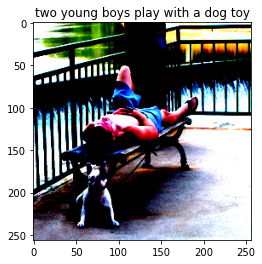

Original ['A', 'man', 'lays', 'on', 'a', 'bench', 'while', 'his', 'dog', 'sits', 'by', 'him']
['man', 'with', 'a', 'hat', 'and', 'a', 'hat', 'with', 'an', 'american', 'flag', 'on', 'the', 'beach']
['a', 'man', 'with', 'a', 'straw', 'hat', 'and', 'sunglasses']
['a', 'man', 'with', 'a', 'straw', 'hat', 'and', 'sunglasses']
['a', 'man', 'wearing', 'a', '<UNK>', 'hat', 'and', 'sunglasses', 'smiles']


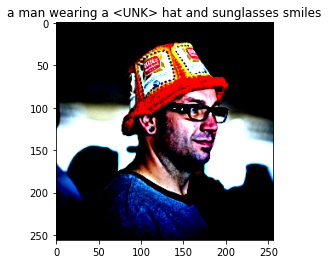

Original ['A', 'man', 'in', 'an', 'orange', 'hat', 'starring', 'at', 'something']
['a', 'girl', 'in', 'a', 'red', 'shirt', 'climbs', 'on', 'monkey', 'bars']
['two', 'girls', 'on', 'a', 'red', 'jungle', 'gym']
['a', 'girl', 'on', 'a', 'red', 'jungle']
['a', 'young', 'girl', 'climbs', 'on', 'a', 'red', 'jungle']


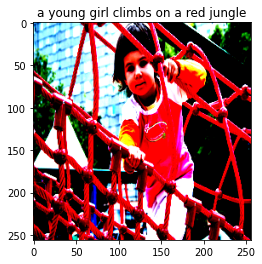

Original ['A', 'child', 'playing', 'on', 'a', 'rope', 'net']
['the', 'black', 'dog', 'is', 'bringing', 'the', 'owner', 'is', 'running', 'through', 'a', 'grassy', 'area']
['a', 'black', 'and', 'white', 'dog', 'is', 'running', 'through', 'a', 'grassy', 'field']
['two', 'black', 'and', 'white', 'dogs', 'are', 'running', 'through', 'the', 'grass']
['a', 'black', 'and', 'tan', 'dog', 'is', 'running', 'through', 'a', 'grassy', 'area']


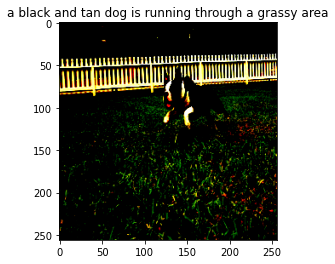

Original ['A', 'black', 'and', 'white', 'dog', 'is', 'running', 'in', 'a', 'grassy', 'garden', 'surrounded', 'by', 'a', 'white', 'fence']
['two', 'white', 'dogs', 'are', 'running', 'on', 'a', 'beach', 'with', 'a', 'red', 'ball', 'behind', 'them']
['two', 'white', 'dogs', 'are', 'running', 'on', 'a', 'beach']
['two', 'white', 'dogs', 'running', 'on', 'a']
['two', 'dogs', 'run', 'through', 'the', 'water']


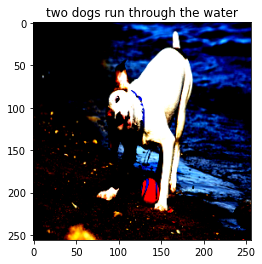

Original ['A', 'dog', 'shakes', 'its', 'head', 'near', 'the', 'shore', ',', 'a', 'red', 'ball', 'next', 'to', 'it']
['a', 'boy', 'wearing', 'a', 'white', 'shirt', 'is', 'holding', 'a', 'rope', 'bottle', 'in', 'the', 'street', 'while', 'a', 'man', 'walks', 'down', 'by']
['a', 'boy', 'in', 'a', 'striped', 'shirt', 'is', 'standing', 'on', 'a', 'post', 'in', 'front', 'of', 'a', 'tree']
['a', 'little', 'boy', 'is', 'walking', 'on', 'a', 'sidewalk']
['a', 'boy', 'in', 'a', 'blue', 'sweatshirt', 'is', 'standing', 'in', 'front', 'of', 'some', 'steps']


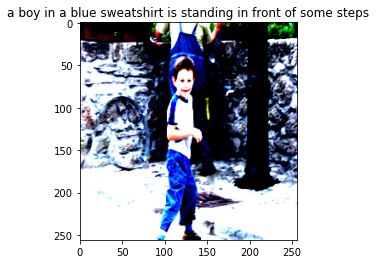

Original ['A', 'boy', 'smiles', 'in', 'front', 'of', 'a', 'stony', 'wall', 'in', 'a', 'city']
['a', 'black', 'dog', 'jumps', 'over', 'another', 'log']
['a', 'black', 'dog', 'jumps', 'over', 'a', 'fallen', 'tree']
['a', 'black', 'dog', 'is', 'jumping', 'over', 'a', 'fallen', 'tree']
['a', 'black', 'dog', 'jumps', 'over', 'a', 'log', 'in', 'the', 'air']


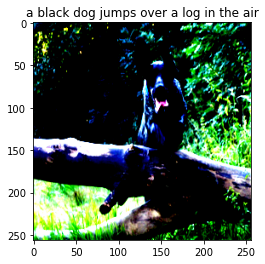

Original ['A', 'black', 'dog', 'leaps', 'over', 'a', 'log']
['the', 'white', 'dog', 'is', 'running', 'through', 'snow']
['a', 'white', 'dog', 'and', 'a', 'black', 'and', 'white', 'dog', 'run', 'in', 'the', 'sand']
['two', 'white', 'dogs', 'running', 'in', 'the', 'snow']
['a', 'white', 'and', 'brown', 'dog', 'is', 'running', 'through', 'the', 'snow']


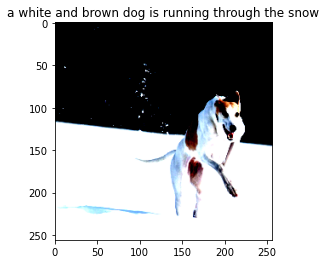

Original ['A', 'brown', 'and', 'white', 'dog', 'is', 'running', 'through', 'the', 'snow']
['a', 'man', 'skis', 'over', 'a', 'snowy', 'field', 'in', 'winter', 'winter', 'clothing']
['a', 'group', 'of', 'cross', '-', 'country', 'skiers', 'making', 'a', 'jump']
['two', 'girls', 'are', 'walking', 'through', 'a', 'snow', '-', 'covered', 'street']
['a', 'man', 'and', 'a', 'woman', 'pose', 'on', 'a', 'snowy', 'hill']


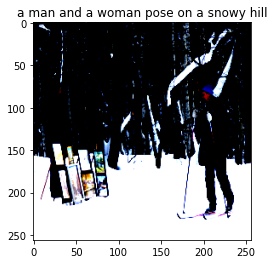

Original ['A', 'man', 'in', 'a', 'hat', 'is', 'displaying', 'pictures', 'next', 'to', 'a', 'skier', 'in', 'a', 'blue', 'hat']
['a', 'group', 'of', 'people', 'are', 'climbing', 'up', 'a', 'rock', 'climbing', 'wall']
['a', 'group', 'of', 'people', 'climbing', 'a', 'rock', 'face', 'with', 'a', 'man', 'standing', 'on', 'it']
['a', 'group', 'of', 'men', 'climbing', 'a', 'rock', 'wall']
['four', 'children', 'are', 'climbing', 'a', 'rock']


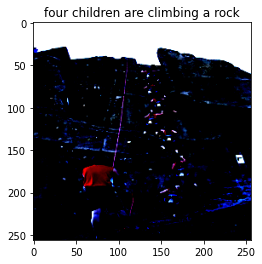

Original ['A', 'collage', 'of', 'one', 'person', 'climbing', 'a', 'cliff']
['two', 'brown', 'dogs', 'are', 'playing', 'with', 'a', 'ball', 'in', 'a', 'yard', '.']
['two', 'dogs', 'are', 'playing', 'with', 'a', 'hose']
['a', 'dog', 'chases', 'a', 'frisbee', 'while', 'a', 'brown', 'dog', 'watches']
['two', 'dogs', 'run', 'through', 'the', 'grass']


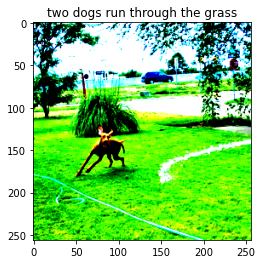

Original ['A', 'brown', 'dog', 'chases', 'the', 'water', 'from', 'a', 'sprinkler', 'on', 'a', 'lawn']
['a', 'white', 'dog', 'with', 'a', 'red', 'collar', 'on', 'a', 'leash', 'is', 'running', 'in', 'a', 'field', '.']
['a', 'white', 'dog', 'with', 'a', 'red', 'collar', 'and', 'a', 'yellow', 'toy', 'in', 'its', 'mouth', 'running', 'in', 'a', 'field']
['two', 'dogs', 'are', 'running', 'through', 'the', 'grass']
['a', 'white', 'and', 'brown', 'dog', 'is', 'playing', 'with', 'a', 'ball', 'in', 'its', 'mouth']


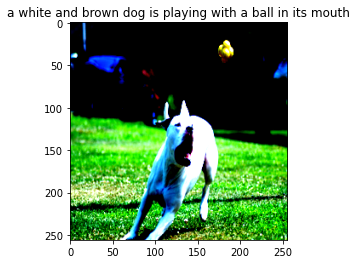

Original ['A', 'dog', 'prepares', 'to', 'catch', 'a', 'thrown', 'object', 'in', 'a', 'field', 'with', 'nearby', 'cars']
['a', 'white', 'dog', 'and', 'brown', 'dog', 'jumping', 'to', 'catch', 'a', 'tennis']
['a', 'white', 'dog', 'is', 'playing', 'with', 'a', 'ball', 'in', 'a', 'field']
['a', 'dog', 'chases', 'a', 'ball']
['a', 'white', 'dog', 'is', 'playing', 'with', 'an', 'orange', 'dog', 'in', 'a', 'field']


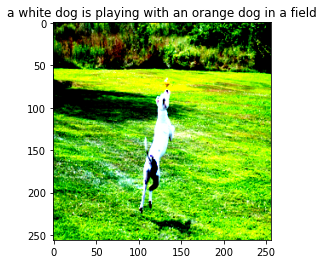

Original ['a', 'black', 'and', 'white', 'dog', 'jumping', 'in', 'the', 'air', 'to', 'get', 'a', 'toy']
['two', 'boys', 'are', 'playing', 'on', 'a', 'lake', 'in', 'a', 'lake']
['two', 'boys', 'play', 'in', 'a', 'fountain', 'in', 'a', 'city']
['two', 'young', 'boys', 'play', 'in', 'the', 'water']
['a', 'boy', 'and', 'a', 'girl', 'are', 'playing', 'on', 'a', 'lake']


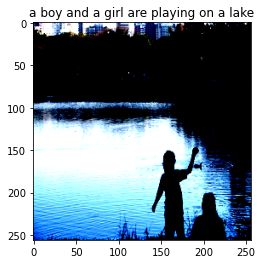

Original ['A', 'child', 'and', 'a', 'woman', 'are', 'at', 'waters', 'edge', 'in', 'a', 'big', 'city']
['two', 'young', 'women', 'are', 'standing', 'next', 'a', 'man', 'on', 'a', 'bench', 'with', 'a', 'baby']
['the', 'woman', 'in', 'the', 'black', 'shirt', 'is', 'standing', 'next', 'to', 'a', 'man', 'who', 'is', 'sitting', 'on', 'the', 'bench']
['the', 'woman', 'in', 'the', 'black', 'sweater', 'is', 'standing', 'next', 'to', 'a', 'man', 'who', 'is', 'standing', 'next', 'to', 'a', 'fence']
['a', 'man', 'and', 'a', 'woman', 'sit', 'at', 'a', 'table', 'outdoors']


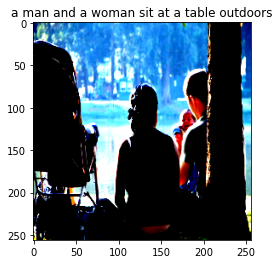

Original ['A', 'couple', 'and', 'an', 'infant', ',', 'being', 'held', 'by', 'the', 'male', ',', 'sitting', 'next', 'to', 'a', 'pond', 'with', 'a', 'near', 'by', 'stroller']
['a', 'black', 'dog', 'running', 'through', 'the', 'water', 'with', 'a', 'ball', 'in', 'his', 'mouth']
['a', 'wet', 'dog', 'running', 'through', 'the', 'water']
['black', 'dog', 'running', 'through']
['two', 'black', 'dogs', 'running', 'in', 'the', 'surf']


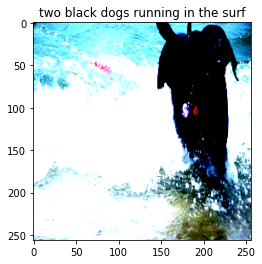

Original ['A', 'black', 'dog', 'running', 'in', 'the', 'surf']
['a', 'man', 'drilling', 'a', 'hole', 'into', 'the', 'beach']
['three', 'people', 'are', 'on', 'a', 'boat', 'in', 'the', 'snow']
['a', 'man', 'drilling', 'through', 'the', 'water']
['a', 'man', 'is', 'drilling', 'a', 'boat', 'through', 'the', 'water']


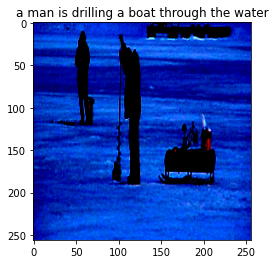

Original ['A', 'man', 'drilling', 'a', 'hole', 'in', 'the', 'ice']
['two', 'dogs', 'are', 'playing', 'in', 'the', 'sand']
['three', 'dogs', 'are', 'playing', 'together', 'in', 'the']
['two', 'brown', 'dogs', 'are', 'playing', 'with', 'each', 'other', 'on', 'the', 'beach']
['a', 'brown', 'dog', 'and', 'a', 'brown', 'dog', 'are', 'standing', 'on', 'the', 'beach']


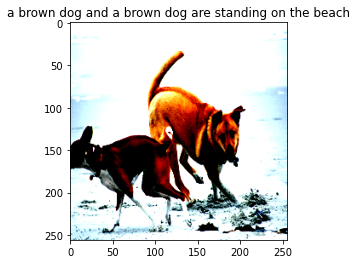

Original ['Two', 'different', 'breeds', 'of', 'brown', 'and', 'white', 'dogs', 'play', 'on', 'the', 'beach']
['two', 'people', 'in', 'the', 'snow', 'are', 'ice']
['a', 'person', 'in', 'a', 'red', 'jacket', 'and', 'black', 'pants', 'is', 'holding', 'a', 'white', 'bag', 'in', 'the', 'ocean']
['a', 'person', 'in', 'a', 'red', 'jacket', 'is', 'snowboarding']
['a', 'person', 'in', 'a', 'red', 'jacket', 'climbs', 'up', 'a', 'cliff']


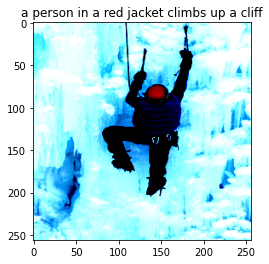

Original ['A', 'man', 'uses', 'ice', 'picks', 'and', 'crampons', 'to', 'scale', 'ice']
['a', 'black', 'dog', 'is', 'running', 'through', 'a', 'field']
['a', 'black', 'dog', 'with', 'a', 'blue', 'toy', 'in', 'his', 'mouth', 'is', 'running', 'through', 'the', 'grass']
['a', 'black', 'dog', 'is', 'running', 'through', 'a', 'grassy', 'field']
['a', 'dog', 'in', 'a', 'field', 'of', 'grass']


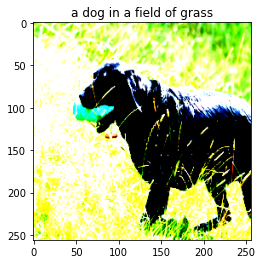

Original ['A', 'black', 'dog', 'carries', 'a', 'green', 'toy', 'in', 'his', 'mouth', 'as', 'he', 'walks', 'through', 'the', 'grass']
['a', 'group', 'and', 'people', 'in', 'life', 'jackets', 'on', 'a', 'yellow', 'boat', 'on', 'calm']
['a', 'man', 'and', 'a', 'woman', 'are', 'sitting', 'in', 'a', 'yellow', 'kayak']
['a', 'man', 'and', 'a', 'woman', 'in', 'a']
['two', 'boys', 'play', 'in', 'an', 'inflatable', 'raft']


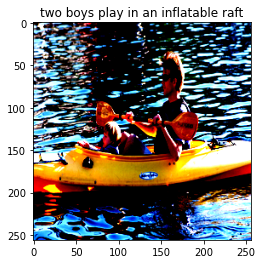

Original ['A', 'man', 'and', 'a', 'baby', 'are', 'in', 'a', 'yellow', 'kayak', 'on', 'water']
['two', 'brown', 'dogs', 'are', 'running', 'through', 'a', 'grassy', 'field']
['two', 'brown', 'dogs', 'playfully', 'wrestle', 'with', 'each', 'other']
['two', 'dogs', 'are', 'running', 'through', 'the', 'grass']
['two', 'dogs', 'are', 'running']


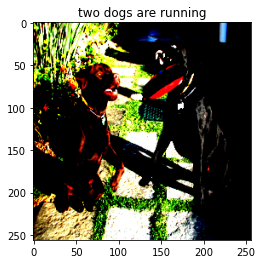

Original ['A', 'black', 'dog', 'and', 'a', 'brown', 'dog', 'are', 'jumping', 'up', 'to', 'catch', 'a', 'red', 'toy']
['two', 'young', 'children', 'play', 'on', 'the', 'red', 'and', 'red', 'ball']
['a', 'boy', 'in', 'a', 'red', 'and', 'white', 'soccer', 'uniform', 'stands', 'on', 'a', 'red', 'and', 'white', 'soccer', 'ball']
['two', 'young', 'children', 'playing', 'on', 'a', '<UNK>', 'outside']
['two', 'young', 'children', 'play', 'on', 'a', 'red', 'and', 'red', 'ball']


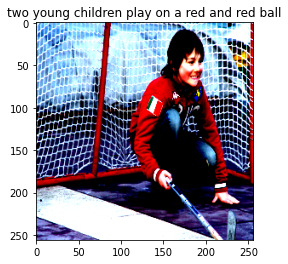

Original ['A', 'boy', 'with', 'a', 'stick', 'kneeling', 'in', 'front', 'of', 'a', 'goalie']
['a', 'man', 'stands', 'near', 'a', 'building', 'with', 'a', 'large', 'building', '.']
['two', 'men', 'are', 'standing', 'by', 'a', 'building', ',', 'one', 'is', 'making', 'a', '<UNK>']
['two', 'people', 'sit', 'on', 'a', 'bench']
['two', 'men', 'are', 'sitting', 'on', 'a', 'bench', 'outside', 'of', 'a', 'building']


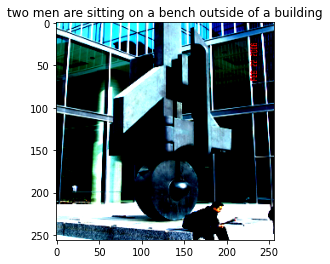

Original ['A', 'man', 'in', 'black', 'is', 'sitting', 'next', 'to', 'a', 'modern', 'art', 'structure', 'in', 'front', 'of', 'a', 'glass', 'building']
['two', 'men', 'on', 'a', 'sled', 'walk', 'through', 'the', 'snow', 'with', 'a', 'blue', 'one', 'looking', 'away']
['two', 'people', 'on', 'a', 'sled', 'walk', 'through', 'the', 'snow']
['two', 'people', 'are', 'looking', 'into', 'the', 'water']
['three', 'people', 'are', 'standing', 'on', 'the', 'ice']


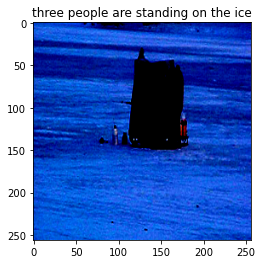

Original ['A', 'tent', 'is', 'being', 'set', 'up', 'on', 'the', 'ice']
['a', 'man', 'and', 'a', 'dog', 'are', 'playing', 'with', 'each', 'other', 'in', 'the', 'grass', 'near', 'the']
['a', 'dog', 'and', 'a', 'woman', 'in', 'a', 'grassy']
['three', 'dogs', 'are', 'standing', 'in', 'a', 'grassy', 'field']
['a', 'group', 'of', 'dogs', 'playing', 'in', 'a', 'field']


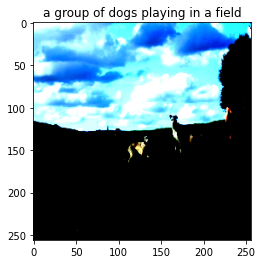

Original ['A', 'woman', 'crouches', 'near', 'three', 'dogs', 'in', 'a', 'field']
['a', 'man', 'in', 'a', 'blue', 'hat', 'is', 'standing', 'in', 'front', 'of', 'a', 'city']
['a', 'man', 'stands', 'in', 'front', 'of', 'an', 'outdoor', 'building']
['a', 'man', 'stands', 'next', 'to', 'a', 'city']
['two', 'people', 'standing', 'in', 'front', 'of', 'a', 'building']


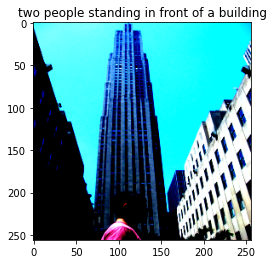

Original ['a', 'man', 'is', 'standing', 'in', 'front', 'of', 'a']
['a', 'boy', 'in', 'a', 'red', 'shirt', 'eats', 'a', 'food', 'while', 'a', 'man', 'in', 'a', 'red', 'and', 'white', 'shirt']
['the', 'boy', 'is', 'eating', 'and', 'playing', 'the', 'food']
['the', 'boy', 'is', 'eating', 'something', 'while', 'eating', 'a', 'cookie']
['a', 'small', 'child', 'in', 'a', 'red', 'shirt', 'eats', 'a', 'food']


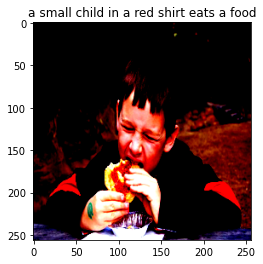

Original ['A', 'boy', 'bites', 'hard', 'into', 'a', 'treat', 'while', 'he', 'sits', 'outside']
['three', 'people', 'sit', 'on', 'a', 'rock', 'overlooking', 'a', 'valley']
['three', 'men', 'and', 'women', 'sit', 'on', 'a', 'mountain']
['three', 'people', 'are', 'sitting', 'on', 'top', 'of', 'a', 'cliff', 'overlooking', 'a', 'valley']
['a', 'group', 'of', 'people', 'are', 'sitting', 'on', 'top', 'of', 'a', 'mountain']


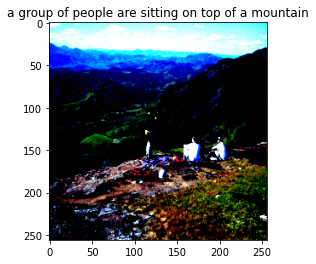

Original ['People', 'sit', 'on', 'the', 'mountainside', 'and', 'check', 'out', 'the', 'view']
['a', 'young', 'boy', 'in', 'a', 'green', 'shirt', 'kicks', 'a', 'yellow', 'ball', 'while', 'people', 'in', 'the', 'back']
['a', 'boy', 'in', 'an', 'orange', 't', '-', 'shirt', 'jumps', 'into', 'the', 'water']
['a', 'boy', 'in', 'a', 'green', 'shirt', 'is', 'laying', 'on', 'the', 'floor', 'in', 'front', 'of', 'a', 'crowd', 'of', 'people']
['a', 'boy', 'in', 'a', 'green', 't', '-', 'shirt', 'is', 'jumping', 'into', 'a', 'pile', 'of', 'other', 'people']


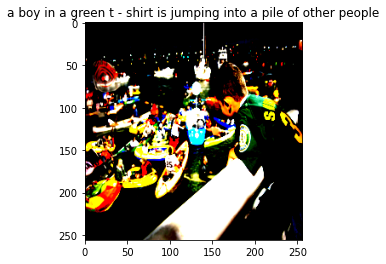

Original ['A', 'boy', 'in', 'a', 'green', 'shirt', 'is', 'looking', 'down', 'at', 'many', 'inflatable', 'boats']
['two', 'girls', 'are', 'sitting', 'on', 'a', 'bench', 'and', 'smiling']
['two', 'people', 'pose', 'for', 'a', 'picture']
['two', 'girls', 'pose', 'for', 'the', 'camera']
['three', 'people', 'pose', 'for', 'the', 'camera']


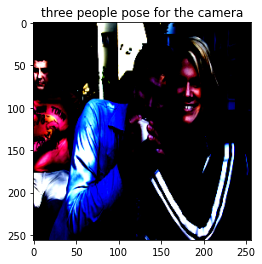

Original ['A', 'man', 'and', 'woman', 'pose', 'for', 'the', 'camera', 'while', 'another', 'man', 'looks', 'on']
['two', 'men', 'in', 'a', 'crowd', 'sitting', 'in', 'a', 'room']
['four', 'people', 'are', 'sitting', 'around', 'a', 'bonfire', 'at', 'a', 'table']
['a', 'group', 'of', 'people', 'are', 'sitting', 'around', 'a', 'table', 'at', 'an', 'outside', 'of', 'an', 'audience']
['several', 'men', 'are', 'sitting', 'around', 'a', 'table', 'in', 'front', 'of', 'a', 'television']


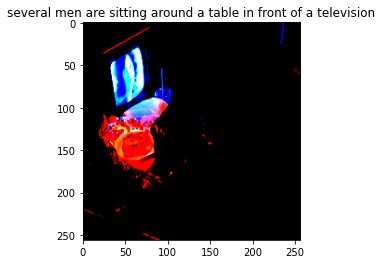

Original ['A', 'person', 'eats', 'takeout', 'while', 'watching', 'a', 'small', 'television']
['a', 'group', 'of', 'seven', 'people', 'are', 'standing', 'on', 'a', 'ledge', 'overlooking', 'a', 'city', 'beach']
['a', 'group', 'of', 'people', 'sit', 'on', 'the', 'beach']
['many', 'people', 'are', 'standing', 'on', 'the', 'edge', 'of', 'a', 'cliff', 'overlooking', 'a', 'city']
['a', 'bunch', 'of', 'people', 'at', 'a', 'beach']


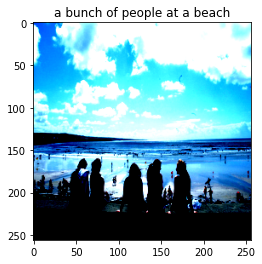

Original ['a', 'couple', 'of', 'several', 'people', 'sitting', 'on', 'a', 'ledge', 'overlooking', 'the']
['a', 'skateboarder', 'ollies']
['a', 'skateboarder', 'ollies']
['a', 'boy', 'jumps', 'off', 'a', 'skateboard', 'on', 'a']
['a', 'skateboarder', 'doing', 'a', 'trick', 'in', 'the', 'air']


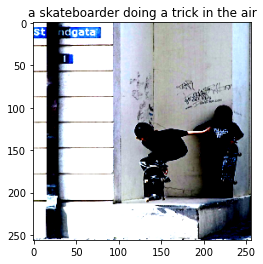

Original ['A', 'boy', 'takes', 'a', 'jump', 'on', 'his', 'skateboard', 'while', 'another', 'boy', 'with', 'a', 'skateboard', 'watches']
['a', 'woman', 'with', 'a', 'paddle', 'in', 'the', 'boat']
['a', 'woman', 'in', 'a', 'bikini', 'is', 'sitting', 'on', 'the', 'shore', 'of', 'a', 'lake']
['a', 'woman', 'with', 'a', 'paddle', 'on', 'the', 'water']
['a', 'woman', 'with', 'a', 'paddle', 'over', 'the', 'river']


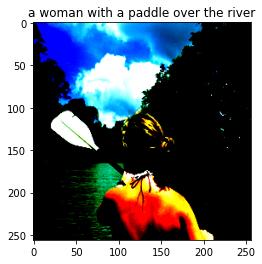

Original ['A', 'girl', 'paddling', 'down', 'a', 'large', 'river', ',', 'as', 'seen', 'from', 'behind', 'her']
['the', 'girl', 'is', 'wearing', 'a', 'pink', 'and', 'white', 'shirt', ',', 'and', 'a', 'striped', 'shirt', ',', 'and', 'a', 'life', 'jacket', 'in', 'a', 'swimming', 'pool']
['a', 'girl', 'in', 'a', 'pink', 'bathing', 'suit', 'jumps', 'into', 'a', 'lake']
['a', 'girl', 'in', 'pigtails', 'plays', 'in', 'the', 'waves']
['a', 'girl', 'in', 'a', 'pink', 'swimsuit', 'is', 'diving', 'into', 'the', 'water']


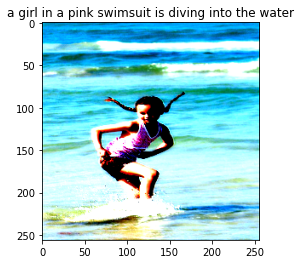

Original ['A', 'girl', 'in', 'pigtails', 'splashes', 'in', 'the', 'shallow', 'water']
['three', 'children', 'sit', 'on', 'a', 'couch', '.']
['three', 'young', 'girls', 'are', 'sitting', 'on', 'a', 'couch', 'laughing']
['a', 'little', 'girl', 'in', 'pajamas', 'is', 'playing', 'with', 'a', 'man', 'in', 'a', 'red', 'shirt']
['a', 'little', 'boy', 'and', 'a', 'little', 'girl', 'are', 'playing']


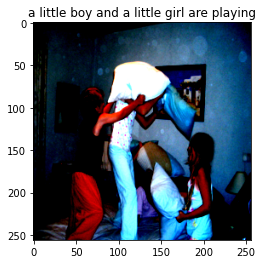

Original ['A', 'group', 'of', 'four', 'children', 'wearing', 'pajamas', 'have', 'a', 'pillow', 'fight']
['two', 'men', 'are', 'standing', 'on', 'a', 'platform', 'on', 'the']
['two', 'men', 'are', 'standing', 'on', 'a', 'platform', 'on', 'a', 'platform']
['two', 'men', 'are', 'standing', 'on', 'a', 'platform', 'in', 'front', 'of', 'a', 'white', 'building']
['two', 'construction', 'workers', 'are', 'playing', 'on', 'a', 'beam']


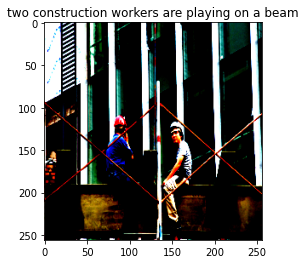

Original ['Two', 'constructions', 'workers', 'sit', 'on', 'a', 'beam', 'taking', 'a', 'break']
['two', 'boys', 'are', 'in', 'a', 'school', 'playing', 'with', 'a', 'ball', '.', '<SOS>']
['two', 'young', 'boys', 'playing', 'in', 'a']
['two', 'boys', 'are', 'playing', 'in', 'the', 'water']
['two', 'boys', 'are', 'playing', 'in', 'a', 'soccer', 'ball']


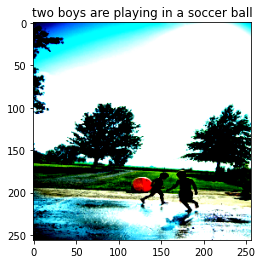

Original ['The', 'children', 'are', 'playing', 'in', 'the', 'water']
['the', 'girl', 'is', 'holding', 'a', 'child', "'s", 'hand', 'while', 'riding', 'her', 'bike']
['a', 'girl', 'in', 'a', 'blue', 'shirt', 'is', 'looking', 'at', 'a', 'woman', 'in', 'a', 'blue', 'dress']
['a', 'woman', 'is', 'taking', 'a', 'photograph', 'of', 'a', 'child', 'at', 'the', 'child', "'s", 'hand']
['a', 'girl', 'with', 'her', 'arm', 'around', 'her', 'arm']


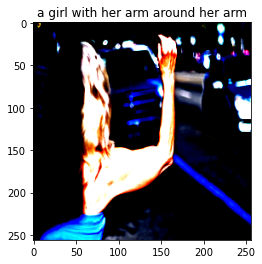

Original ['A', 'blond', 'woman', 'in', 'a', 'blue', 'shirt', 'appears', 'to', 'wait', 'for', 'a', 'ride']
['a', 'little', 'girl', 'in', 'a', 'blue', 'dress', 'is', 'sitting', 'in', 'the', 'back', 'of', 'a', 'wooden', 'structure']
['two', 'toddlers', 'are', 'sitting', 'on', 'a', 'subway', 'train', 'and', 'holding', 'onto', 'the', 'floor']
['a', 'young', 'girl', 'sits', 'on', 'a', 'train', 'and', 'eats', 'a', 'snack']
['two', 'toddlers', 'are', 'sitting', 'on', 'a', 'bench', 'and', 'laughing']


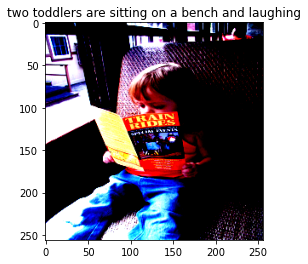

Original ['A', 'little', 'girl', 'looking', 'at', 'a', 'brochure', 'on', 'train']
['three', 'dogs', 'are', 'running', 'through', 'a', 'field']
['two', 'dogs', 'running', 'on', 'the', 'ground']
['two', 'dogs', 'in', 'the', 'grass']
['two', 'brown', 'dogs', 'playing', 'in', 'the', 'snow']


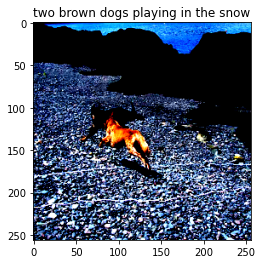

Original ['A', 'brown', 'dog', 'is', 'running', 'after', 'a', 'black', 'dog', 'on', 'a', 'rocky', 'shore']
['a', 'boy', 'is', 'jumping', 'into', 'a', 'pool']
['a', 'boy', 'jumps', 'into', 'a', 'blue', 'pool']
['a', 'boy', 'jumps', 'off', 'a', 'blue', 'diving', 'into', 'a', 'pool']
['a', 'kid', 'jumps', 'into', 'a', 'swimming', 'pool']


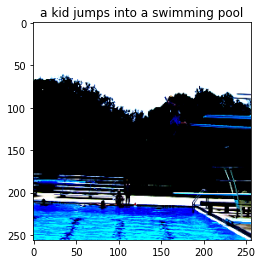

Original ['A', 'boy', 'descends', 'off', 'the', 'end', 'of', 'a', 'high', 'diving', 'board']
['a', 'man', 'wearing', 'a', 'black', 'suit', 'is', 'holding', 'a', 'sword']
['a', 'person', 'in', 'a', 'blue', 'shirt', 'is', 'standing', 'in', 'front', 'of', 'a', 'man', 'who', 'is', 'holding', 'a', 'blue', 'umbrella']
['a', 'man', 'in', 'jeans', 'is', 'standing', 'in', 'front', 'of', 'a', 'glass', 'and', '<UNK>']
['three', 'people', 'are', 'standing', 'outside', 'of', 'a', 'building']


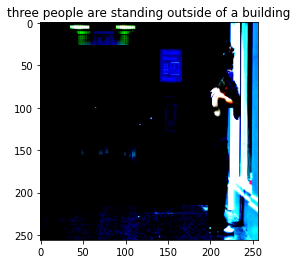

Original ['A', 'guy', 'stands', 'by', 'a', 'window', 'taking', 'his', 'overshirt', 'off']
['a', 'dog', 'runs', 'across', 'the', 'beach', 'while', 'a', 'dog', 'follows']
['white', 'dog', 'running', 'in', 'the', 'snow']
['a', 'white', 'dog', 'is', 'running', 'on', 'the', 'beach']
['two', 'dogs', 'running', 'down', 'a', 'dirt', 'path']


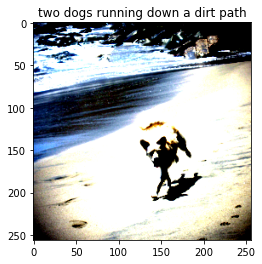

Original ['A', 'light-colored', 'dog', 'runs', 'on', 'the', 'beach']
['a', 'boy', 'wearing', 'a', 'blue', 'shirt', 'and', 'a', 'white', 'shirt', 'is', 'running', 'in', 'the', 'water']
['a', 'boy', 'in', 'shorts', 'and', 'a', 't', '-', 'shirt', 'running', 'on', 'a', 'beach']
['a', 'little', 'boy', 'wearing', 'a', 'blue', 'shirt', 'is', 'standing', 'in', 'the', 'water']
['a', 'boy', 'in', 'a', 'swimsuit', 'is', 'running', 'in', 'a', 'race']


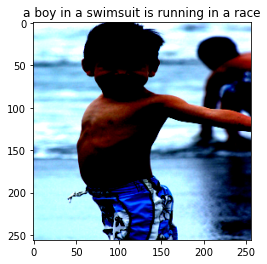

Original ['A', 'boy', 'in', 'his', 'blue', 'swim', 'shorts', 'at', 'the', 'beach']
['a', 'skier', 'is', 'making', 'a', 'high', 'leap', 'over', 'a', 'snowy', 'mound']
['a', 'person', 'skiing', 'down', 'the', 'snowy', 'hill']
['person', 'skiing', 'down', 'a', 'snowy', 'hill']
['a', 'person', 'skiing', 'down', 'a', 'snowy', 'hill']


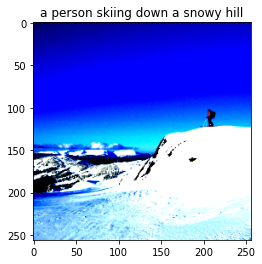

Original ['A', 'hiker', 'standing', 'high', 'on', 'a', 'bluff', 'overlooking', 'the', 'mountains', 'below']
['two', 'dogs', 'are', 'playing', 'with', 'one', 'another', 'on', 'the', 'green', 'grass']
['a', 'black', 'and', 'white', 'dog', 'is', 'playing', 'with', 'a', 'yellow', 'toy', 'in', 'the', 'grass']
['a', 'black', 'dog', 'and', 'white', 'dog', 'with', 'a', 'green', 'toy']
['a', 'dog', 'is', 'jumping', 'with', 'a', 'ball', 'in', 'its', 'mouth']


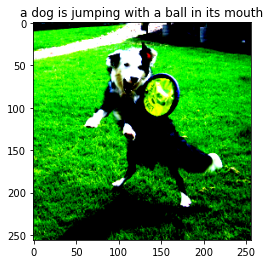

Original ['A', 'black', 'and', 'white', 'dog', 'is', 'attempting', 'to', 'catch', 'a', 'yellow', 'and', 'purple', 'object', 'in', 'a', 'low', 'cut', 'yard']
['a', 'man', 'sits', 'on', 'the', 'street', 'while', 'a', 'woman', 'sits', 'and', 'a', 'man', 'behind', 'him']
['two', 'men', 'sit', 'on', 'a', 'bus']
['two', 'men', 'are', 'sitting', 'on', 'a', 'bus']
['a', 'person', 'sits', 'in', 'a', 'car', 'in', 'front', 'of', 'a', 'car']


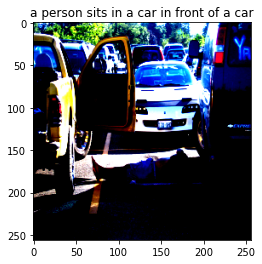

Original ['A', 'man', 'in', 'blue', 'shorts', 'is', 'laying', 'in', 'the', 'street']
['three', 'dogs', 'are', 'running', 'through', 'the', 'sand']
['two', 'dogs', 'are', 'playing', 'together', 'on', 'the', 'beach']
['a', 'black', 'dog', 'with', 'a', 'brown', 'spot', 'on', 'his', 'back', 'running', 'on', 'a']
['the', 'dogs', 'are', 'playing', 'in', 'the', 'snow']


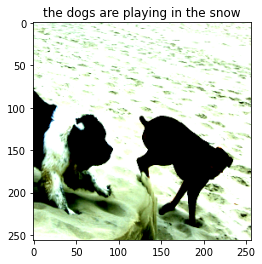

Original ['A', 'white', 'and', 'black', 'dog', 'and', 'a', 'brown', 'dog', 'in', 'sandy', 'terrain']
['a', 'dog', 'catches', 'a', 'ball', 'in', 'the', 'air', 'while', 'another', 'dog']
['the', 'dog', 'is', 'running', 'in', 'the', 'grass']
['a', 'black', 'and', 'white', 'dog', 'is', 'catching', 'a', 'ball', 'in', 'the', 'air']
['a', 'dog', 'catches', 'a', 'ball', 'in', 'its', 'mouth']


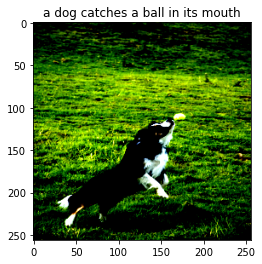

Original ['A', 'black', 'and', 'white', 'dog', 'catches', 'a', 'toy', 'in', 'midair']
['a', 'crowd', 'of', 'people', 'watching', 'a', 'crowd', 'watching']
['a', 'crowd', 'of', 'hot', 'air', 'balloons', 'at', 'night']
['a', 'group', 'of', 'children', 'at', 'an', 'indoor', 'field']
['a', 'crowd', 'of', 'hot', 'air', 'at', 'night']


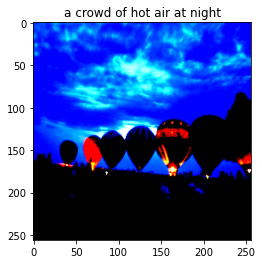

Original ['A', 'crowd', 'watching', 'air', 'balloons', 'at', 'night']
['a', 'boy', 'on', 'his', 'bike', 'is', 'riding', 'a', 'bike', 'through', 'the', 'dirt']
['a', 'boy', 'on', 'a', 'bike', 'is', 'riding', 'a', 'bike', 'on', 'a', 'dirt', 'path']
['the', 'little', 'boy', 'pedals', 'his', 'bike']
['a', 'little', 'boy', 'in', 'a', 'helmet', 'rides', 'a', 'bike']


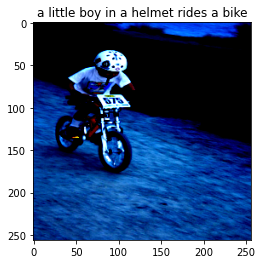

Original ['A', 'child', 'with', 'a', 'helmet', 'on', 'his', 'head', 'rides', 'a', 'bike']
['a', 'group', 'at', 'a', 'man', 'in', 'the', 'city', 'street']
['a', 'group', 'of', 'people', 'are', 'gathered', 'around', 'a', 'table', 'in', 'front', 'of', 'a']
['a', 'crowd', 'of', 'people', 'at', 'night']
['people', 'are', 'gathered', 'at', 'a', 'table', 'in', 'a', 'darkened', 'room', 'at', 'night']


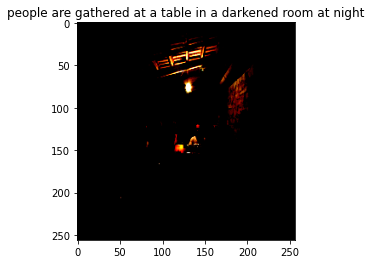

Original ['A', 'group', 'of', 'eight', 'people', 'are', 'gathered', 'around', 'a', 'table', 'at', 'night']
['a', 'man', 'and', 'a', 'woman', 'hopping', 'on', 'the', 'beach', '.']
['a', 'man', 'and', 'a', 'dog', 'are', 'playing', 'on', 'a', 'beach']
['a', 'man', 'and', 'a', 'dog', 'are', 'jumping', 'in', 'the', 'sand']
['a', 'man', 'and', 'a', 'dog', 'are', 'playing', 'on', 'the', 'beach']


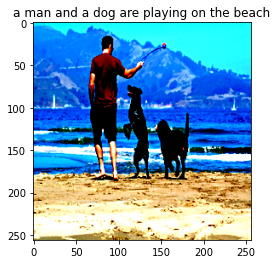

Original ['A', 'man', 'in', 'a', 'brown', 'shirt', 'and', 'dark', 'shorts', 'plays', 'on', 'the', 'beach', 'with', 'his', 'two', 'black', 'dogs']
['the', 'girl', 'is', 'splashing', 'in', 'the', 'water']
['the', 'boy', 'is', 'playing', 'with', 'bubbles', 'and', 'splashing', 'around', 'him']
['a', 'boy', 'covered', 'in', 'water', 'is', 'being', 'squirted', 'with', 'water']
['a', 'boy', 'splashing', 'around', 'in', 'the', 'snow']


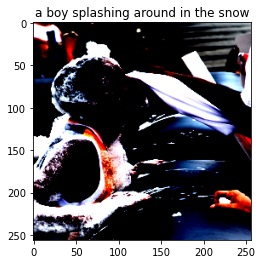

Original ['a', 'boy', 'cleans', 'the', 'bubbles', 'off', 'his', 'face']
['two', 'young', 'girls', 'are', 'diving', 'into', 'blue', 'water']
['the', 'girl', 'in', 'blue', 'is', 'sliding', 'down', 'a', 'slide', 'into', 'a', 'pool', 'while', 'another', 'girl', 'watches']
['a', 'little', 'girl', 'is', 'sliding', 'down', 'a', 'slide', 'into', 'a', 'swimming', 'pool']
['a', 'girl', 'in', 'a', 'swimming', 'pool']


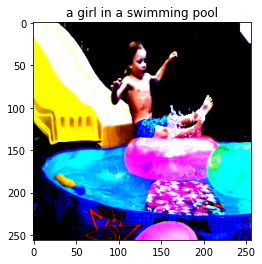

Original ['A', 'boy', 'in', 'blue', 'shorts', 'slides', 'down', 'a', 'slide', 'into', 'a', 'pool']
['two', 'men', 'are', 'jumping', 'in', 'the', 'air', 'in', 'the', 'city']
['two', 'young', 'men', 'are', 'jumping', 'into', 'the', 'air']
['two', 'men', 'jump', 'in', 'the', 'air']
['two', 'men', 'jump', 'into', 'a', 'lake']


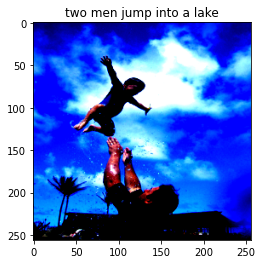

Original ['A', 'man', 'in', 'a', 'wetsuit', 'is', 'throwing', 'a', 'baby', 'wearing', 'a', 'wetsuit', 'up', 'into', 'the', 'air']
['two', 'boys', 'are', 'posing', 'for', 'a', 'photo']
['a', 'little', 'girl', 'and', 'boy', 'smile', 'for', 'the', 'camera']
['two', 'young', 'boys', 'posing', 'for', 'the', 'camera']
['a', 'little', 'boy', 'and', 'a', 'girl', 'smile', 'for', 'the', 'camera']


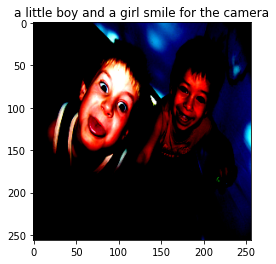

Original ['A', 'little', 'boy', 'sticks', 'his', 'tongue', 'out', 'for', 'the', 'camera', '.', 'Another', 'boy', 'looks', 'on']
['a', 'man', 'and', 'a', 'woman', 'are', 'looking', 'at', 'a', 'fire', '.']
['a', 'man', 'and', 'a', 'girl', 'are', 'looking', 'at', 'something', 'in', 'the', 'air']
['a', 'man', 'with', 'a', 'microphone', 'in', 'his', 'arm', 'is', 'pouring', 'out', 'a', 'fire']
['a', 'man', 'and', 'a', 'dog', 'looking', 'at', 'something', 'while', 'standing', 'on', 'a', 'fire']


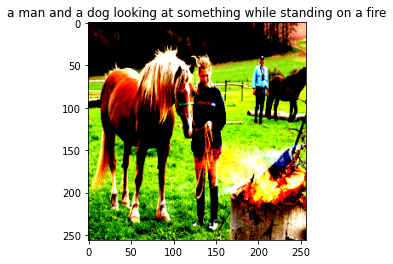

Original ['A', 'blonde', 'horse', 'and', 'a', 'blonde', 'girl', 'in', 'a', 'black', 'sweatshirt', 'are', 'staring', 'at', 'a', 'fire', 'in', 'a', 'barrel']
['a', 'brown', 'dog', 'and', 'a', 'black', 'dog', 'are', 'playing', 'with', 'a', 'brown', 'dog']
['a', 'brown', 'dog', 'and', 'a', 'black', 'dog', 'are', 'playing', 'with', 'a', 'brown', 'dog']
['two', 'dogs', 'look', 'up', 'at', 'the', 'camera']
['a', 'brown', 'dog', 'and', 'a', 'woman', 'looking', 'at', 'a', 'dog']


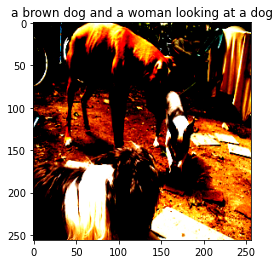

Original ['A', 'bulldog', ',', 'a', 'sheep', 'dog', ',', 'and', 'a', 'boxer', 'standing', 'in', 'a', 'yard']
['a', 'man', 'and', 'a', 'woman', 'are', 'sitting', 'on', 'a', 'dock']
['two', 'boys', 'are', 'posing', 'for', 'a', 'picture', 'in', 'a', 'lake']
['a', 'man', 'and', 'a', 'woman', 'sit', 'on', 'a', 'dock']
['a', 'man', 'and', 'a', 'young', 'girl', 'are', 'sitting', 'on', 'a', 'dock']


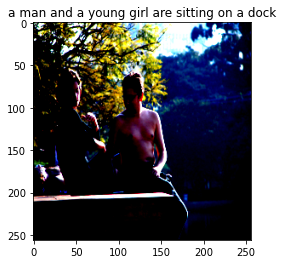

Original ['A', 'lady', 'and', 'a', 'man', 'with', 'no', 'shirt', 'sit', 'on', 'a', 'dock']
['a', 'white', 'dog', 'with', 'a', 'tennis', 'ball', 'on', 'its', 'head']
['a', 'white', 'and', 'brown', 'dog', 'is', 'looking', 'at', 'the', '<UNK>', 'of', 'a', 'dog']
['a', 'white', 'dog', 'with', 'a', 'tennis', 'ball', 'in', 'his', 'mouth']
['a', 'white', 'dog', 'with', 'its', 'tongue', 'sticking', 'straight', 'out']


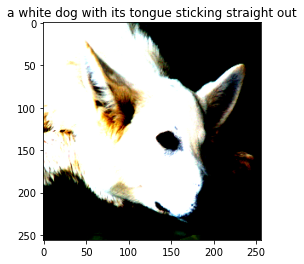

Original ['A', 'closeup', 'of', 'a', 'white', 'dog', 'that', 'is', 'laying', 'its', 'head', 'on', 'its', 'paws']
['two', 'girls', 'jump', 'on', 'a', 'wet', 'trampoline']
['a', 'man', 'in', 'a', 'white', 'shirt', 'and', 'blue', 'shorts', 'is', 'dancing']
['a', 'man', 'in', 'shorts', ',', 'a', 'girl', ',', 'and', 'shorts', ',', 'and', 'a', 'girl', 'are', 'climbing', 'on', 'a', 'rock', 'climbing']
['two', 'girls', 'dance', 'on', 'a', 'stage']


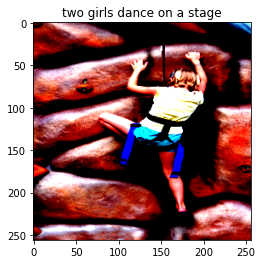

Original ['a', 'woman', 'in', 'a', 'yellow', 'shirt', 'and', 'green', 'shorts', 'is', 'climbing', 'an', 'artificial', 'red', 'wall', 'whilst', 'wearing', 'a', 'safety', 'harness']
['two', 'girls', 'are', 'jumping', 'into', 'water', '.']
['a', 'boy', 'and', 'a', 'girl', 'are', 'playing', 'in', 'an', 'inflatable', 'pool']
['a', 'boy', 'and', 'a', 'girl', 'are', 'playing', 'on', 'a', 'swing']
['a', 'boy', 'and', 'a', 'girl', 'are', 'playing', 'in', 'the', 'water']


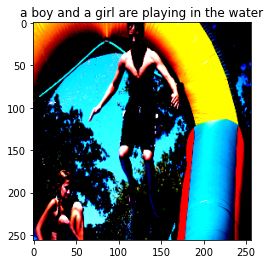

Original ['A', 'boy', 'is', 'jumping', 'on', 'an', 'inflatable', 'ring', 'and', 'a', 'girl', 'is', 'watching']
['three', 'people', 'sit', 'on', 'a', 'park', 'bench']
['three', 'people', 'are', 'sitting', 'on', 'a', 'park', 'bench']
['a', 'group', 'of', 'people', 'sit', 'on', 'a', 'bench', 'overlooking', 'a', 'lake']
['a', 'man', 'and', 'a', 'woman', 'on', 'a', 'park', 'bench']


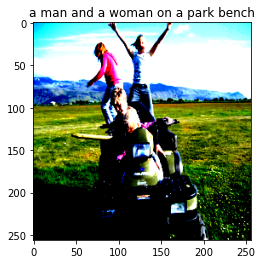

Original ['A', 'family', 'playing', 'on', 'a', 'tractor', 'on', 'a', 'beautiful']
['the', 'woman', 'wearing', 'red', 'and', 'blue', 'pants', 'is', 'walking', 'in', 'the', 'street']
['the', 'woman', 'in', 'the', 'salmon', 'colored', 'bikini', 'is', 'dancing']
['the', 'woman', 'in', 'the', 'salmon', 'colored', 'bikini', 'is', 'walking', 'away', 'from', 'the', 'man', 'in', 'the', 'blue', 'shirt']
['a', 'woman', 'in', 'a', 'red', 'skirt', 'walks', 'down', 'a', 'street']


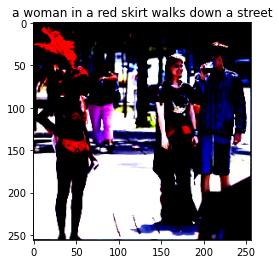

Original ['A', 'woman', 'in', 'a', 'red', 'costume', 'to', 'the', 'left', 'of', 'a', 'man', 'and', 'woman', 'standing', 'together']
['three', 'people', 'in', 'summer', 'clothing', 'are', 'walking', 'through', 'a', 'snow', 'covered', 'tree']
['four', 'people', 'in', 'winter', 'gear', 'are', 'standing', 'in', 'a', 'snowy', 'area']
['a', 'group', 'of', 'people', 'are', 'standing', 'in', 'the', 'snow']
['two', 'women', 'in', 'winter', 'clothes', 'are', 'standing', 'in', 'the', 'snow']


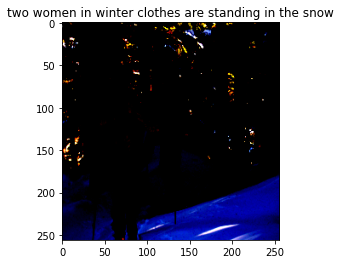

Original ['Skiiers', 'walking', 'up', 'the', 'hill', 'through', 'a', 'forest']
['two', 'people', 'are', 'on', 'a', 'snowy', 'hill', ',', 'with', 'a', 'blue', 'sky', 'behind', 'them']
['a', 'person', 'is', 'skiing', 'down', 'a', 'snowy']
['a', 'person', 'is', 'skiing', 'down', 'a', 'ramp']
['a', 'person', 'skiing', 'down', 'a', 'snowy']


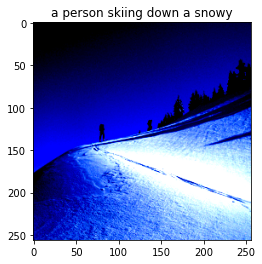

Original ['A', 'lone', 'skier', 'is', 'making', 'their', 'way', 'up', 'a', 'mountain']
['a', 'dog', 'running', 'on', 'the', 'grass']
['a', 'brown', 'dog', 'is', 'running', 'on', 'the', 'grass']
['a', 'brown', 'dog', 'is', 'running', 'towards', 'a', 'camera']
['brown', 'dog', 'with', 'mouth', 'open', 'and', 'running']


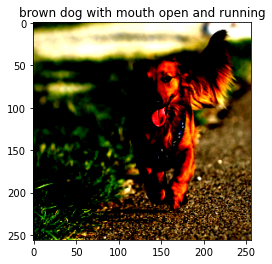

Original ['a', 'brown', 'dog', 'running', 'down', 'a', 'paved']
['a', 'group', 'stands', 'in', 'a', 'gym']
['three', 'people', 'are', 'walking', 'around', 'a', 'boardwalk']
['three', 'people', 'are', 'walking', 'down', 'a', 'city', 'street', 'at', 'an', 'evening']
['three', 'people', 'at', 'a', 'basketball', 'game']


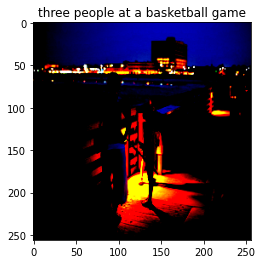

Original ['A', 'mother', 'and', 'children', 'is', 'fishing', 'on', 'a', 'boardwalk', 'at', 'night']
['a', 'woman', 'and', 'a', 'dog', 'stand', 'on', 'the', 'beach', 'near', 'a', 'lake']
['the', 'woman', 'in', 'the', 'blue', 'shirt', 'is', 'walking', 'with', 'a', 'man', 'in', 'the', 'snow']
['a', 'man', 'and', 'a', 'woman', 'wade', 'into', 'the', 'ocean']
['a', 'woman', 'stands', 'on', 'the', 'beach', 'with', 'a', 'dog']


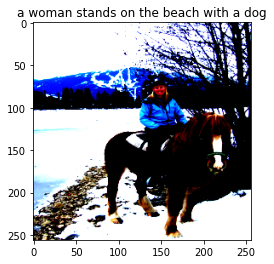

Original ['A', 'woman', 'dressed', 'in', 'a', 'blue', 'jacket', 'and', 'blue', 'jeans', 'rides', 'a', 'brown', 'horse', 'near', 'a', 'frozen', 'lake', 'and', 'snow-covered', 'mountain']
['two', 'women', 'pet', 'a', 'camel', 'in', 'the', 'sand']
['a', 'woman', 'with', 'a', 'brown', 'dog', 'and', 'a', 'man', 'in', 'a', 'brown', 'jacket']
['a', 'woman', 'in', 'a', 'cowboy', 'hat', ',', 'with', 'a', 'brown', 'dog', 'and', 'a', 'brown', 'dog']
['a', 'woman', 'in', 'a', 'cowboy', 'hat', 'holding', 'a', 'small', 'brown', 'dog']


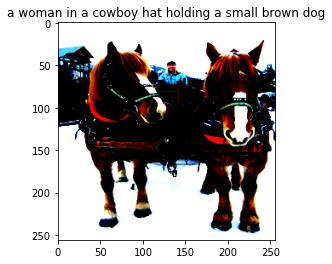

Original ['Two', 'draft', 'horses', 'pull', 'a', 'cart', 'through', 'the', 'snow']
['a', 'person', 'wearing', 'a', 'red', 'hat', 'is', 'climbing', 'a', 'steep', ',', 'white', 'mountain']
['a', 'person', 'in', 'a', 'red', 'jacket', 'climbs', 'a', 'rock']
['two', 'people', 'climbing', 'a', 'cliff']
['a', 'person', 'in', 'a', 'red', 'hat', 'climbs', 'a', 'mountain']


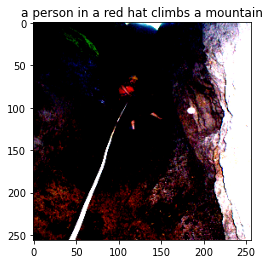

Original ['A', 'person', 'climbing', 'down', 'a', 'sheer', 'rock', 'cliff', 'using', 'a']
['three', 'people', 'sit', 'on', 'a', 'rock', 'in', 'front', 'of', 'a']
['three', 'people', 'are', 'sitting', 'on', 'a', 'rock']
['four', 'people', 'are', 'sitting', 'on', 'a', 'rock', 'wall']
['a', 'group', 'of', 'people', 'sit', 'on', 'a', 'pile', 'of', 'rocks']


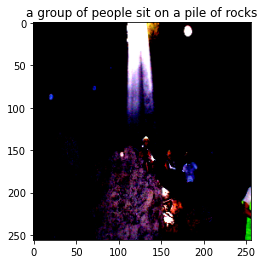

Original ['People', 'stand', 'inside', 'a', 'rock', 'dome']
['a', 'group', '<UNK>', 'in', 'front', 'of', 'a', 'mountain']
['a', 'bunch', 'of', 'people', 'sit', 'on', 'the', 'ground', 'at', 'a', 'rocky', 'beach']
['several', 'people', 'are', 'standing', 'in', 'front', 'of', 'a', 'mountain']
['a', 'group', 'of', 'people', 'sit', 'in', 'the', 'mountains']


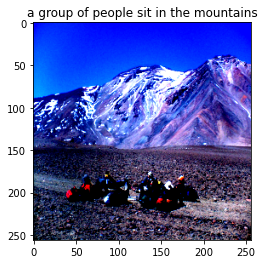

Original ['a', 'group', 'of', 'backpackers', 'lay', 'on', 'the', 'dry', 'ground']
['a', 'family', 'stands', 'in', 'front', 'of', 'a', 'group', 'of', 'children', 'and', 'a', 'boy', 'playing', 'in', 'a', 'house']
['a', 'woman', 'and', 'a', 'boy', 'sit', 'together', 'on', 'the', 'ground', 'in', 'front', 'of', 'a', 'building']
['a', 'family', 'stands', 'in', 'front', 'of', 'a', 'group', 'of', 'people']
['a', 'man', 'and', 'a', 'woman', 'sit', 'on', 'a', 'cement', 'bench', 'and', 'smile']


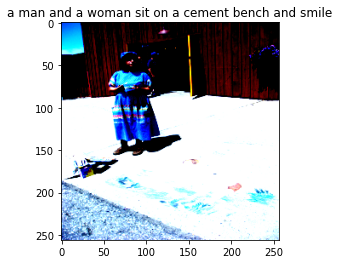

Original ['A', 'woman', 'in', 'a', 'blue', 'dress', 'stands', 'with', 'a', 'chalk', 'portrait', 'of', 'two', 'children', 'playing', 'by', 'a', 'stream']
['a', 'dog', 'runs', 'through', 'the', 'snow']
['a', 'dog', 'runs', 'through', 'the', 'snow']
['a', 'dog', 'running', 'through', 'snow']
['a', 'dog', 'is', 'running', 'in', 'the', 'snow']


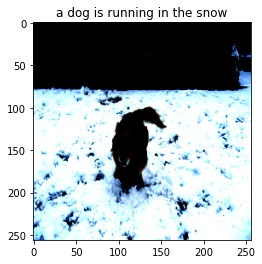

Original ['A', 'brown', 'dog', 'plays', 'in', 'a', 'deep', 'pile', 'of', 'snow']
['two', 'children', 'playing', 'in', 'a', 'water']
['two', 'children', 'playing', 'in', 'water']
['two', 'children', 'playing', 'in', 'a', 'fountain']
['two', 'children', 'play', 'in', 'the', 'fountains']


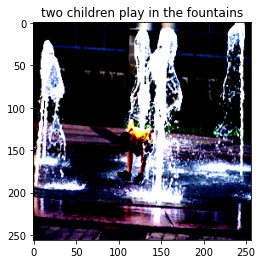

Original ['A', 'boy', 'jumping', 'in', 'a', 'fountain']
['a', 'black', 'and', 'white', 'dog', 'is', 'running', 'through', 'a', 'tunnel', 'on', 'leashes', 'course']
['two', 'dogs', 'are', 'running', 'through', 'a', 'tunnel', 'on', 'a', 'dirt', 'road']
['a', 'black', 'and', 'white', 'dog', 'is', 'running', 'through', 'a', 'tunnel', 'on', 'a', 'course']
['a', 'brown', 'and', 'black', 'dog', 'running', 'through', 'a', 'white', 'tunnel']


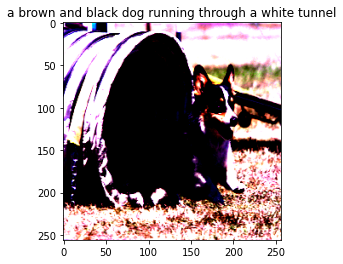

Original ['A', 'Corgi', 'runs', 'out', 'of', 'a', 'tunnel']
['two', 'dogs', 'running', 'around', 'in', 'the', 'woods']
['two', 'dogs', 'running', 'on', 'a', 'dirt', 'path']
['two', 'dogs', 'run', 'around', 'a', 'dirt', 'path']
['three', 'dogs', 'running', 'in', 'the', 'dirt']


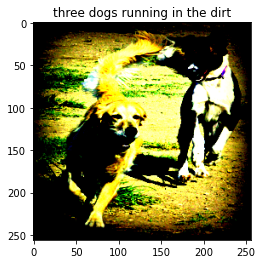

Original ['A', 'blond', 'dog', 'and', 'a', 'black', 'and', 'white', 'dog', 'run', 'in', 'a', 'dirt', 'field']
['a', 'woman', 'in', 'a', 'blue', 'shirt', 'and', 'jeans', 'is', 'walking', 'along', 'a', 'wooden', 'railing']
['a', 'girl', 'in', 'a', 'blue', 'shirt', 'and', 'jeans', 'is', 'walking', 'along', 'a', 'wooden', 'boardwalk', 'on', 'the', 'sandy', 'beach']
['a', 'girl', 'in', 'a', 'blue', 'and', 'white', 'skirt', 'and', 'blue', 'shorts', 'on', 'a', 'skateboard', 'on', 'the', 'beach']
['girl', 'in', 'blue', 'bathing', 'suit', 'on', 'the', 'beach']


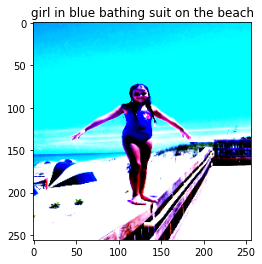

Original ['A', 'little', 'girl', 'in', 'a', 'blue', 'swimsuit', 'is', 'walking', 'along', 'a', 'wooden', 'fence', 'next', 'to', 'a', 'sandy', 'beach']
['two', 'dogs', 'playing', 'with', 'a', 'toy']
['a', 'dog', 'and', 'a', 'cat', 'are', 'playing', 'in', 'the', 'water']
['a', 'black', 'and', 'brown', 'dog', 'is', 'splashing', 'in', 'the', 'water']
['a', 'black', 'and', 'white', 'dog', 'is', 'splashing', 'up', 'in', 'the', 'water']


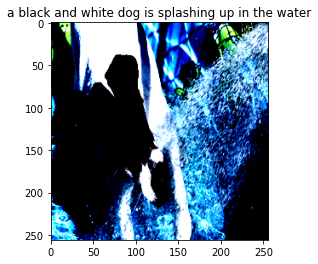

Original ['A', 'black', 'and', 'white', 'dog', 'drinking', 'water', 'from', 'a', 'water', 'spray']
['a', 'young', 'boy', 'is', 'swimming', 'underwater', 'in', 'a', 'pool']
['a', 'boy', 'smiles', 'underwater']
['two', 'children', 'are', 'in', 'a', 'swimming', 'pool']
['a', 'boy', 'is', 'swimming', 'underwater', 'in', 'a', 'swimming', 'pool']


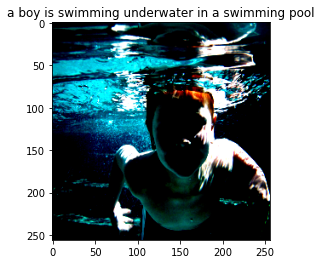

Original ['a', 'boy', 'smiles', 'underwater']
['a', 'young', 'girl', 'is', 'playing', 'a', 'recorder', 'while', 'another', 'girl', 'watches', 'from', 'a', 'tray', 'of', 'water']
['a', 'boy', 'in', 'a', 'red', 't', '-', 'shirt', 'with', 'his', 'eyes', 'closed', 'and', 'a', 'red', 't', '-', 'shirt']
['a', 'boy', 'in', 'a', 'red', 't', '-', 'shirt', 'with', 'his', 'arm', 'around', 'his', 'neck']
['a', 'boy', 'in', 'a', 'red', 't', '-', 'shirt', 'feeds', 'a', '<UNK>']


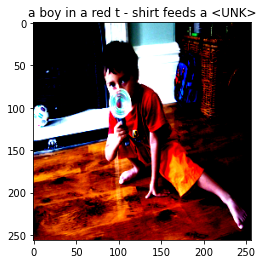

Original ['A', 'boy', 'with', 'a', 'toy', 'gun']
['a', 'boy', 'in', 'a', 'yellow', 'shirt', 'is', 'jumping', 'over', 'a', 'pile', 'of', 'snow']
['a', 'boy', 'stands', 'on', 'a', 'stone', 'wall', 'in', 'the', 'city']
['a', 'boy', 'in', 'a', 'blue', 'jacket', 'is', 'jumping', 'off', 'of', 'rocks', 'into', 'the', 'snow']
['a', 'boy', 'jumps', 'off', 'of', 'a', 'cliff']


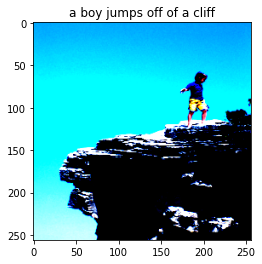

Original ['A', 'boy', 'in', 'yellow', 'shorts', 'is', 'standing', 'on', 'top', 'of', 'a', 'cliff']
['a', 'group', 'of', 'people', 'in', 'a', 'canoe']
['a', 'person', 'in', 'a', 'yellow', 'jacket', 'is', 'riding', 'a', 'mountain', 'bike']
['a', 'group', 'of', 'people', 'sit', 'on', 'a', 'mountain']
['a', 'group', 'of', 'people', 'on', 'a', 'mountain']


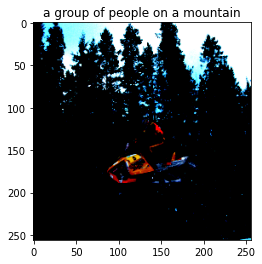

Original ['A', 'person', 'on', 'a', 'snowmobile', 'in', 'mid', 'jump']
['three', 'people', 'in', 'the', 'snow', 'on', 'their', 'motorcycle']
['three', 'men', 'on', 'a', 'motorcycle']
['three', 'people', 'on', 'a', 'ski', 'motorcycle']
['two', 'people', 'are', 'riding', 'a', 'motorcycle']


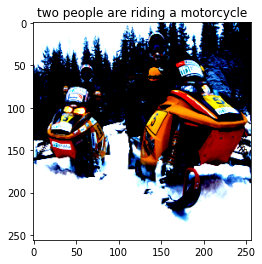

Original ['People', 'are', 'riding', 'around', 'on', 'snowmobiles']
['two', 'people', 'on', 'a', 'motorcycle']
['three', 'people', 'on', 'a', 'motorcycle']
['four', 'people', 'ride', 'their', 'four', 'wheelers']
['four', 'people', 'are', 'riding', 'a', 'four', 'wheeler', 'in', 'the', 'dirt']


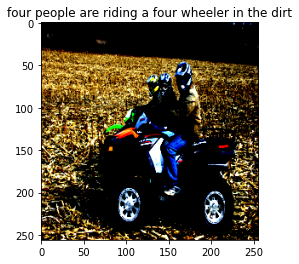

Original ['Three', 'people', 'drive', 'ATVs']
['a', 'four', '-', 'four', 'wheeler', 'jumping', 'through', 'air']
['a', 'four', 'wheeler', 'jumps', 'in', 'the', 'air']
['three', 'people', 'are', 'riding', 'their', 'bikes', 'through', 'a', 'field']
['a', 'four', '-', 'wheeler', 'jumping', 'in', 'the', 'air']


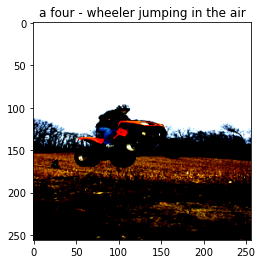

Original ['A', 'four', 'wheeler', 'jumping', 'in', 'an', 'empty', 'field']
['a', 'man', 'is', 'performing', 'a', 'stunt', 'on', 'a', 'bicycle', 'in', 'a', 'field']
['a', 'man', 'is', 'performing', 'a', 'trick', 'in', 'midair', 'while', 'other', 'people', 'watch']
['a', 'man', 'is', 'performing', 'a', 'trick', 'in', 'midair', 'in', 'the', 'air']
['two', 'people', 'ride', 'their', 'bikes', 'down', 'a', 'hill']


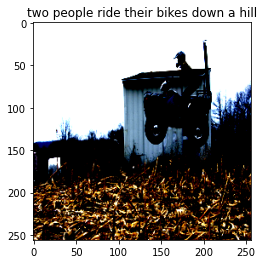

Original ['A', 'man', 'jumps', 'gin', 'the', 'air', 'while', 'riding', 'an']
['a', 'boy', 'jumps', 'in', 'a', 'pile', 'of', 'other', 'while', 'two', 'other', 'children']
['a', 'boy', 'is', 'jumping', 'over', 'a', 'pile', 'in', 'front', 'of', 'other', 'rocks']
['little', 'boy', 'and', 'a', 'little', 'girl', 'are', 'jumping', 'on', 'a', 'trampoline']
['a', 'little', 'boy', 'is', 'jumping', 'in', 'the', 'air', 'in', 'front', 'of', 'a', 'fountain']


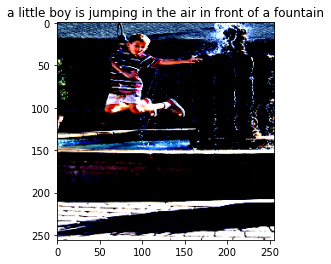

Original ['A', 'boy', 'in', 's', 'striped', 'shirt', 'is', 'jumping', 'in', 'front', 'of', 'a', 'water', 'fountain']
['a', 'boy', 'runs', 'through', 'the', 'grass', 'while', 'a', 'man', 'watches', 'his', 'dog', 'watches']
['a', 'young', 'boy', 'in', 'blue', 'shorts', 'runs', 'through', 'a', 'field']
['a', 'boy', 'runs', 'through', 'the', 'grass']
['a', 'boy', 'runs', 'through', 'the', 'grass']


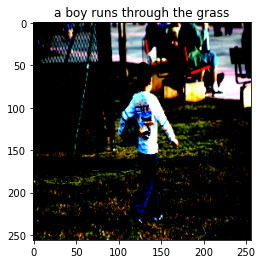

Original ['A', 'boy', 'carrying', 'a', 'soccer', 'ball']
['two', 'young', 'boys', 'are', 'playing', 'with', 'a', 'blue', 'ball']
['a', 'young', 'boy', 'wearing', 'a', 'green', 'shirt', 'and', 'blue', 'shorts', 'is', 'playing', 'with', 'a', 'hose', 'and', 'a', 'man']
['a', 'young', 'boy', 'wearing', 'a', 'blue', 'shirt', 'is', 'playing', 'with', 'a', 'hose']
['a', 'young', 'boy', 'wearing', 'a', 'blue', 'shirt', 'is', 'playing', 'with', 'a', 'hose']


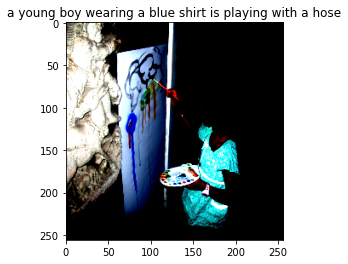

Original ['A', 'child', 'painting', 'a', 'picture']
['two', 'bicyclists', 'ride', 'along', 'a', 'road']
['a', 'man', 'riding', 'a', 'bicycle', 'down', 'a', 'road']
['a', 'bicyclist', 'with', 'a', 'backpack', 'rides', 'his', 'bike']
['two', 'people', 'riding', 'a', 'bike', 'down', 'a', 'street']


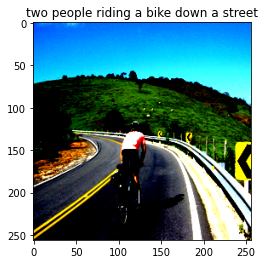

Original ['A', 'cyclist', 'is', 'riding', 'a', 'bicycle', 'on', 'a', 'curved', 'road', 'up', 'a', 'hill']
['a', 'grey', 'dog', 'is', 'chasing', 'a', 'black', 'dog', 'in', 'the', 'grass']
['a', 'black', 'dog', 'and', 'a', 'brown', 'dog', 'playing', 'fetch', 'with', 'a', 'blue', 'ball']
['a', 'dog', 'jumps', 'in', 'the', 'air', 'while', 'another', 'dog', 'watches']
['a', 'black', 'dog', 'playing', 'fetch', 'with', 'a', 'toy']


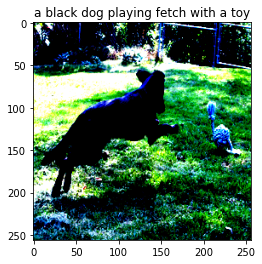

Original ['a', 'black', 'dog', 'jumping', 'to', 'catch', 'a', 'rope']
['a', 'girl', 'in', 'a', 'white', 'shirt', 'and', 'sunglasses', 'is', 'talking', 'on', 'a', 'cellphone']
['a', 'little', 'girl', 'is', 'smiling', 'at', 'the', 'camera', 'while', 'another', 'boy', 'is', 'playing', 'a', 'video', 'game']
['a', 'girl', 'in', 'a', 'white', 'dress', 'holding', 'a', 'microphone']
['a', 'girl', 'with', 'long', 'hair', 'blowing', 'a']


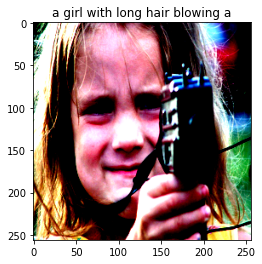

Original ['A', 'little', 'girl', 'is', 'holding', 'a', 'cine', 'camera', 'in', 'front', 'of', 'her', 'face']
['a', 'man', 'is', 'jumping', 'in', 'the', 'grass', 'with', 'a', 'crowd', 'in', 'the', 'background']
['a', 'dog', 'jumps', 'up', 'to', 'catch', 'a', 'frisbee']
['a', 'dog', 'jumps', 'to', 'catch', 'a', 'red', 'frisbee']
['the', 'black', 'dog', 'jumps', 'up', 'to', 'catch', 'the', 'ball']


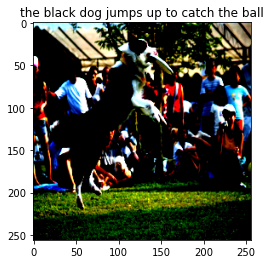

Original ['A', 'black', 'and', 'white', 'Border', 'Collie', 'catches', 'a', 'Frisbee', 'in', 'front', 'of', 'an', 'audience']
['a', 'baby', 'crawls', 'on', 'rocks']
['a', 'small', 'child', 'sits', 'on', 'a', 'pile', 'of', 'rocks']
['a', 'baby', 'sits', 'on', 'a', 'pile', 'of', 'jagged', 'rocks']
['a', 'little', 'boy', 'is', 'playing', 'with', 'a', 'pile', 'of', 'rocks', 'on', 'a', 'beach']


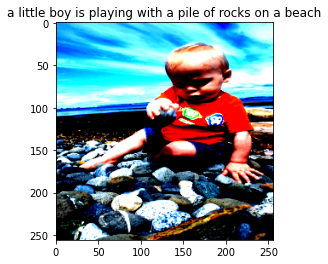

Original ['A', 'baby', 'is', 'sitting', 'on', 'and', 'playing', 'with', 'smooth', 'rocks']
['a', 'man', 'in', 'a', 'harness', 'climbs', 'up', 'rocks', 'and', 'a', 'woman', 'in', 'a', 'green', 'shirt', 'is', 'sitting', 'on', 'top', 'of', 'her']
['a', 'person', 'in', 'a', 'white', 'shirt', 'and', 'jeans', 'is', 'rock', 'climbing']
['the', 'girl', 'is', 'climbing', 'up', 'the', 'side', 'of', 'a', 'hill']
['a', 'boy', 'in', 'a', 'red', 'shirt', 'is', 'rock', 'climbing']


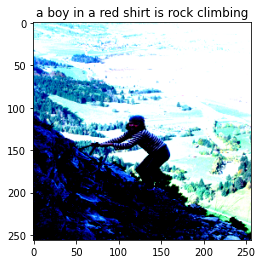

Original ['A', 'kid', 'rock', 'climbing', 'against', 'the', 'backdrop', 'of', 'a', 'green']
['two', 'men', 'climbing', 'a', 'rock']
['man', 'with', 'no', 'shirt', 'on', 'a', 'rock']
['two', 'men', 'are', 'rock', 'climbing']
['two', 'men', 'are', 'rock', 'climbing']


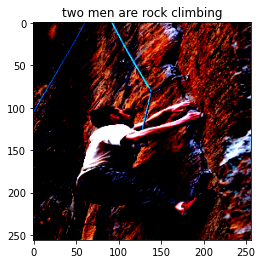

Original ['A', 'man', 'climbing', 'a', 'rock']
['the', 'man', 'is', 'wearing', 'a', 'blue', 'helmet', ',', 'and', 'a', 'helmet', '.']
['a', 'woman', 'in', 'a', 'blue', 'helmet', 'is', 'riding', 'a', 'bike', 'down', 'the', 'street']
['a', 'man', 'wearing', 'a', 'helmet', 'is', 'riding', 'a', 'red', 'bicycle']
['a', 'man', 'wearing', 'a', 'blue', 'helmet', 'is', 'climbing', 'a', 'mountain']


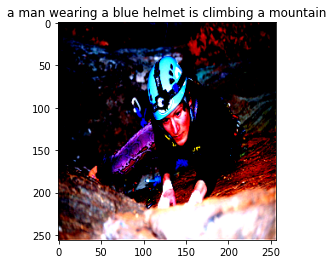

Original ['A', 'climber', 'wearing', 'a', 'blue', 'helmet', 'and', 'headlamp', 'is', 'attached', 'to', 'a', 'rope', 'on', 'the', 'rock', 'face']
['two', 'people', ',', 'one', 'with', 'a', 'black', 'dog', 'with', 'a', 'brown', 'and', 'white', 'dog', '.']
['a', 'woman', 'with', 'black', 'hair', 'and', 'a', 'brown', 'dog', 'with', 'a', 'red', 'collar']
['a', 'man', 'and', 'a', 'woman', 'are', 'looking', 'into', 'the', 'water']
['two', 'people', 'walking', 'on', 'the', 'street']


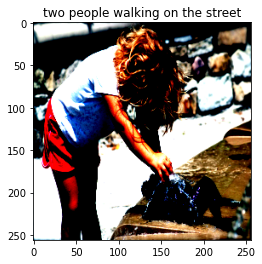

Original ['A', 'child', 'playing', 'with', 'a', 'fountain', 'at', 'the', 'beach']
['a', 'dog', 'is', 'running', 'along', 'the', 'beach']
['a', 'man', 'in', 'a', 'black', 'shirt', 'is', 'walking', 'on', 'the', 'beach']
['a', 'dog', 'is', 'running', 'towards', 'the', 'ocean']
['a', 'group', 'of', 'people', 'on', 'a', 'beach']


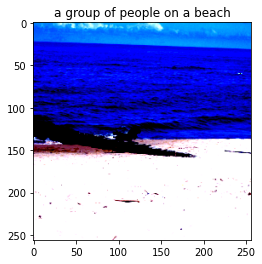

Original ['A', 'black', 'dog', 'is', 'jumping', 'over', 'a', 'log', 'along', 'a', 'beach']
['a', 'black', 'and', 'white', 'bird', 'with', 'his', 'hands', 'up', 'in', 'the', 'air']
['a', 'man', 'is', 'holding', 'a', 'bird', 'in', 'his', 'hand', 'while', 'sitting', 'on', 'the', 'sand']
['a', 'man', 'in', 'a', 'black', 'and', 'white', 'shirt', 'is', 'holding', 'a', 'bird']
['a', 'black', 'and', 'brown', 'dog', 'jumps', 'up', 'to', 'catch', 'a', 'toy']


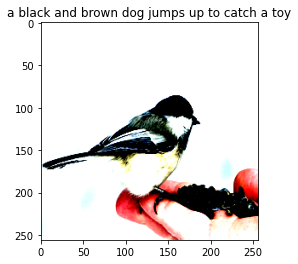

Original ['A', 'black', 'and', 'white', 'bird', 'eating', 'seeds', 'out', 'of', 'someone', "'s"]
['two', 'brown', 'dogs', 'are', 'playing', 'in', 'the', 'sand']
['a', 'brown', 'dog', 'plays', 'with', 'a', 'smaller', 'dog']
['a', 'brown', 'dog', 'and', 'a', 'brown', 'dog', 'playing', 'in', 'the', 'sand']
['a', 'brown', 'dog', 'is', 'digging', 'in', 'the', 'sand']


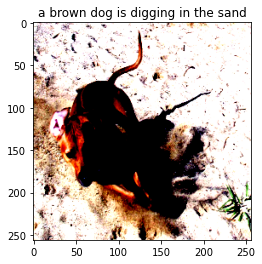

Original ['A', 'brown', 'dog', 'is', 'running', 'in', 'the', 'sand']
['girl', 'in', 'swimming', 'trunks', 'and', 'blue', 'shorts', 'is', 'in', 'the', 'ocean']
['a', 'little', 'boy', 'is', 'splashing', 'in', 'the', 'ocean']
['a', 'little', 'boy', 'is', 'splashing', 'in', 'the', 'ocean']
['a', 'little', 'boy', 'is', 'splashing', 'in', 'the', 'ocean']


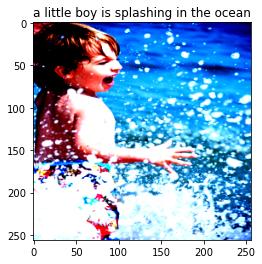

Original ['A', 'little', 'boy', 'stands', 'in', 'the', 'surf']
['a', 'little', 'dog', 'is', 'about', '<UNK>', 'to', 'catch', 'a', 'ball']
['a', 'dog', 'is', 'chasing', 'a', 'ball', 'through', 'the', 'grass']
['a', 'little', 'brown', 'dog', 'is', 'running', 'through', 'the', 'grass']
['a', 'small', 'brown', 'dog', 'is', 'running', 'through', 'the', 'grass']


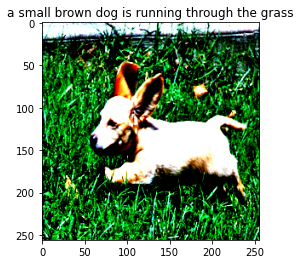

Original ['A', 'little', 'tan', 'dog', 'with', 'large', 'ears', 'running', 'through', 'the', 'grass']
['a', 'black', 'and', 'white', 'dog', 'is', 'running', 'through', 'a', 'field']
['a', 'black', 'and', 'white', 'dog', 'is', 'running', 'through', 'a', 'field']
['a', 'black', 'and', 'white', 'dog', 'is', 'running', 'in', 'a', 'field']
['a', 'black', 'and', 'white', 'dog', 'is', 'running', 'in', 'a', 'grassy', 'field']


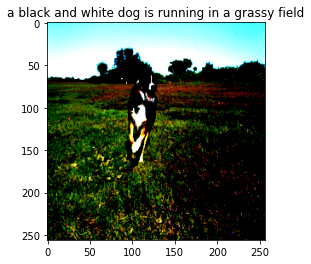

Original ['A', 'black', 'and', 'white', 'dog', 'is', 'running', 'through', 'the', 'field']
['a', 'little', 'girl', 'in', 'a', 'swimming', 'pool', 'and', 'a', 'boy', 'in', 'swimming']
['a', 'little', 'girl', 'in', 'pink', 'is', 'swimming', 'in', 'a', 'pool', 'of', 'water']
['a', 'little', 'girl', 'swimming', 'in', 'a', 'lake']
['a', 'girl', 'swimming', 'in', 'a', 'pool']


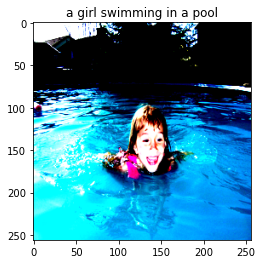

Original ['A', 'girl', 'in', 'a', 'pink', 'swimsuit', 'in', 'a']
['a', 'girl', 'jumps', 'into', 'a', 'pool']
['the', 'girl', 'is', 'jumping', 'on', 'a', 'couch']
['a', 'girl', 'in', 'a', 'bathing', 'suit', 'jumps', 'on', 'a', 'couch']
['a', 'little', 'girl', 'jumps', 'off', 'a', 'rock', 'into', 'a', 'pool']


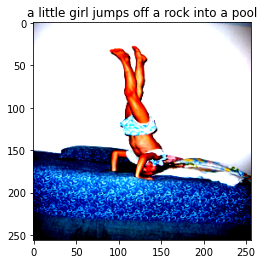

Original ['A', 'child', 'is', 'standing', 'on', 'her', 'head']
['man', 'and', 'a', 'woman', 'in', 'a', 'white', 'shirt', 'and', 'brown', 'shorts', ',', 'with', 'a', 'black', 'dog', 'in', 'the']
['a', 'man', 'and', 'a', 'dog', 'running', 'in', 'the', 'sand']
['a', 'boy', 'in', 'a', 'white', 'shirt', 'is', 'running', 'in', 'the', 'sand']
['man', 'in', 'a', 'white', 'shirt', 'and', 'a', 'boy', 'in', 'the']


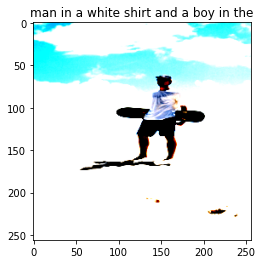

Original ['A', 'guy', 'stands', 'in', 'the', 'sand', 'with', 'a', 'snowboard', 'behind', 'him']
['three', 'people', 'are', 'riding', 'a', 'dirt', 'bike', 'through', 'the', 'woods']
['three', 'people', 'are', 'riding', 'a', 'dirt', 'bike', 'through', 'a', 'wooded', 'area']
['three', 'people', 'are', 'walking', 'down', 'a', 'dirt', 'road']
['three', 'children', 'are', 'playing', 'soccer', 'on', 'a', 'dirt', 'path']


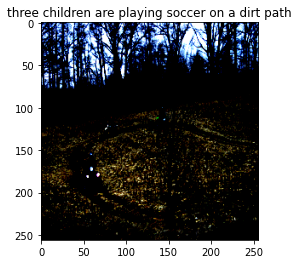

Original ['People', 'on', 'ATVs', 'and', 'dirt', 'bikes', 'are', 'traveling', 'along', 'a', 'worn', 'path', 'in', 'a', 'field', 'surrounded', 'by', 'trees']
['a', 'little', 'boy', 'in', 'a', 'grey', 'jacket', 'holds', 'a', 'flag']
['a', 'boy', 'in', 'a', 'white', 'shirt', 'holds', 'a', 'flag']
['a', 'boy', 'in', 'a', 'white', 'shirt', 'holds', 'a', 'flag']
['a', 'baby', 'in', 'a', 'white', 'shirt', 'is', 'holding', 'a', 'flag']


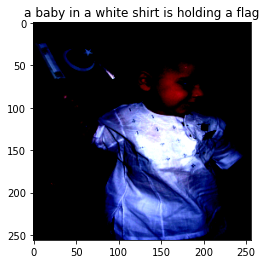

Original ['A', 'baby', 'in', 'a', 'white', 'garment', 'holds', 'a', 'flag', 'with', 'crescent', 'moon', 'and', 'star']
['a', 'man', 'in', 'blue', 'shorts', 'is', 'sitting', 'on', 'his', 'bike', 'in', 'the', 'street']
['a', 'man', 'and', 'a', 'dog', 'sit', 'on', 'the', 'ground', 'under', 'a', 'tree']
['the', 'man', 'is', 'helping', 'a', 'girl', 'on', 'a', 'swing']
['a', 'boy', 'in', 'a', 'blue', 'cap', 'is', 'riding', 'a', 'bike', 'outdoors']


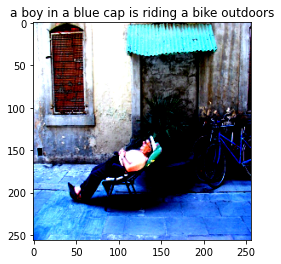

Original ['A', 'half', 'naked', 'man', 'is', 'sleeping', 'on', 'his', 'chair', 'outdoors']
['two', 'dogs', 'are', 'running', 'through', 'the', 'ocean']
['a', 'group', 'of', 'dogs', 'playing', 'in', 'a', 'lake']
['two', 'dogs', 'run', 'through', 'the', 'water', 'with', 'an', 'orange', 'ball', 'in', 'their', 'mouths']
['two', 'dogs', 'run', 'through', 'the', 'water']


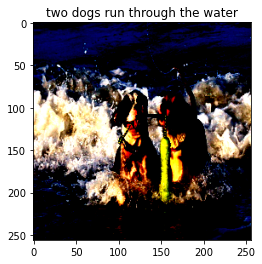

Original ['A', 'brown', 'and', 'white', 'and', 'a', 'black', 'and', 'white', 'dog', 'hauling', 'in', 'a', 'floating', 'toy', 'from', 'the', 'ocean']
['three', 'young', 'boys', 'posing', 'for', 'a', 'picture', 'in', 'a', 'city', 'street']
['three', 'young', 'girls', 'are', 'posing', 'for', 'one', 'another']
['a', 'group', 'of', 'teenagers', 'are', 'posing', 'for', 'a', 'picture']
['three', 'women', 'are', 'posing', 'together', 'in', 'front', 'of', 'a', 'brick', 'building']


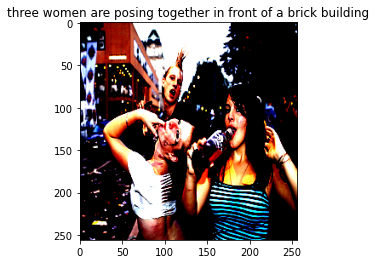

Original ['There', 'are', 'three', 'young', 'people', ',', 'one', 'dark', 'haired', 'holding', 'a', 'bottled', 'drink', ',', 'one', 'with', 'head', 'tilted', 'back', 'and', 'finger', 'in', 'her', 'mouth', ',', 'and', 'one', 'with', 'spiked', 'hair']
['a', 'brown', 'dog', 'is', 'running', 'through', 'the', 'woods']
['a', 'brown', 'dog', 'is', 'running', 'through', 'the', 'water', 'with', 'a', 'ball', 'in', 'its']
['a', 'brown', 'dog', 'is', 'running', 'through', 'the', 'water', 'carrying', 'a', 'ball']
['a', 'golden', 'retriever', 'splashes', 'in', 'the', 'water']


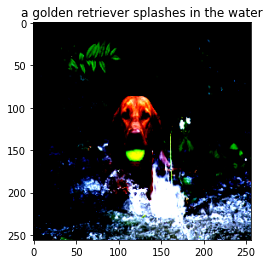

Original ['A', 'brown', 'dog', 'is', 'running', 'through', 'neck-deep', 'water', 'carrying', 'a', 'tennis', 'ball']
['two', 'brown', 'and', 'dogs', 'run', 'through', 'a', 'shallow', 'stream']
['three', 'brown', 'dogs', 'are', 'running', 'through', 'a', 'river', 'while', 'one', 'of', 'the', 'other', 'is', 'wearing', 'a', 'green', 'vest']
['two', 'brown', 'dogs', 'are', 'playing', 'in', 'the', 'water']
['three', 'brown', 'dogs', 'run', 'in', 'the', 'water']


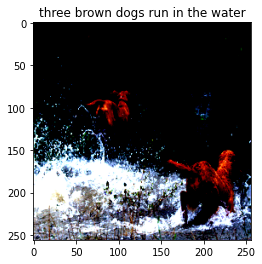

Original ['Two', 'brown', 'dogs', 'are', 'creating', 'large', 'splashes', 'as', 'they', 'run', 'in', 'a', 'river']
['two', 'dogs', 'running', 'on', 'the', 'beach', '.']
['two', 'dogs', 'running', 'in', 'the', 'sand', 'on', 'a', 'beach']
['two', 'dogs', 'running', 'along', 'a', 'beach']
['two', 'dogs', 'running', 'in', 'the', 'sand', 'at', 'the', 'beach']


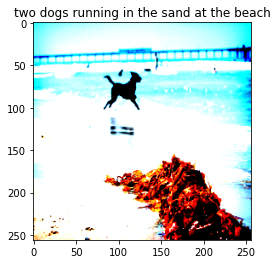

Original ['A', 'black', 'dog', 'runs', 'into', 'the', 'ocean', 'next', 'to', 'a', 'pile', 'of', 'seaweed']
['a', 'boy', 'in', 'a', 'striped', 'shirt', 'runs', 'down', 'the', 'street']
['a', 'boy', 'wearing', 'a', 'striped', 'shirt', 'is', 'standing', 'on', 'a', 'brick', 'wall']
['a', 'young', 'boy', 'runs', 'along', 'a', 'boardwalk']
['a', 'young', 'boy', 'runs', 'along', 'a', 'cobblestone', 'street']


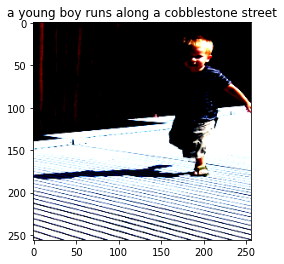

Original ['A', 'young', 'boy', 'runs', 'while', 'wearing', 'sandals']
['the', 'brown', 'dog', 'with', 'a', 'collar', 'is', 'running', 'in', 'water']
['a', 'brown', 'and', 'white', 'dog', 'with', 'a', 'stick', 'in', 'his', 'water']
['a', 'wet', 'dog', 'with', 'its', 'mouth', 'wide', 'open', ',', 'running', 'through', 'the', 'water']
['a', 'dog', 'drinks', 'water']


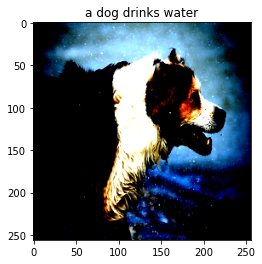

Original ['A', 'brown', 'and', 'white', 'dog', 'stands', 'outside', 'while', 'it', 'snows']
['two', 'women', 'sit', 'on', 'a', 'bench', 'in', 'front', 'of', 'a', 'building']
['three', 'people', 'are', 'sitting', 'on', 'a', 'bench', 'beside', 'a', 'city']
['two', 'people', 'are', 'sitting', 'on', 'a', 'bench', 'outside']
['two', 'men', 'sit', 'on', 'a', 'bench']


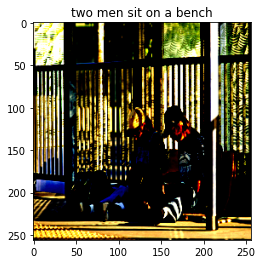

Original ['Two', 'men', 'are', 'sitting', 'on', 'the', 'ground', 'and', 'going', 'through', 'their', 'backpacks']
['two', 'boys', 'in', 'blue', 'shirts', 'and', 'a', 'blue', 'shirt', 'are', 'jumping', 'in', 'the', 'air', 'on', 'a', 'bed', '.', '.', '.']
['a', 'boy', 'jumps', 'on', 'a', 'bed']
['a', 'boy', 'jumps', 'on', 'a', 'bed']
['a', 'boy', 'in', 'a', 'blue', 'top', 'jumping', 'on', 'a', 'bed']


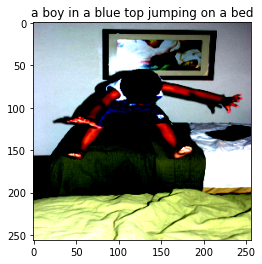

Original ['A', 'boy', 'is', 'jumping', 'on', 'a', 'bed']
['two', 'children', 'in', '<UNK>', 'clothes', 'are', 'walking', 'in', 'a', 'room']
['a', 'family', 'sits', 'in', 'a', 'dark', 'green', 'room', 'with', 'arms', 'around', 'each', 'other']
['a', 'boy', 'in', 'a', 'yellow', 'shirt', 'and', 'a', 'boy', 'in', 'a', 'white', 't', '-', 'shirt', 'are', 'standing', 'on', 'a', 'couch']
['a', 'family', 'stands', 'in', 'the', 'middle', 'of', 'a', 'house']


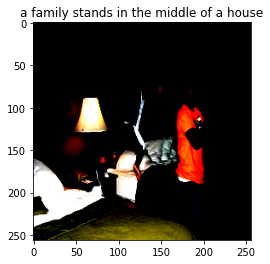

Original ['A', 'child', 'leaping', 'from', 'bed', 'to', 'bed', 'behind', 'the', 'back', 'of', 'a', 'man']
['a', 'boy', 'and', 'a', 'boy', 'are', 'riding', 'a', 'blue', 'sled', 'in', 'a', 'race']
['a', 'boy', 'and', 'a', 'girl', 'are', 'on', 'a', 'boogie', 'board', 'in', 'the', 'snow']
['a', 'boy', 'in', 'a', 'blue', 'wetsuit', 'is', 'riding', 'a', 'girl', 'in', 'a', 'blue', 'jacket']
['two', 'young', 'people', 'sit', 'on', 'the', 'side', 'of', 'a', 'boat']


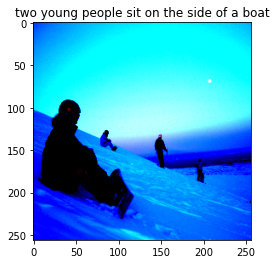

Original ['A', 'snowboarder', 'sits', 'on', 'a', 'slope', 'with', 'skiers', 'and', 'boarders', 'nearby']
['a', 'boy', 'and', 'two', 'young', 'girls', 'are', 'outside', 'a', 'brick', 'building', ',', 'and', 'some', 'adults', 'are', 'looking', 'at', 'them']
['two', 'young', 'men', 'are', 'standing', 'in', 'front', 'of', 'a', 'building', 'in', 'the', 'street']
['two', 'young', 'boys', 'standing', 'in', 'front', 'of', 'a', 'large', 'building']
['a', 'boy', 'and', 'a', 'girl', 'are', 'walking', 'down', 'a', 'city', 'street']


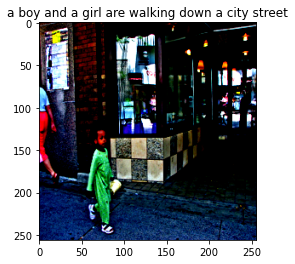

Original ['A', 'girl', 'in', 'green', 'walks', 'down', 'a', 'city', 'street']
['two', 'young', 'children', 'are', 'looking', 'at', 'something', 'while', 'one', 'is', 'taking', 'a', 'picture']
['a', 'boy', 'in', 'a', 'red', 'shirt', 'is', 'holding', 'a', 'sword']
['a', 'young', 'boy', 'in', 'a', 'purple', 'shirt', 'and', 'a', 'girl', 'in', 'a', 'red', 'and', 'black', 'shirt', 'sitting', 'on', 'a', 'man', "'s", 'back']
['two', 'young', 'boys', 'are', 'sitting', 'on', 'a', 'blue', 'bench', 'in', 'the', 'snow']


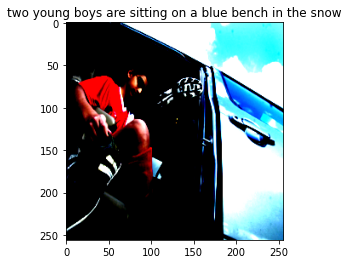

Original ['A', 'boy', 'dressed', 'in', 'soccer', 'attire', 'and', 'holding', 'his', 'shoes', 'getting', 'out', 'of', 'a', 'car']
['a', 'boy', 'is', 'jumping', 'off', 'of', 'a', 'swing']
['a', 'boy', 'and', 'a', 'woman', 'on', 'a', 'swing']
['a', 'group', 'of', 'people', 'are', 'standing', 'on', 'the', 'street', 'in', 'front', 'of', 'a', 'building']
['a', 'boy', 'and', 'a', 'woman', 'are', 'crossing', 'a', 'swing', 'in', 'a', 'tropical', 'tropical']


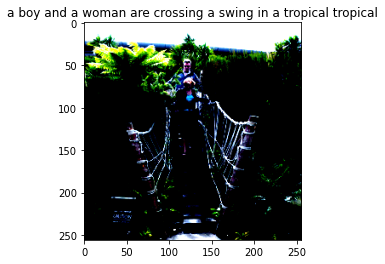

Original ['A', 'bridge', 'through', 'high', 'green', 'plants', ',', 'a', 'man', 'and', 'a', 'woman', 'on', 'it']
['a', 'group', 'of', 'people', 'sit', 'outside', 'of', 'a', 'mural']
['a', 'family', 'is', 'standing', 'in', 'front', 'of', 'an', 'audience', 'in', 'front', 'of', 'a', 'colorful', 'truck']
['a', 'group', 'of', 'people', 'sit', 'on', 'a', 'colorful', 'truck']
['a', 'family', 'is', 'standing', 'in', 'front', 'of', 'a', 'colorful', 'painted', 'van']


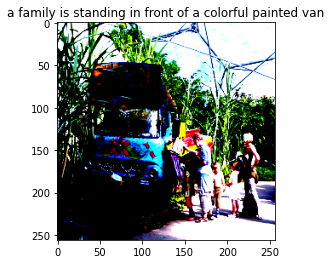

Original ['A', 'family', 'gathered', 'at', 'a', 'painted']
['a', 'woman', 'in', 'a', 'red', 'and', 'white', 'shirt', 'and', 'a', 'girl', 'in', 'a', 'pink', 'shirt', 'with', 'her', 'arms', 'around', 'her']
['a', 'girl', 'in', 'a', 'pink', 'shirt', 'and', 'a', 'girl', 'in', 'pink', 'and', 'white']
['a', 'group', 'of', 'women', 'are', 'posing', 'for', 'the', 'camera']
['a', 'group', 'of', 'girls', 'smile', 'for', 'a']


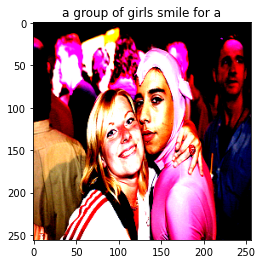

Original ['A', 'blond', 'woman', 'poses', 'with', 'a', 'person', 'in', 'a', 'pink', 'costume']
['a', 'woman', 'wearing', 'black', 'and', 'white', 'and', 'black', 'helmet', 'rides', 'a', 'bicycle', 'on', 'a', 'city']
['a', 'woman', 'in', 'a', 'blue', 'helmet', 'rides', 'a', 'bike', 'on', 'a', 'street']
['a', 'woman', 'in', 'a', 'blue', 'helmet', 'is', 'riding', 'a', 'bicycle']
['a', 'woman', 'in', 'a', 'blue', 'helmet', 'riding', 'a', 'bicycle']


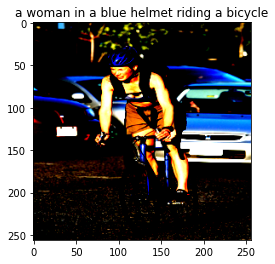

Original ['A', 'bicyclist', 'riding', 'on', 'a', 'city', 'street']
['a', 'cyclist', 'is', 'performing', 'while', 'riding', 'a', 'bicycle']
['a', 'man', 'in', 'a', 'blue', 'and', 'white', 'uniform', 'is', 'riding', 'a', 'bicycle']
['a', 'man', 'is', 'riding', 'a', 'bicycle', 'on', 'a', 'street']
['a', 'bicyclist', 'is', 'riding', 'a', 'bicycle', 'on', 'a', 'city', 'street']


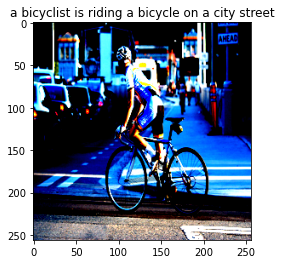

Original ['A', 'bicycle', 'rider', 'is', 'crossing', 'a', 'street']
['a', 'woman', 'with', 'blue', 'helmet', 'rides', 'a', 'bike', 'while', 'riding', 'a', 'bike']
['a', 'girl', 'in', 'a', 'blue', 'helmet', 'is', 'riding', 'her', 'bike', 'in', 'the', 'city', 'street']
['a', 'woman', 'in', 'a', 'helmet', 'is', 'riding', 'a', 'bike', 'in', 'traffic']
['a', 'woman', 'with', 'a', 'helmet', 'riding', 'a', 'bike']


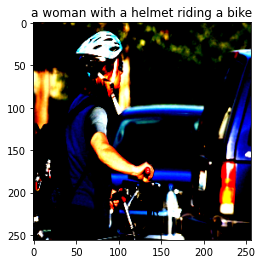

Original ['A', 'lady', 'wearing', 'a', 'helmet', 'holding', 'a', 'bike']
['the', 'woman', 'in', 'the', 'white', 'top', 'and', 'blue', 'jeans', 'is', 'wearing', 'headphones', 'in', 'a', 'white', 'shirt', 'with', 'a', 'red', 'and', 'white', 'hat', 'and', 'black', 'pants']
['a', 'girl', 'in', 'a', 'blue', 'top', 'and', 'a', 'blue', 'shirt', 'is', 'holding', 'a', 'sword']
['the', 'girl', 'is', 'wearing', 'a', 'white', 'shirt', 'and', 'holding', 'a', 'sword']
['a', 'woman', 'in', 'a', 'blue', 'and', 'white', 'shirt', 'and', 'blue', 'shorts', 'is', 'holding', 'a', 'sword']


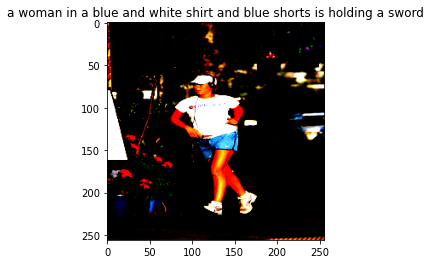

Original ['A', 'man', 'in', 'shorts', 'is', 'jogging', 'along', 'a', 'street', 'with', 'a', 'headset']
['two', 'people', 'are', 'riding', 'bicycles', 'on', 'a', 'street']
['a', 'group', 'of', 'people', 'are', 'walking', 'down', 'the', 'road']
['a', 'group', 'of', 'people', 'on', 'a', 'street']
['a', 'group', 'of', 'people', 'sit', 'on', 'a', 'bench']


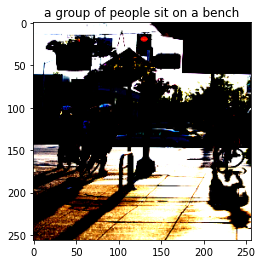

Original ['Bicyclists', 'are', 'standing', 'at', 'an', 'intersection']
['two', 'people', 'are', 'riding', 'on', 'a', 'busy', 'street']
['a', 'man', 'and', 'a', 'girl', 'are', 'sitting', 'on', 'benches', 'in', 'a', 'park', 'bench']
['two', 'women', 'and', 'a', 'man', 'sitting', 'on', 'a', 'bench']
['two', 'men', 'are', 'posing', 'for', 'the', 'camera', 'while', 'riding', 'a', 'bike']


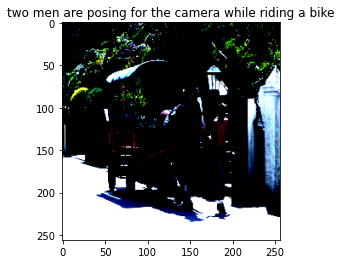

Original ['A', 'man', 'without', 'a', 'shirt', 'on', 'is', 'guiding', 'a', 'large', 'brown', 'horse', 'pulling', 'a', 'green', 'and', 'yellow', 'wagon']
['a', 'group', 'of', 'people', 'are', 'playing', 'volleyball', 'on', 'a', 'sand', 'near', 'a', 'beach']
['a', 'group', 'of', 'young', 'boys', 'play', 'in', 'a', 'gym']
['a', 'man', 'and', 'a', 'boy', 'are', 'playing', 'with', 'a', 'ball', 'in', 'a', 'field']
['a', 'man', 'in', 'a', 'white', 'shirt', 'and', 'blue', 'jeans', 'is', 'playing', 'with', 'a', 'volleyball', 'net']


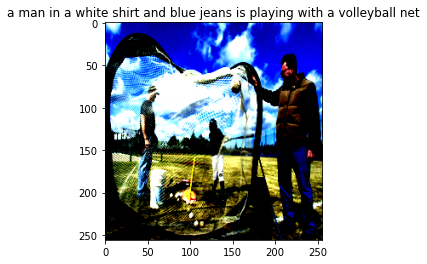

Original ['A', 'boy', 'hits', 'a', 'ball', 'off', 'of', 'a', 'tee', 'ball', 'into', 'to', 'net']
['a', 'little', 'girl', 'runs', 'through', 'the', 'water']
['a', 'little', 'girl', 'in', 'a', 'blue', 'bathing', 'suit', 'jumps', 'into', 'the', 'water']
['a', 'little', 'girl', 'runs', 'into', 'the', 'water']
['a', 'young', 'girl', 'runs', 'through', 'the', 'water']


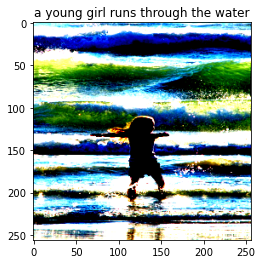

Original ['A', 'small', 'girl', 'spins', 'in', 'the', 'waves', 'in', 'the', 'bright', 'sun']
['girl', 'in', 'blue', 'and', 'white', 'uniform', 'playing', 'with', 'a', 'soccer', 'ball']
['a', 'girl', 'in', 'blue', 'and', 'white', 'is', 'playing', 'with', 'a', 'football']
['the', 'girl', 'is', 'playing', 'a', 'softball', 'game']
['a', 'girl', 'in', 'blue', 'and', 'white', 'is', 'kicking', 'a', 'soccer', 'ball']


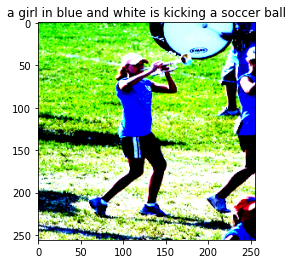

Original ['A', 'girl', 'playing', 'trumpet', 'in', 'a', 'marching', 'band']
['a', 'woman', 'is', 'holding', 'up', 'a', 'box', 'of', 'a', 'tray', 'and', 'a', 'hamburgers', '.']
['a', 'girl', 'is', 'standing', 'in', 'front', 'of', 'an', 'art', 'display', 'while', 'a', 'group', 'of', 'people', 'sit', 'on', 'the', 'table']
['a', 'girl', 'in', 'a', 'green', 'shirt', 'and', 'apron', 'is', 'serving', 'food', 'at', 'a', 'tray', 'of', 'hamburgers']
['two', 'asian', 'women', 'are', 'posing', 'for', 'a', 'picture', 'while', 'a', 'man', 'in', 'a', 'green', 'hat', 'watches', 'the', 'other', 'boys']


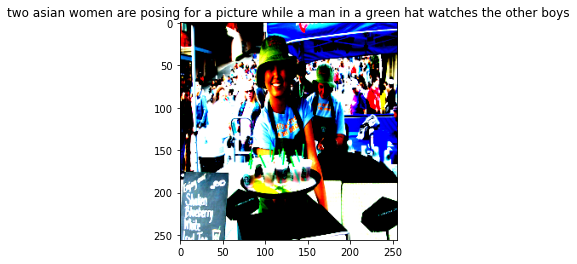

Original ['A', 'girl', 'hands', 'out', 'Starbucks', 'samples', 'at', 'a', 'street', 'fair']
['a', 'man', 'is', 'setting', 'up', 'a', 'little', 'girl', 'on', 'the', 'ground', 'while', 'riding', 'a', 'toy']
['a', 'group', 'of', 'skiers', 'and', 'a', 'dog']
['a', 'group', 'of', 'people', 'on', 'a', 'sled', 'in', 'the']
['a', 'group', 'of', 'people', 'on', 'a', 'sled']


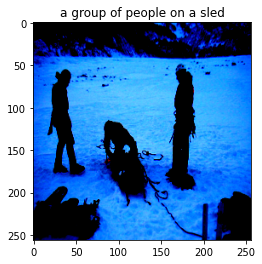

Original ['Three', 'men', 'are', 'setting', 'up', 'a', 'sledge', 'on', 'a', 'snowy', 'plain']
['a', 'boy', 'in', 'a', 'white', 'shirt', 'is', 'kicking', 'a', 'soccer', 'ball', 'in', 'a', 'field']
['a', 'boy', 'in', 'a', 'blue', 'shirt', 'is', 'kicking', 'a', 'soccer', 'ball', 'in', 'the', 'air']
['a', 'boy', 'is', 'jumping', 'in', 'the', 'air', 'in', 'the', 'air']
['a', 'boy', 'in', 'a', 'blue', 'shirt', 'is', 'jumping', 'into', 'the', 'air']


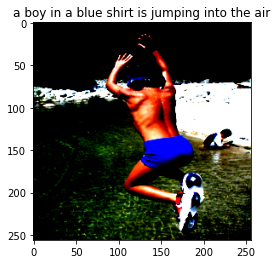

Original ['A', 'child', 'jumping', 'into', 'a', 'lake', 'in', 'a', 'wooded', 'area', 'while', 'another', 'child', 'plays', 'on', 'the', 'shore']
['a', 'boy', 'wearing', 'jeans', 'hat', 'and', 'a', 'blue', 'shirt', 'sitting', 'on', 'a', 'bench']
['a', 'woman', 'with', 'a', 'hat', 'sits', 'on', 'a', 'bench', 'in', 'a', 'park', 'bench']
['a', 'boy', 'wearing', 'a', 'hat', 'sits', 'on', 'a', 'bench']
['a', 'boy', 'wearing', 'a', 'hat', 'sits', 'on', 'the', 'bench']


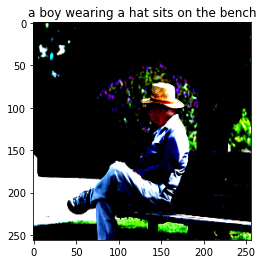

Original ['A', 'elderly', 'man', 'in', 'a', 'straw', 'hat', 'is', 'sitting', 'on', 'a', 'bench']
['three', 'girls', 'are', 'walking', 'through', 'a', 'tunnel', 'on', 'a', 'woodland', 'course']
['three', 'girls', 'are', 'walking', 'on', 'a', 'bridge', 'in', 'the', 'woods']
['two', 'people', 'on', 'a', 'bench', 'in', 'a', 'park']
['three', 'girls', 'are', 'walking', 'along', 'a', 'path', 'in', 'the', 'woods']


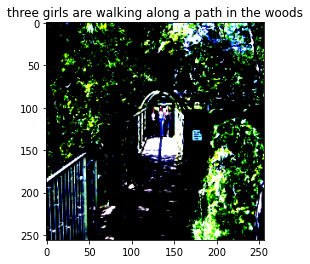

Original ['Three', 'girls', 'are', 'walking', 'across', 'a', 'bridge', 'covered', 'with', 'wood', 'and', 'surrounded', 'by', 'trees']
['a', 'girl', 'in', 'a', 'pink', 'hat', 'is', 'riding', 'a', 'bike', 'on', 'the', 'side', 'of', 'a', 'road']
['a', 'little', 'girl', 'in', 'a', 'red', 'hat', 'with', 'a', 'yellow', 'hat', 'on', 'her', 'back']
['a', 'girl', 'in', 'a', 'pink', 'top', 'is', 'riding', 'her', 'bike', 'over', 'a', 'rock']
['a', 'young', 'girl', 'wearing', 'a', 'red', 'and', 'white', 'hat', 'and', 'black', 'hat', 'climbing', 'a', 'rock']


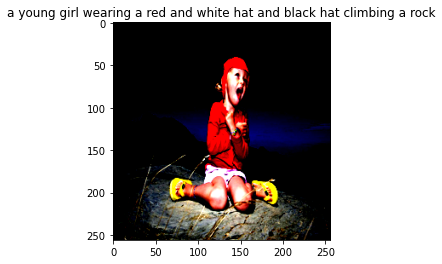

Original ['A', 'girl', 'dressed', 'in', 'a', 'red', 'top', ',', 'a', 'red', 'cap', ',', 'and', 'light', 'colored', 'shorts', ',', 'sits', 'on', 'a', 'rock', 'outside']
['a', 'man', 'sits', 'on', 'his', 'back', 'in', 'the', 'snow']
['a', 'man', 'sits', 'on', 'a', 'snowboard', 'in', 'the', 'winter']
['a', 'man', 'sits', 'in', 'a', 'snowy', 'field']
['a', 'man', 'sits', 'in', 'the', 'snow', 'near', 'a', 'tent']


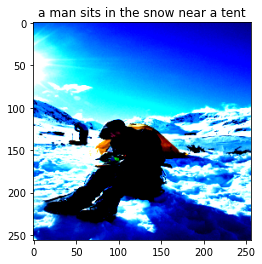

Original ['A', 'man', 'eats', 'near', 'a', 'tent', 'in', 'the', 'snow']
['two', 'dogs', 'are', 'running', 'in', 'the', 'grass', ',', 'one', 'carrying', 'something', 'in', 'its', 'mouths']
['two', 'black', 'dogs', 'are', 'running', 'through', 'a', 'park']
['a', 'black', 'dog', 'and', 'a', 'brown', 'dog', 'are', 'running', 'through', 'the', 'grass']
['two', 'dogs', 'run', 'through', 'a', 'field']


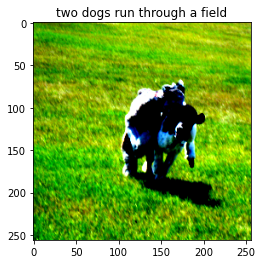

Original ['A', 'grey', 'dog', 'beside', 'a', 'black', 'and', 'white', 'dog', 'running', 'in', 'green', 'grass']
['a', 'man', 'and', 'a', 'woman', 'are', 'sitting', 'on', 'the', 'sand', '.']
['a', 'man', 'and', 'a', 'woman', 'are', 'playing', 'tug', '-', 'in', '-', 'war']
['a', 'man', 'and', 'a', 'dog', 'playing', 'with', 'two', 'puppies']
['a', 'man', 'and', 'a', 'dog', 'playing', 'in', 'the', 'sand']


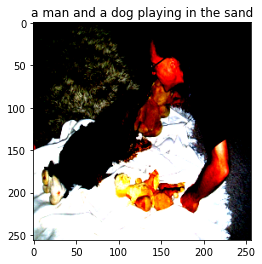

Original ['A', 'man', 'in', 'a', 'red', 'shirt', 'and', 'glasses', 'is', 'bending', 'down', 'towards', 'a', 'small', 'dog', 'on', 'a', 'blanket', 'with', 'several', 'stuffed', 'animals']
['a', 'boy', 'with', 'a', '<UNK>', 'shirt', 'and', 'his', 'shirt', 'is', 'smiling']
['a', 'young', 'boy', 'with', 'a', '<UNK>', 'on', 'his', 'head']
['a', 'boy', 'with', 'a', 'nose', 'ring']
['young', 'boy', 'in', 'a', 'dark', 't', '-', 'shirt', 'with', 'a', 'smile']


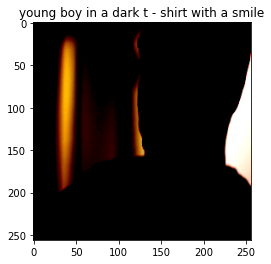

Original ['A', 'guy', 'with', 'a', 'nose', 'piercing']
['a', 'man', 'in', 'a', '<UNK>', 'shirt', 'looks', 'at', 'a', 'woman', 'in', 'a', 'yellow', 'shirt']
['a', 'man', 'in', 'a', 'yellow', 't', '-', 'shirt', 'looks', 'to', 'the', 'left']
['the', 'man', 'is', 'wearing', 'a', '<UNK>', 'shirt']
['a', 'man', 'wearing', 'a', 'yellow', 'shirt', 'looks', 'at', 'the', 'camera']


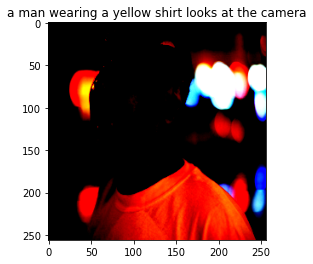

Original ['A', 'man', 'in', 'yellow', 'grimaces']
['two', 'people', 'stand', 'at', 'a', 'table', 'in', 'a', 'bar']
['a', 'man', 'sits', 'at', 'a', 'table', 'in', 'front', 'of', 'a', 'store']
['a', 'couple', 'stands', 'outside', 'a', 'restaurant', 'at', 'night']
['a', 'man', 'and', 'woman', 'sit', 'at', 'a', 'table', 'outside']


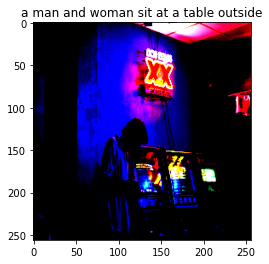

Original ['A', 'man', 'is', 'standing', 'by', 'a', 'group', 'of', 'video', 'games', 'in', 'a', 'bar']
['two', 'brown', 'and', 'brown', 'dogs', 'running', 'through', 'the', 'grass']
['two', 'brown', 'dogs', 'are', 'running', 'through', 'the', 'grass']
['two', 'brown', 'dogs', 'run', 'through', 'the', 'grass']
['a', 'brown', 'dog', 'and', 'a', 'large', 'brown', 'dog', 'are', 'playing', 'in', 'a', 'field']


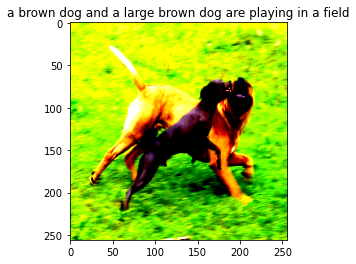

Original ['A', 'big', 'brown', 'dog', 'plays', 'with', 'a', 'smaller', 'grey', 'dog', 'on', 'the', 'grass']
['the', 'boy', 'is', 'running', 'on', 'the', 'beach']
['a', 'boy', 'in', 'a', 'blue', 'shirt', 'is', 'running', 'on', 'the', 'beach']
['a', 'boy', 'in', 'shorts', 'and', 'a', 't', '-', 'shirt', 'on', 'a', 'beach']
['two', 'boys', 'playing', 'in', 'the', 'water']


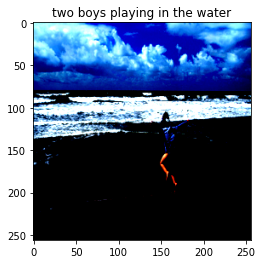

Original ['A', 'girl', 'in', 'blue', 'is', 'jumping', 'on', 'the', 'shore', 'as', 'small', 'waves', 'approach', 'her']
['a', 'group', 'walking', 'in', 'a', 'town', 'square']
['several', 'people', 'are', 'walking', 'in', 'a', 'city', 'street']
['a', 'crowd', 'of', 'men', 'walk', 'along', 'the', 'street']
['a', 'large', 'group', 'of', 'people', 'walking', 'in', 'a', 'city', 'street']


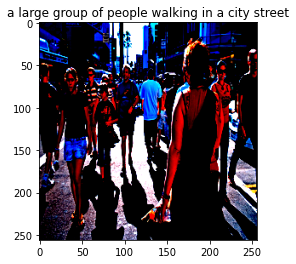

Original ['A', 'crowd', 'of', 'people', 'walk', 'down', 'a', 'busy', 'sidewalk']
['a', 'dog', 'jumps', 'in', 'the', 'air', 'to', 'catch', 'a', 'ball']
['a', 'dog', 'jumps', 'to', 'a', 'red', 'ball']
['one', 'dog', 'leaps', 'to', 'catch', 'a', 'orange', 'ball']
['a', 'boy', 'jumps', 'into', 'a', 'ball', 'in', 'a', 'field']


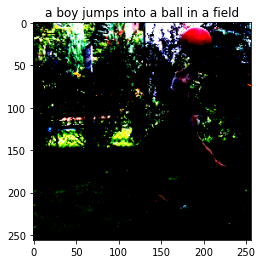

Original ['A', 'big', 'dog', 'catches', 'a', 'ball', 'on', 'his']
['two', 'boys', 'are', 'squirting', 'a', 'water', 'bottle']
['two', 'boys', 'are', 'standing', 'in', 'a', 'water', 'fountain']
['a', 'little', 'boy', 'and', 'a', 'boy', 'are', 'playing', 'in', 'a', 'water', 'fountain']
['two', 'boys', 'play', 'in', 'a', 'puddle']


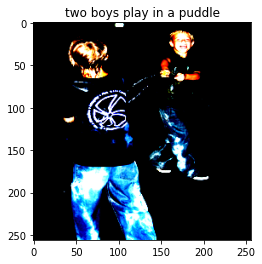

Original ['Two', 'blonde', 'boys', ',', 'one', 'in', 'a', 'camouflage', 'shirt', 'and', 'the', 'other', 'in', 'blue', ',', 'are', 'having', 'a', 'water', 'fight']
['a', 'dog', 'is', 'playing', 'in', 'the', 'water', 'while', 'playing', 'catch', 'a', 'blue', 'ball']
['a', 'dog', 'is', 'jumping', 'into', 'a', 'pool']
['a', 'dog', 'jumps', 'in', 'the', 'air', 'to', 'catch', 'a', 'blue', 'ball']
['a', 'brown', 'dog', 'jumping', 'into', 'a', 'pool']


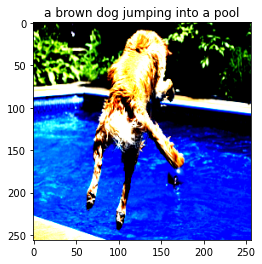

Original ['a', 'brown', 'dog', 'jumping', 'into', 'a', 'pool', 'after', 'a', 'bloe', 'ball']
['a', 'group', 'of', 'children', 'are', 'riding', 'a', 'toy', 'car']
['twin', 'toddlers', 'dressed', 'in', 'red', 'and', 'black', 'uniforms', 'pose', 'in', 'front', 'of', 'a', 'red', 'truck']
['a', 'group', 'of', 'children', 'are', 'riding', 'a', 'toy', 'car']
['a', 'group', 'of', 'children', 'play', 'in', 'the', 'street']


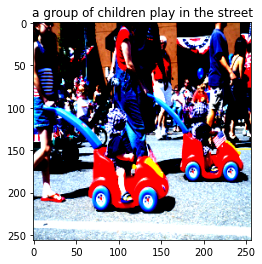

Original ['Parents', 'are', 'pushing', 'little', 'children', 'in', 'red', 'car', 'carts']
['a', 'woman', 'with', 'a', 'black', 'hat', 'and', 'a', 'black', 'hat', 'with', 'a', '<UNK>', 'on', 'her', 'face']
['a', 'woman', 'wearing', 'a', 'black', 'hat', 'holding', 'a', 'camera']
['a', 'girl', 'wearing', 'a', 'black', 'hat', 'is', 'smiling']
['an', 'asian', 'boy', 'with', 'a', '<UNK>', 'around', 'his']


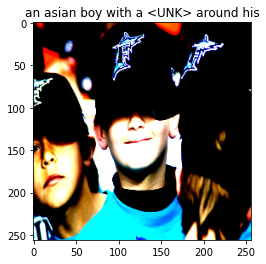

Original ['A', 'boys', 'baseball', 'team', 'wear', 'their', 'uniforms']
['a', 'dog', 'is', 'running', 'in', 'a', 'field', 'in', 'the', 'grass']
['the', 'dog', 'in', 'the', 'grass']
['a', 'brown', 'dog', 'is', 'running', 'in', 'a', 'grassy', 'area']
['a', 'brown', 'dog', 'is', 'running', 'in', 'a', 'field']


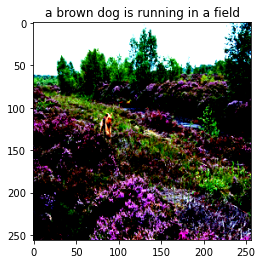

Original ['A', 'brown', 'dog', 'running', 'through', 'the', 'grass', 'and', 'flowers']
['a', 'small', 'dog', 'and', 'a', 'little', 'dog', 'are', 'playing', 'tug', 'of', 'war', 'with', 'a', 'toy']
['two', 'dogs', 'are', 'playing', 'together', 'with', 'a', 'tennis', 'of', 'ball']
['two', 'dogs', 'are', 'playing', 'with', 'a', 'toy']
['a', 'small', 'dog', 'with', 'his', 'eyes', 'closed']


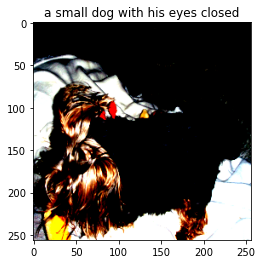

Original ['A', 'small', 'brown', 'and', 'black']
['the', 'brown', 'dog', 'is', 'jumping', 'over', 'the', 'grass', 'with', 'its', 'mouth', 'open', ',', 'tongue', 'hanging', 'over', 'its', 'head']
['the', 'yellow', 'dog', 'is', 'running', 'through', 'the', 'green', 'grass']
['a', 'dog', 'is', 'running', 'through', 'a', 'grassy', 'area', 'with', 'its', 'tongue', 'hanging', 'out']
['a', 'brown', 'dog', 'is', 'jumping', 'over', 'a', 'horizontal', 'tree']


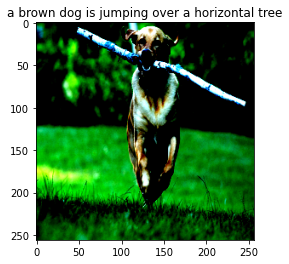

Original ['A', 'big', 'tan', 'dog', 'runs', 'on', 'grass', 'with', 'a', 'big', 'stick', 'in', 'his', 'mouth']
['two', 'dogs', 'are', 'jumping', 'into', 'a', 'pool', 'while', 'a', 'dog', 'jumps', 'in', 'a', 'pool']
['two', 'dogs', 'are', 'jumping', 'into', 'a', 'swimming', 'pool']
['a', 'dog', 'jumps', 'into', 'a', 'pool', 'while', 'a', 'woman', 'watches']
['a', 'dog', 'jumps', 'into', 'a', 'swimming', 'pool']


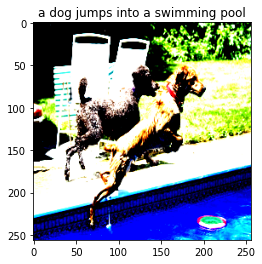

Original ['A', 'dog', 'jumping', 'into', 'a', 'swimming', 'pool']
['two', 'young', 'boys', 'are', 'looking', 'at', 'each', 'other', 'while', 'a', 'third', 'man', 'is', 'standing', 'behind', 'them']
['a', 'young', 'girl', 'in', 'a', 'green', 'dress', 'is', 'sitting', 'at', 'a', 'man', 'in', 'a', 'green', 'jacket']
['two', 'girls', 'are', 'standing', 'in', 'front', 'of', 'a', 'building']
['a', 'young', 'girl', 'in', 'a', 'green', 'dress', 'walks', 'past', 'a', 'billboard']


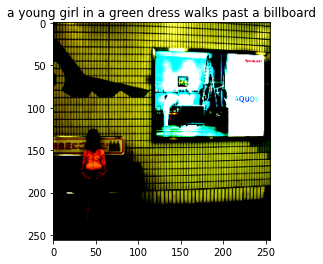

Original ['A', 'little', 'old', 'lady', 'sitting', 'next', 'to', 'an', 'advertisement']
['a', 'girl', 'in', 'a', 'purple', 'shirt', 'and', 'a', 'girl', 'in', 'a', 'black', 'and', 'white', 'outfit']
['a', 'girl', 'on', 'a', 'scooter']
['a', 'little', 'girl', 'rides', 'a', 'unicycle', 'on', 'a', 'scooter']
['a', 'woman', 'with', 'a', 'purple', 'shirt', 'and', 'a', 'man', 'on', 'a', 'unicycle']


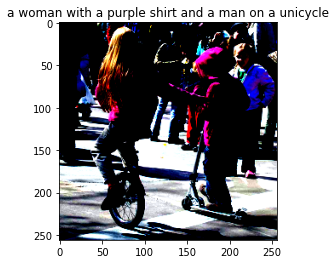

Original ['A', 'girl', 'rides', 'a', 'unicycle', 'as', 'another', 'rides', 'a', 'scooter', 'next', 'to', 'her']
['a', 'man', 'sits', 'in', 'a', 'boat', 'on', 'a', 'pier']
['a', 'man', 'sits', 'on', 'a', 'bench', 'in', 'the', 'city']
['two', 'people', 'sitting', 'on', 'a', 'dock']
['a', 'woman', 'in', 'a', 'blue', 'shirt', 'sits', 'on', 'a', 'dock', 'reading', 'a', 'newspaper']


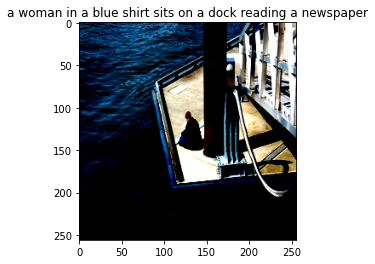

Original ['A', 'man', 'in', 'a', 'brown', 'shirt', 'sitting', 'on', 'a', 'dock', 'and', 'reading']
['a', 'group', 'of', 'people', 'sit', 'on', 'a', 'bench', 'in', 'a', 'park', 'bench']
['four', 'people', 'pose', 'for', 'a', 'picture', 'on', 'a', 'stone', 'ledge']
['three', 'people', 'sit', 'on', 'a', 'bench', 'in', 'a', 'park']
['four', 'people', 'sitting', 'on', 'a', 'bench', 'in', 'front', 'of', 'some', 'trees']


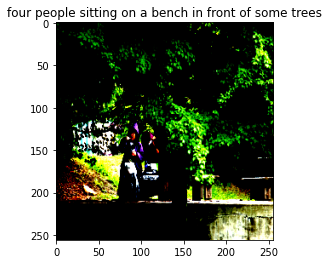

Original ['a', 'person', 'sits', 'at', 'a', 'table', 'behind', 'a', 'tree']
['three', 'women', 'walk', 'down', 'a', 'city', 'sidewalk']
['a', 'man', 'and', 'a', 'woman', 'are', 'standing', 'next', 'to', 'a', 'statue']
['three', 'women', 'walk', 'down', 'the', 'street']
['a', 'man', 'in', 'a', 'blue', 'shirt', 'is', 'standing', 'next', 'to', 'a', 'woman', 'in', 'black']


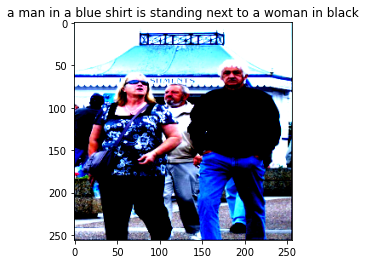

Original ['a', 'couple', 'walking', 'along', 'on', 'a']
['two', 'girls', 'are', 'sitting', 'on', 'the', 'side', 'of', 'an', 'empty', 'picnic', 'picnic', 'bench']
['two', 'girls', 'are', 'sitting', 'on', 'a', 'park', 'table']
['a', 'girl', 'is', 'sitting', 'on', 'a', 'picnic', 'table', 'in', 'the', 'back', 'of', 'her']
['a', 'girl', 'is', 'sitting', 'on', 'a', 'wooden', 'bench', 'next', 'to', 'a', 'scooter']


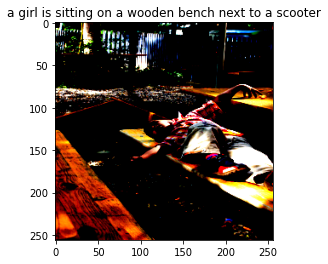

Original ['A', 'boy', 'lays', 'on', 'a', 'picnic', 'table', 'bench']
['two', 'brown', 'dogs', 'are', 'playing', 'in', 'the', 'grass']
['a', 'brown', 'and', 'black', 'dog', 'is', 'playing', 'with', 'a', 'red', 'and', 'white', 'toy']
['two', 'dogs', 'play', 'with', 'each', 'other', 'in', 'the']
['two', 'dogs', 'run', 'through', 'the', 'grass']


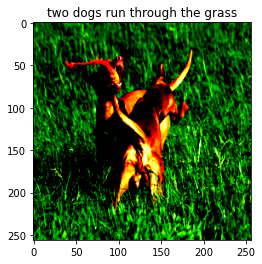

Original ['Dogs', 'fight', 'in', 'grass', 'over', 'toy']
['two', 'boys', 'are', 'posing', 'on', 'the', 'playground']
['a', 'boy', 'in', 'a', 'blue', 'shirt', 'looking', 'over', 'a', 'railing']
['a', 'man', 'and', 'a', 'woman', 'are', 'standing', 'on', 'a', 'bench', 'in', 'a', 'city', 'park']
['a', 'boy', 'and', 'a', 'woman', 'are', 'standing', 'on', 'a', 'platform', 'in', 'a', 'park']


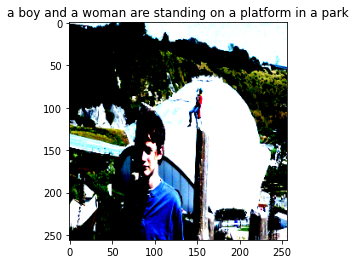

Original ['A', 'boy', 'and', 'a', 'person', 'suspended', 'above', 'a', 'dome', 'structure']
['a', 'group', 'of', 'people', 'stand', 'in', 'front', 'of', 'a', 'group', 'of', 'people', 'on', 'a', 'street', '.']
['a', 'girl', 'in', 'a', 'white', 'top', 'is', 'standing', 'next', 'to', 'a', 'girl', 'in', 'a', 'black', 'dress']
['a', 'girl', 'in', 'a', 'white', 'dress', 'is', 'walking', 'with', 'a', 'man', 'in', 'a', 'black', 'dress']
['a', 'girl', 'in', 'a', 'purple', 'dress', 'is', 'standing', 'by', 'a', 'man', 'in', 'a', 'blue', 'dress']


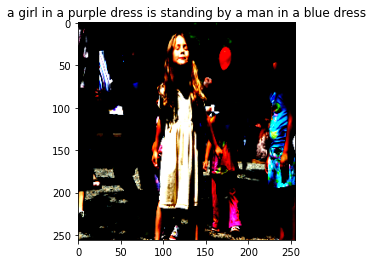

Original ['A', 'girl', 'in', 'a', 'brown', 'dress', 'surrounded', 'by', 'children', 'closes', 'her', 'eyes']
['a', 'man', 'and', 'a', 'woman', 'are', 'walking', 'down', 'a', 'city', 'sidewalk']
['a', 'man', 'and', 'a', 'woman', 'are', 'walking', 'in', 'a', 'city', 'park']
['a', 'man', 'and', 'a', 'woman', 'walk', 'down', 'the', 'street']
['a', 'man', 'and', 'a', 'woman', 'walking', 'on', 'a', 'sidewalk']


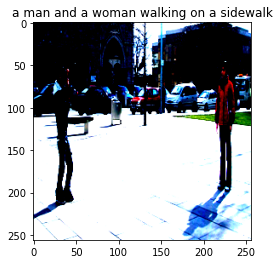

Original ['A', 'man', 'in', 'a', 'black', 'jacket', 'is', 'taking', 'a', 'photo', 'of', 'a', 'man', 'in', 'a', 'red', 'jacket']
['some', 'children', 'are', 'posing', 'for', 'a', 'picture', 'on', 'a', 'cement', 'platform']
['two', 'young', 'women', 'sit', 'on', 'a', 'bench', 'in', 'front', 'of', 'a', 'fountain']
['two', 'boys', 'sit', 'on', 'a', 'bench', 'in', 'the', 'street']
['three', 'boys', 'are', 'sitting', 'on', 'a', 'bench', 'outside', 'a', 'city']


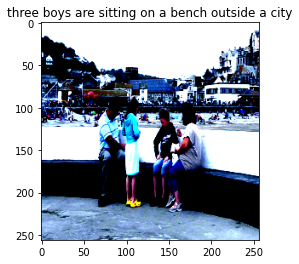

Original ['A', 'family', 'sits', 'on', 'a', 'bench', 'near', 'a', 'beach']
['people', 'are', 'walking', 'on', 'a', 'rock', 'wall']
['two', 'people', 'are', 'climbing', 'a', 'rock', 'wall']
['a', 'group', 'of', 'people', 'climb', 'a', 'brick', 'wall']
['a', 'group', 'of', 'people', 'climb', 'a', 'cliff']


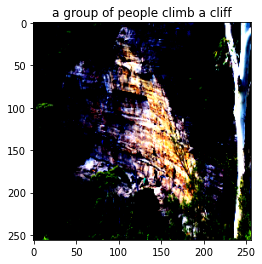

Original ['A', 'group', 'of', 'climbers', 'begin', 'up', 'a', 'sheer', 'rock', 'face']
['three', 'men', 'are', 'sitting', 'on', 'a', 'dock', 'and', 'look', 'at', 'each', 'other']
['two', 'men', 'and', 'a', 'woman', 'sitting', 'in', 'the', 'shadows', 'near', 'a', 'building']
['two', 'men', 'are', 'sitting', 'on', 'the', 'side', 'of', 'a', 'boat', 'in', 'front', 'of', 'a', 'church']
['three', 'men', 'are', 'standing', 'on', 'the', 'side', 'of', 'a', 'boat', 'in', 'front', 'of', 'a', 'building']


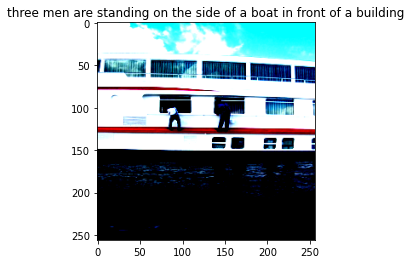

Original ['two', 'men', 'cleaning', 'the', 'outside', 'windows', 'of', 'a']
['two', 'girls', 'are', 'running', 'on', 'a', 'path', 'in', 'the', 'park', 'with', 'a', 'man', 'looks', 'on']
['two', 'young', 'girls', 'are', 'walking', 'in', 'a', 'park']
['two', 'girls', 'are', 'running', 'through', 'a', 'yard']
['two', 'girls', 'run', 'down', 'a', 'dirt', 'road', 'in', 'the', 'grass']


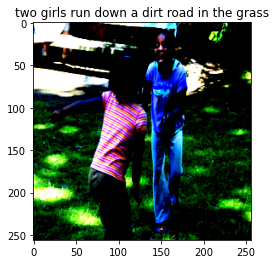

Original ['Two', 'children', 'are', 'laughing', 'in', 'the', 'grass']
['two', 'young', 'boys', 'are', 'posing', 'on', 'a', 'swing', 'in', 'the', 'woods']
['a', 'boy', 'in', 'red', 'and', 'white', 'is', 'holding', 'a', 'rope']
['two', 'young', 'boys', 'are', 'posing', 'on', 'a', 'swing']
['a', 'boy', 'in', 'a', 'red', 'shirt', 'swings', 'on', 'a', 'swing']


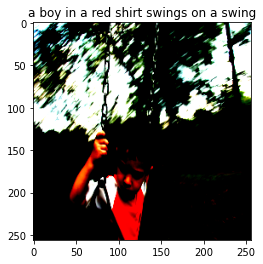

Original ['A', 'boy', 'in', 'a', 'red', 'and', 'white', 'shirt', 'is', 'on', 'a', 'swing']
['two', 'young', 'children', 'are', 'eating', 'and', 'laughing']
['two', 'little', 'boys', 'are', 'sitting', 'in', 'a', 'blue', 'and', 'yellow', 'tunnel']
['two', 'little', 'boys', 'are', 'sitting', 'on', 'a', 'blue', 'bench']
['a', 'little', 'boy', 'drinks', 'water', 'from', 'a', 'spoon']


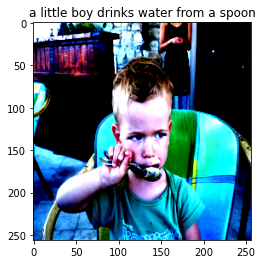

Original ['A', 'boy', 'eats', 'with', 'a', 'spoon']
['an', 'older', 'woman', 'walks', 'down', 'a', 'brick', 'sidewalk']
['a', 'woman', 'walking', 'down', 'a', 'city', 'sidewalk']
['a', 'woman', 'walking', 'down', 'a', 'brick', 'sidewalk', 'at', 'night']
['a', 'woman', 'walks', 'down', 'a', 'brick', 'sidewalk', 'at', 'night']


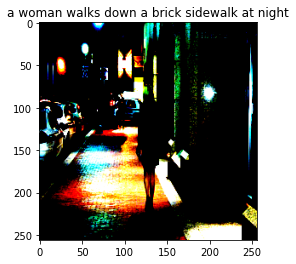

Original ['A', 'girl', 'walking', 'alone', 'at', 'night', 'on', 'a', 'street']
['two', 'black', 'dogs', 'are', 'playing', 'with', 'a', 'toy', 'in', 'a', 'field', 'of', 'grass']
['a', 'black', 'dog', 'and', 'a', 'brown', 'dog', 'are', 'running', 'through', 'the', 'grass']
['a', 'black', 'dog', 'carries', 'a', 'large', 'stick']
['two', 'black', 'dogs', 'are', 'fighting', 'over', 'a', 'stick']


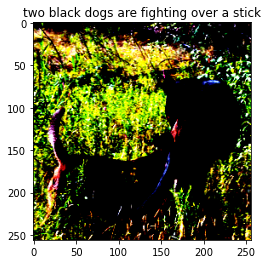

Original ['A', 'black', 'dog', 'and', 'a', 'brown', 'dog', 'playing', 'in', 'tall', 'weeds']
['two', 'brown', 'dogs', 'are', 'playing', 'on', 'the', 'grass']
['a', 'dog', 'jumps', 'in', 'the', 'air', 'to', 'catch', 'a', 'ball', 'in', 'its', 'mouth']
['a', 'brown', 'dog', 'jumping', 'in', 'the', 'air', 'with', 'his', 'tongue', 'hanging', 'out']
['a', 'brown', 'dog', 'is', 'jumping', 'up', 'to', 'catch', 'a', 'ball', 'in', 'his', 'mouth']


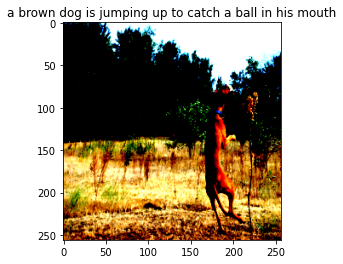

Original ['A', 'brown', 'dog', 'jumping', 'in', 'the', 'air', 'on', 'a', 'brown', 'plain']
['a', 'little', 'boy', 'in', 'a', 'blue', 'shirt', 'and', 'jeans', 'sits', 'in', 'a', 'red', 'blanket']
['a', 'child', 'in', 'a', 'blue', 'jacket', 'is', 'laying', 'on', 'a', 'red', 'cushion']
['the', 'little', 'boy', 'is', 'laying', 'on', 'a', 'red', 'bench']
['a', 'child', 'in', 'a', 'blue', 'shirt', 'laying', 'on', 'a', 'red', 'cushion']


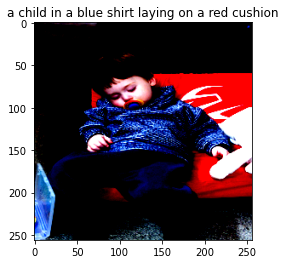

Original ['A', 'child', 'in', 'gray', 'clothes', 'is', 'sleeping', 'on', 'a', 'red', 'cushion']
['a', 'little', 'girl', 'in', 'green', 'is', 'blowing', 'bubbles']
['a', 'little', 'girl', 'in', 'a', 'green', 'shirt', 'and', 'hat', 'sits', 'at', 'the', 'playground', 'equipment']
['a', 'little', 'girl', 'is', 'smiling', 'at', 'the', 'playground']
['a', 'little', 'girl', 'in', 'a', 'green', 'bathing', 'suit', 'at', 'a', 'park', 'playground']


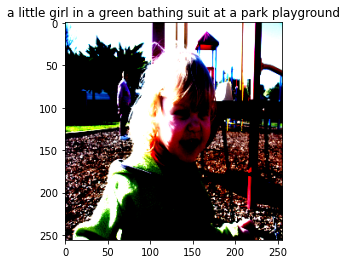

Original ['A', 'baby', 'girl', 'playing', 'at', 'a', 'park']
['a', 'woman', 'with', 'a', 'brown', 'dog', 'is', 'riding', 'on', 'a', 'brown', 'horse']
['a', 'woman', 'in', 'a', 'bikini', 'is', 'looking', 'at', 'a', 'man', 'on', 'the', 'side', 'of', 'a', 'horse', 'at', 'a', 'dog']
['a', 'woman', 'in', 'a', 'blue', 'shirt', 'is', 'riding', 'on', 'a', 'brown', 'pony', 'with', 'a', 'dog']
['a', 'woman', 'with', 'a', 'brown', 'dog', 'and', 'a', 'girl', 'in', 'front', 'of', 'a', 'tree']


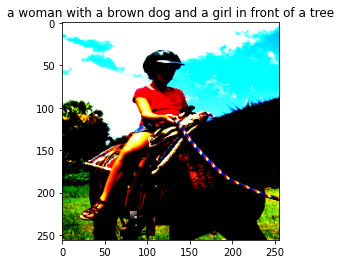

Original ['A', 'girl', 'in', 'a', 'helmet', 'rides', 'a', 'horse']
['a', 'man', 'wearing', 'a', 'hat', 'reads', 'a', 'book', 'while', 'a', 'crowd', 'watches']
['a', 'woman', 'wearing', 'a', 'hat', 'sits', 'near', 'a', 'row', 'of', 'soda']
['a', 'man', 'wearing', 'a', 'hat', 'reads', 'a', 'book']
['the', 'man', 'is', 'wearing', 'a', 'hat', 'and', 'sunglasses']


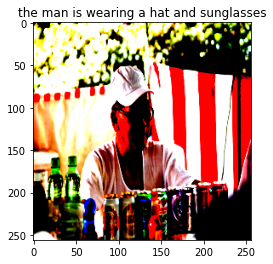

Original ['a', 'Korean', 'man', 'sells', 'soda']
['a', 'man', 'in', 'a', 'costume', 'is', 'holding', 'a', 'small', 'girl', 'in', 'a', 'red', 'flower']
['two', 'men', 'in', 'yellow', 'hats', 'and', 'hats', 'are', 'standing', 'in', 'a', 'crowd']
['a', 'man', 'in', 'a', 'red', 'hat', 'holding', 'a', 'microphone', 'in', 'front', 'of', 'a', 'woman', "'s"]
['a', 'man', 'in', 'a', 'costume', 'stands', 'next', 'to', 'a', 'woman', 'in', 'costume']


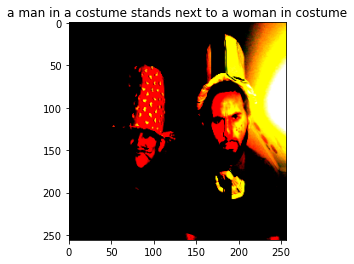

Original ['The', 'hatted', 'males', 'pose', 'for', 'a', 'picture']
['three', 'boys', 'play', 'on', 'a', 'skateboard', 'in', 'the', 'city', 'by']
['three', 'people', 'are', 'sitting', 'on', 'benches', 'and', 'looking', 'at', 'each', 'other']
['three', 'people', 'sit', 'on', 'a', 'bench', 'in', 'the', 'middle', 'of', 'the', 'city']
['three', 'people', 'sit', 'on', 'a', 'bench']


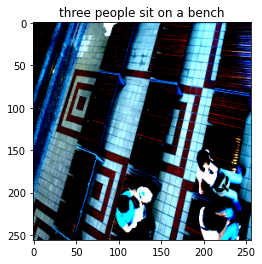

Original ['A', 'person', 'in', 'a', 'blue', 'shirt', 'sits', 'behind', 'two', 'people', 'sitting', 'on', 'a', 'wood', 'bench']
['a', 'woman', 'in', 'a', 'white', 'shirt', 'and', 'sunglasses', 'is', 'holding', 'a', 'small', 'child', 'in', 'a', 'busy', 'street']
['a', 'man', 'in', 'a', 'white', 'shirt', 'and', 'sunglasses', 'is', 'standing', 'in', 'a', 'crowd', 'of', 'people', 'and', 'smiling']
['a', 'man', 'in', 'a', 'blue', 'shirt', 'and', 'a', 'woman', 'in', 'a', 'white', 't', '-', 'shirt', 'are', 'posing', 'for', 'a', 'picture']
['a', 'woman', 'in', 'a', 'white', 'shirt', 'and', 'sunglasses', 'smiles']


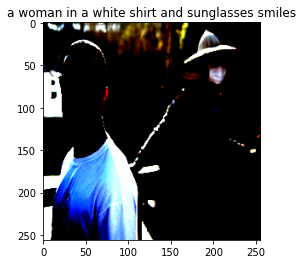

Original ['A', 'man', 'in', 'sunglasses', 'on', 'an', 'overpass']
['a', 'boy', 'jumps', 'into', 'the', 'pool', 'while', 'a', 'woman', 'plays', 'in', 'the', 'pool']
['a', 'boy', 'is', 'diving', 'into', 'a', 'swimming', 'pool', 'while', 'a', 'woman', 'watches']
['a', 'boy', 'jumps', 'into', 'a', 'pool']
['a', 'man', 'jumps', 'into', 'a', 'swimming', 'pool']


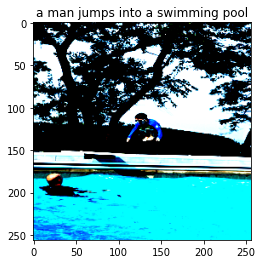

Original ['A', 'boy', 'in', 'a', 'wetsuit', 'jumps', 'into', 'a', 'pool', 'with', 'a', 'bald', 'man']
['a', 'boy', 'in', 'a', 'blue', 'wetsuit', 'jumps', 'into', 'the', 'pool']
['a', 'boy', 'jumps', 'off', 'a', 'diving', 'board', 'into', 'a', 'pool']
['a', 'boy', 'jumps', 'into', 'a', 'swimming', 'pool']
['a', 'boy', 'jumps', 'into', 'the', 'pool']


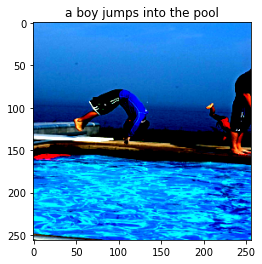

Original ['A', 'boy', 'flips', 'off', 'a', 'diving', 'board', 'into', 'a', 'pool']
['a', 'woman', 'holds', 'a', 'little', 'girl', 'while', 'a', 'boy', 'points', 'at', 'something']
['a', 'woman', 'holds', 'a', 'child', "'s", 'hand', 'as', 'a', 'crowd', 'watches']
['a', 'girl', 'is', 'taking', 'a', 'picture', 'of', 'another', 'child', 'at', 'the', 'bar']
['three', 'girls', 'are', 'standing', 'in', 'a', 'crowd']


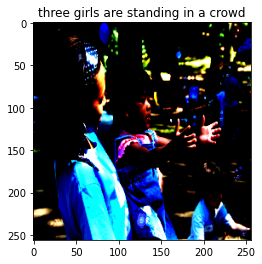

Original ['A', 'lady', 'holds', 'a', 'little', 'girl', 'who', 'is', 'trying', 'to', 'catch', 'bubbles']
['a', 'dog', 'chases', 'another', 'dog']
['three', 'dogs', 'are', 'playing', 'with', 'a', 'blue', 'ball', 'in', 'a', 'yard']
['a', 'white', 'dog', 'and', 'two', 'black', 'dogs', 'are', 'playing', 'with', 'a', 'tennis', 'ball', 'in', 'front', 'of', 'a', 'black', 'house']
['two', 'dogs', 'are', 'playing', 'with', 'a', 'blue', 'toy']


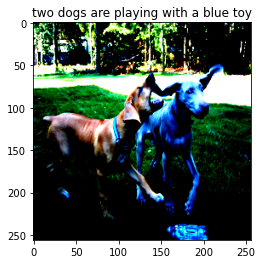

Original ['A', 'brown', 'dog', 'biting', 'a', 'gray', 'dogs', 'ear']
['a', 'soccer', 'player', 'in', 'blue', 'is', 'running', 'with', 'a', 'man', 'on', 'the', 'opposing', 'team']
['a', 'girl', 'runs', 'in', 'a', 'race']
['a', 'team', 'of', 'girls', 'in', 'a', 'blue', 'and', 'white', 'team', 'uniforms', 'run', 'for', 'the', 'ball']
['a', 'woman', 'wearing', 'a', 'blue', 'and', 'white', 'uniform', 'is', 'running', 'through', 'a', 'race']


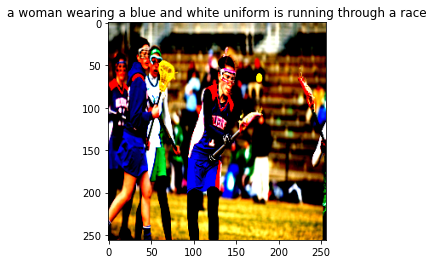

Original ['Girls', 'wearing', 'sports', 'uniforms', 'and', 'eye', 'protection']
['a', 'white', 'dog', 'is', 'running', 'through', 'a', 'grassy', 'lawn']
['three', 'dogs', 'run', 'through', 'the', 'grass']
['a', 'dog', 'chases', 'a', 'frisbee', 'in', 'the', 'grass']
['a', 'dog', 'is', 'running', 'through', 'the', 'grass']


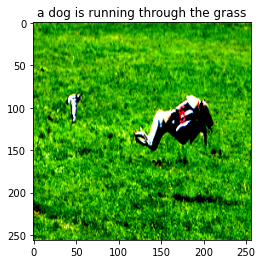

Original ['A', 'dog', 'in', 'a', 'number', 'six', 'jersey', 'is', 'running', 'through', 'a', 'field']
['a', 'large', 'brown', 'dog', 'and', 'two', 'black', 'poodles', 'are', 'playing', 'in', 'a', 'snowy', 'field']
['a', 'brown', 'dog', 'and', 'a', 'small', 'black', 'dog', 'frolicking', 'on', 'the', 'beach']
['a', 'brown', 'horse', 'and', 'a', 'black', 'foal', 'in', 'the', 'sand', 'on', 'a', 'beach']
['two', 'brown', 'dogs', 'are', 'running', 'on', 'the', 'sand', 'near', 'the', 'beach']


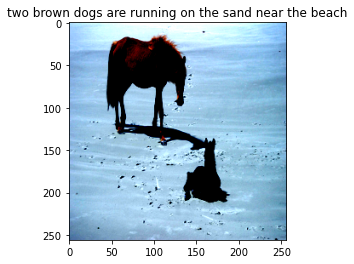

Original ['A', 'brown', 'horse', 'and', 'a', 'black', 'foal', 'on', 'the']
--------------------------------------------------------------------------------
Torch metrics
BLEU-1 0.3569689275069497
BLEU-2 0.19481751594672106
BLEU-3 0.1235749974385354
BLEU-4 0.07497996834180651
--------------------------------------------------------------------------------
Nltk metrics
BLEU-1 0.3569689284308891
BLEU-2 0.19481752328866322
BLEU-3 0.12357500201615172
BLEU-4 0.07497996939511867


In [55]:
checker()

In [ ]:
Torch metrics
BLEU-1 0.4838709533214569
BLEU-2 0.3417549431324005
BLEU-3 0.28220313787460327
BLEU-4 0.22571180760860443

In [58]:
import nltk
def checker():
    gc = []
    test = []
    # Will execute only 200 times. Inner 5 times
    offset = 0
    for i in range(0,1000,5):
        temp_gc = []
        encoder.eval()
        decoder.eval()
        with torch.no_grad():
            img_id, caption =  (dataset.imgs[i]), dataset.captions[i]
            img = Image.open(os.path.join(dataset.root_dir, img_id)).convert("RGB")
            img = dataset.transform(img)
            img = img.unsqueeze(0)
#             print(caption)
            
            encoded_output = encoder(img.to(device))
            for k in range(1,5):
                caps = decoder.beam_search(encoded_output, k)

                caps = [dataset.vocab.itos[idx] for idx in caps]

                generated_caption = ' '.join(caps)

                generated_caption = generated_caption.split()[1:]
                generated_caption = generated_caption[:-2]

                print(generated_caption)

            test.append(generated_caption)

#             show_image2(img.squeeze(0),i, title=' '.join(generated_caption) )
            caption = caption.split()[:-1]
            
            print("Original", caption)
            temp_gc.append(caption)
        for j in range(1,5):
            img, caption = (dataset.imgs[i + j]), dataset.captions[i + j]
            
            temp_gc.append(caption)
        gc.append(temp_gc)
        decoder.train()
#         encoder.train()
    
    print("-" * 80)
    print("Torch metrics")
    print("BLEU-1", bleu_score(test,gc, max_n = 1, weights = [1] ) )
    
    print("BLEU-2", bleu_score(test, gc, max_n = 2, weights = [0.5,0.5]))
    
    print("BLEU-3", bleu_score(test, gc, max_n = 3, weights = [0.33,0.33,0.33]))
    
    print("BLEU-4", bleu_score(test, gc, max_n = 4, weights = [0.25,0.25, 0.25, 0.25]))
    
    
    print("-"*80)
    print("Nltk metrics")
    BLEU4 = nltk.translate.bleu_score.corpus_bleu(gc, test,weights=(0.25,0.25,0.25,0.25))
    BLEU1 = nltk.translate.bleu_score.corpus_bleu(gc, test,weights=(1.0,0,0,0))
    BLEU2 = nltk.translate.bleu_score.corpus_bleu(gc, test,weights=(0.5,0.5,0,0))
    BLEU3 = nltk.translate.bleu_score.corpus_bleu(gc, test,weights=(0.33,0.33,0.33,0))
    
    
    print(f"BLEU-1 {BLEU1}")
    print(f"BLEU-2 {BLEU2}")
    print(f"BLEU-3 {BLEU3}")
    print(f"BLEU-4 {BLEU4}")
    
#     print("GC" , gc)
#     print("Predictions", test)
        
    

['a', 'little', 'girl', 'in', 'a', 'pink', 'dress', 'is', 'sitting', 'on', 'a', 'wooden', 'bench', 'in', 'the', 'middle', 'of', 'a', 'busy', 'street']
['two', 'little', 'girls', 'are', 'sitting', 'on', 'a', 'wooden', 'bench']
['two', 'little', 'girls', 'sitting', 'at', 'an', 'outdoor', 'cafe']
['two', 'little', 'girls', 'are', 'sitting', 'on', 'a', 'wooden', 'bench']


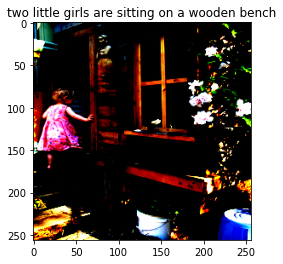

Original ['A', 'child', 'in', 'a', 'pink', 'dress', 'is', 'climbing', 'up', 'a', 'set', 'of', 'stairs', 'in', 'an', 'entry', 'way']
['two', 'black', 'and', 'white', 'dogs', 'are', 'running', 'through', 'the', 'grass']
['two', 'dogs', ',', 'one', 'black', 'and', 'one', 'white', 'and', 'one', 'black', 'and', 'white', 'dog', 'are', 'playing', 'on', 'the', 'dirt']
['two', 'dogs', ',', 'one', 'black', 'and', 'one', 'white', 'and', 'one', 'black', 'and', 'white', 'dog', 'are', 'running']
['a', 'black', 'dog', 'and', 'a', 'black', 'dog', 'are', 'playing', 'with', 'each', 'other']


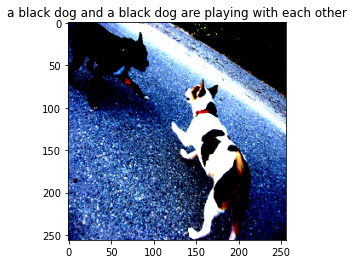

Original ['A', 'black', 'dog', 'and', 'a', 'spotted', 'dog', 'are']
['a', 'little', 'girl', 'is', 'sitting', 'on', 'a', 'painted', 'yellow', 'kayak']
['a', 'little', 'girl', 'is', 'in', 'a', 'colorful', 'kayak']
['a', 'little', 'girl', 'is', 'sitting', 'in', 'a', 'yellow', 'kayak']
['a', 'little', 'girl', 'sits', 'in', 'a', 'colorful', 'dress', 'near', 'water']


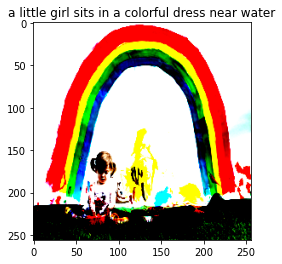

Original ['A', 'little', 'girl', 'covered', 'in', 'paint', 'sits', 'in', 'front', 'of', 'a', 'painted', 'rainbow', 'with', 'her', 'hands', 'in', 'a', 'bowl']
['two', 'men', 'with', 'their', 'dogs', 'are', 'standing', 'outside', 'of', 'a', 'fence']
['a', 'man', 'lays', 'on', 'a', 'bench', 'while', 'another', 'dog', 'looks', 'at']
['two', 'boys', 'play', 'on', 'a', 'swing', 'set']
['two', 'boys', 'play', 'in', 'a', 'park']


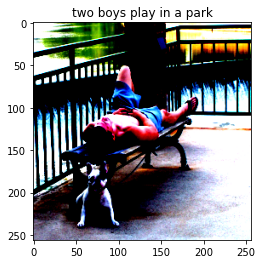

Original ['A', 'man', 'lays', 'on', 'a', 'bench', 'while', 'his', 'dog', 'sits', 'by', 'him']
['an', 'older', 'man', 'with', 'a', 'straw', 'hat', 'and', 'glasses', 'is', 'smiling']
['a', 'man', 'with', 'a', 'cowboy', 'hat', 'and', 'a', 'hat']
['a', 'man', 'wearing', 'sunglasses', 'and', 'a', 'hat', 'stands', 'in', 'front']
['a', 'man', 'with', 'glasses', 'and', 'a', 'hat', 'stands', 'near', 'a', 'crowd']


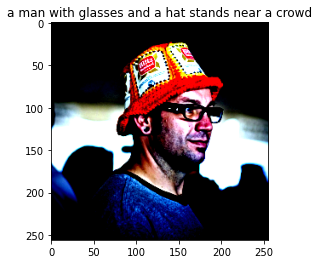

Original ['A', 'man', 'in', 'an', 'orange', 'hat', 'starring', 'at', 'something']
['a', 'girl', 'in', 'a', 'pink', 'shirt', 'climbs', 'on', 'a', 'red', 'ropes']
['a', 'little', 'girl', 'in', 'red', 'and', 'pink', 'is', 'climbing', 'on', 'red', 'roping']
['a', 'young', 'girl', 'climbing', 'on', 'a', 'red', 'jungle']
['two', 'young', 'girls', 'on', 'a', 'red', 'jungle', 'gym']


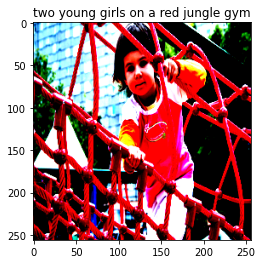

Original ['A', 'child', 'playing', 'on', 'a', 'rope', 'net']
['a', 'dog', 'is', 'running', 'through', 'the', 'grass', '.']
['a', 'black', 'and', 'white', 'dog', 'is', 'running', 'through', 'a', 'grassy', 'area']
['a', 'brown', 'and', 'white', 'dog', 'is', 'running', 'through', 'a', 'grassy', 'field']
['a', 'black', 'and', 'white', 'dog', 'is', 'playing', 'in', 'a', 'yard']


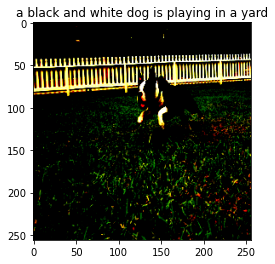

Original ['A', 'black', 'and', 'white', 'dog', 'is', 'running', 'in', 'a', 'grassy', 'garden', 'surrounded', 'by', 'a', 'white', 'fence']
['a', 'white', 'dog', 'with', 'a', 'red', 'collar', 'and', 'blue', 'and', 'brown', 'dog', 'running', 'on', 'a', 'dirt', 'road']
['a', 'dog', 'and', 'a', 'woman', 'in', 'a', 'dog']
['two', 'white', 'dogs', 'are', 'playing', 'with', 'a', 'red', 'ball']
['two', 'white', 'dogs', 'are', 'running', 'towards', 'each', 'other', 'in', 'the', 'sand']


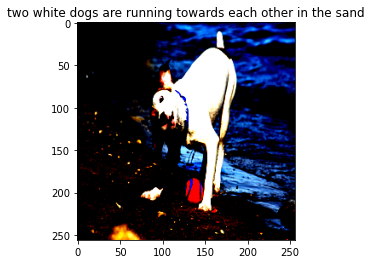

Original ['A', 'dog', 'shakes', 'its', 'head', 'near', 'the', 'shore', ',', 'a', 'red', 'ball', 'next', 'to', 'it']
['a', 'boy', 'in', 'a', 'blue', 'shirt', 'is', 'standing', 'in', 'front', 'of', 'a', 'stony', 'fence']
['the', 'little', 'boy', 'in', 'the', 'blue', 'top', 'is', 'climbing', 'a', 'rock', 'wall']
['a', 'young', 'boy', 'in', 'a', 'blue', 'shirt', 'is', 'standing', 'on', 'a', 'post', 'in', 'the', 'street']
['a', 'young', 'boy', 'is', 'running', 'through', 'a', 'city', 'street']


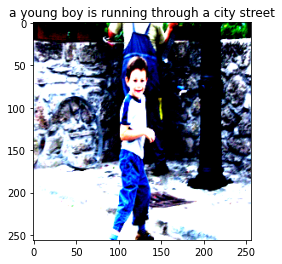

Original ['A', 'boy', 'smiles', 'in', 'front', 'of', 'a', 'stony', 'wall', 'in', 'a', 'city']
['a', 'black', 'dog', 'jumps', 'over', 'another', 'log']
['two', 'black', 'dogs', 'are', 'running', 'through', 'a', 'grassy', 'area']
['a', 'black', 'and', 'brown', 'dog', 'jumps', 'over', 'a', 'log']
['a', 'black', 'dog', 'jumps', 'over', 'a', 'fallen', 'tree']


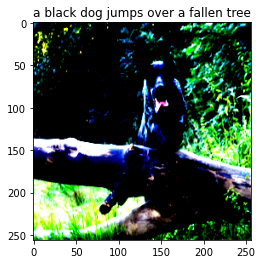

Original ['A', 'black', 'dog', 'leaps', 'over', 'a', 'log']
['the', 'white', 'dog', 'is', 'running', 'through', 'the', 'white', 'snow']
['two', 'dogs', 'running', 'in', 'the', 'snow']
['a', 'white', 'dog', 'and', 'a', 'brown', 'dog', 'are', 'running', 'through', 'the', 'snow']
['a', 'white', 'dog', 'and', 'a', 'black', 'dog', 'are', 'running', 'through', 'the', 'snow']


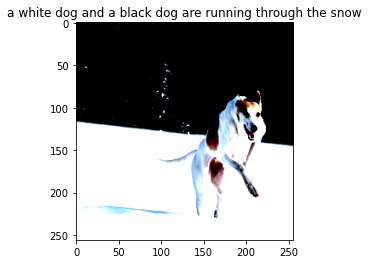

Original ['A', 'brown', 'and', 'white', 'dog', 'is', 'running', 'through', 'the', 'snow']
['a', 'man', 'skis', 'over', 'a', 'snowy', 'field']
['a', 'group', 'of', 'cross', '-', 'cross', '-', 'country', 'skiers', 'going', 'through', 'a', '<UNK>']
['a', 'man', 'skis', 'through', 'the', 'snow']
['the', 'man', 'in', 'the', 'blue', 'shirt', 'is', 'holding', 'the', 'hand', 'of', 'the', 'girl', 'in', 'the', 'white', 'dress']


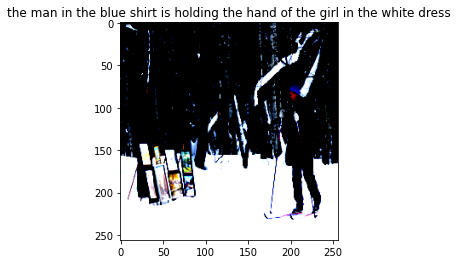

Original ['A', 'man', 'in', 'a', 'hat', 'is', 'displaying', 'pictures', 'next', 'to', 'a', 'skier', 'in', 'a', 'blue', 'hat']
['a', 'group', '<UNK>', 'climbing', 'a', 'cliff']
['a', 'group', 'of', 'people', 'climbing', 'a', 'cliff']
['a', 'group', 'of', 'people', 'are', 'rock', 'climbing']
['a', 'group', 'of', 'people', 'are', 'climbing', 'a', 'rock', 'climbing', 'wall']


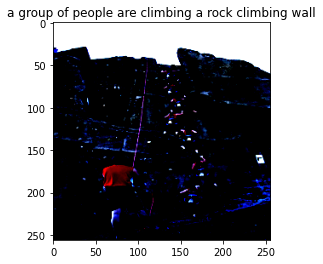

Original ['A', 'collage', 'of', 'one', 'person', 'climbing', 'a', 'cliff']
['two', 'yellow', 'dogs', 'are', 'jumping', 'up', 'to', 'catch', 'the', 'ball', 'in', 'the', 'grass', '.']
['two', 'brown', 'dogs', 'are', 'playing', 'with', 'a', 'ball', 'in', 'a', 'grassy', 'yard']
['a', 'dog', 'is', 'playing', 'with', 'a', 'hose', 'while', 'a', 'dog', 'watches']
['three', 'brown', 'dogs', 'play', 'in', 'a', 'fenced', 'yard']


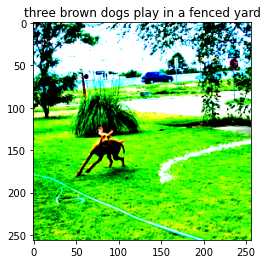

Original ['A', 'brown', 'dog', 'chases', 'the', 'water', 'from', 'a', 'sprinkler', 'on', 'a', 'lawn']
['two', 'white', 'dogs', 'are', 'playing', 'in', 'a', 'field', 'of', 'grass']
['a', 'white', 'and', 'brown', 'dog', 'is', 'running', 'in', 'the', 'grass']
['a', 'white', 'and', 'brown', 'dog', 'runs', 'through', 'a', 'field']
['a', 'white', 'and', 'brown', 'dog', 'is', 'playing', 'with', 'a', 'yellow', 'toy']


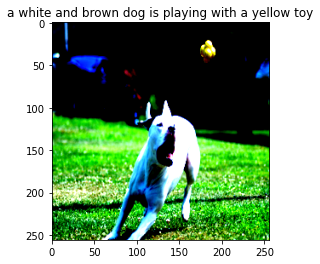

Original ['A', 'dog', 'prepares', 'to', 'catch', 'a', 'thrown', 'object', 'in', 'a', 'field', 'with', 'nearby', 'cars']
['a', 'white', 'dog', 'and', 'a', 'black', 'dog', 'playing', 'in', 'the', 'grass']
['a', 'yellow', 'dog', 'chases', 'a', 'ball']
['a', 'dog', 'chases', 'another', 'dog']
['a', 'white', 'dog', 'is', 'catching', 'a', 'yellow', 'ball', 'in', 'its', 'mouth']


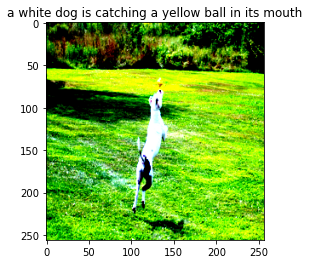

Original ['a', 'black', 'and', 'white', 'dog', 'jumping', 'in', 'the', 'air', 'to', 'get', 'a', 'toy']
['two', 'boys', 'are', 'playing', 'on', 'swings', 'in', 'a', 'lake', 'near', 'a']
['two', 'young', 'boys', 'play', 'with', 'a', 'sprinkler', 'in', 'the', 'water']
['two', 'young', 'boys', 'play', 'in', 'the', 'water']
['two', 'boys', 'play', 'on', 'a', 'lake']


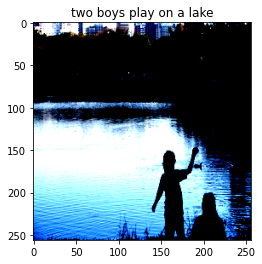

Original ['A', 'child', 'and', 'a', 'woman', 'are', 'at', 'waters', 'edge', 'in', 'a', 'big', 'city']
['a', 'woman', 'and', 'a', 'man', 'are', 'sitting', 'at', 'a', 'picnic', 'table', 'with', 'a', 'microphone']
['two', 'young', 'ladies', 'are', 'sitting', 'on', 'a', 'park', 'bench']
['two', 'women', 'are', 'standing', 'by', 'a', 'tree']
['a', 'woman', 'and', 'a', 'man', 'sitting', 'at', 'a', 'park', 'bench']


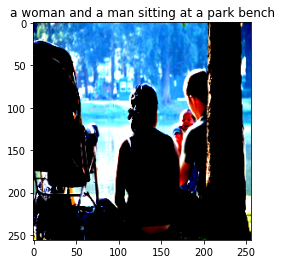

Original ['A', 'couple', 'and', 'an', 'infant', ',', 'being', 'held', 'by', 'the', 'male', ',', 'sitting', 'next', 'to', 'a', 'pond', 'with', 'a', 'near', 'by', 'stroller']
['a', 'wet', 'dog', 'running', 'in', 'the', 'surf']
['a', 'black', 'dog', 'running', 'through', 'the', 'water']
['a', 'black', 'dog', 'with', 'red', 'collar', 'running', 'through', 'the', 'water']
['two', 'black', 'dogs', 'running', 'through', 'the', 'water']


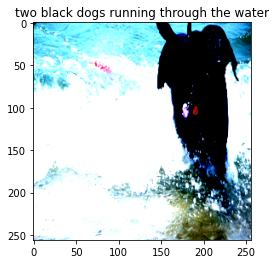

Original ['A', 'black', 'dog', 'running', 'in', 'the', 'surf']
['a', 'man', 'drilling', 'a', 'hole', 'into', 'the', 'ice']
['three', 'men', 'are', 'ice', 'fishing', 'in', 'a', 'boat']
['a', 'man', 'and', 'a', 'woman', 'on', 'a', 'dock']
['three', 'men', 'are', 'ice', 'fishing']


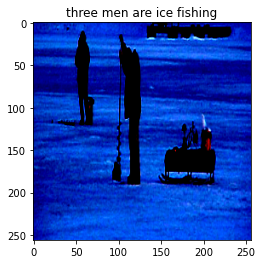

Original ['A', 'man', 'drilling', 'a', 'hole', 'in', 'the', 'ice']
['two', 'dogs', 'play', 'in', 'the', 'snow']
['two', 'brown', 'dogs', 'are', 'running', 'through', 'the', 'white', 'snow']
['two', 'brown', 'dogs', 'play', 'in', 'the', 'snow']
['a', 'brown', 'dog', 'and', 'a', 'black', 'dog', 'frolicking', 'on', 'the', 'beach']


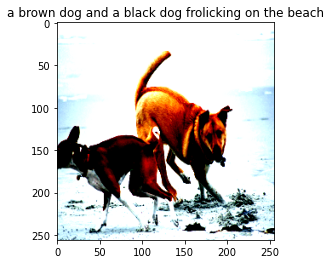

Original ['Two', 'different', 'breeds', 'of', 'brown', 'and', 'white', 'dogs', 'play', 'on', 'the', 'beach']
['a', 'man', 'in', 'a', 'red', 'jacket', 'is', 'snowboarding', 'over', 'a', 'white', 'bay']
['a', 'man', 'is', 'snowboarding', 'down', 'a', '<UNK>', 'of', 'ice', '.']
['a', 'man', 'is', 'snowboarding', 'down', 'a', 'snowy', 'slope']
['a', 'person', 'in', 'a', 'red', 'coat', 'is', 'snowboarding', 'down', 'a', 'snowy', 'mountain']


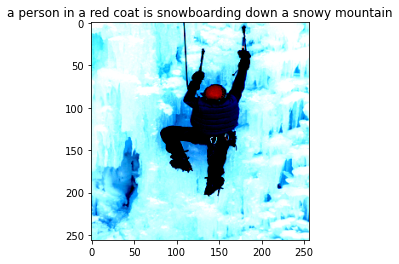

Original ['A', 'man', 'uses', 'ice', 'picks', 'and', 'crampons', 'to', 'scale', 'ice']
['a', 'black', 'dog', 'is', 'running', 'in', 'the', 'grass', '.']
['a', 'black', 'dog', 'jumps', 'in', 'a', 'field']
['a', 'black', 'dog', 'in', 'a', 'grassy']
['a', 'black', 'dog', 'is', 'running', 'through', 'a', 'grassy', 'field']


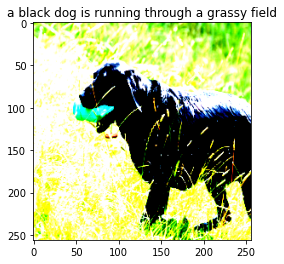

Original ['A', 'black', 'dog', 'carries', 'a', 'green', 'toy', 'in', 'his', 'mouth', 'as', 'he', 'walks', 'through', 'the', 'grass']
['a', 'man', 'and', 'woman', 'sitting', 'on', 'a', 'yellow', 'raft', 'in', 'the', 'water']
['a', 'man', 'and', 'a', 'little', 'girl', 'in', 'blue', 'life', 'jackets', 'are', 'rowing', 'a', 'yellow', 'canoe']
['a', 'man', 'in', 'a', 'blue', 'shirt', 'is', 'paddling', 'a', 'yellow', 'kayak']
['a', 'man', 'and', 'a', 'woman', 'are', 'sitting', 'on', 'a', 'yellow', 'kayak', 'in', 'the', 'water']


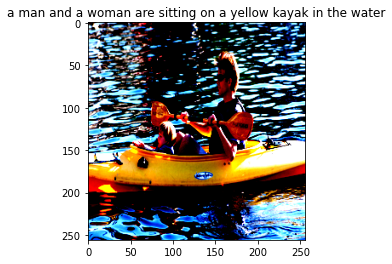

Original ['A', 'man', 'and', 'a', 'baby', 'are', 'in', 'a', 'yellow', 'kayak', 'on', 'water']
['two', 'dogs', 'are', 'running']
['three', 'dogs', 'are', 'playing', 'with', 'an', 'adult', 'on', 'a', 'paved', 'walkway']
['two', 'brown', 'dogs', 'are', 'running']
['two', 'dogs', 'are', 'running']


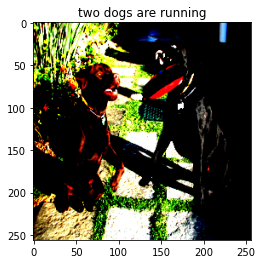

Original ['A', 'black', 'dog', 'and', 'a', 'brown', 'dog', 'are', 'jumping', 'up', 'to', 'catch', 'a', 'red', 'toy']
['two', 'young', 'children', 'playing', 'on', 'a', 'red', 'and', 'play']
['two', 'young', 'children', 'are', 'playing', 'on', 'a', 'red', 'and', 'red', 'ball']
['a', 'boy', 'in', 'a', 'red', 'shirt', 'is', 'pushing', 'a', 'red', 'soccer', 'ball']
['a', 'boy', 'in', 'a', 'red', 'and', 'white', 'uniform', 'stands', 'on', 'a', 'red', 'and', 'red', 'soccer', 'ball']


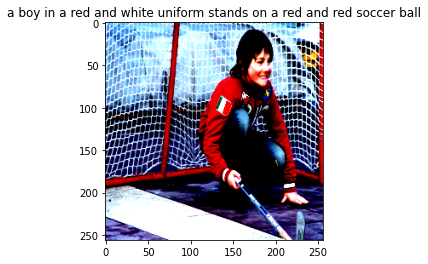

Original ['A', 'boy', 'with', 'a', 'stick', 'kneeling', 'in', 'front', 'of', 'a', 'goalie']
['a', 'man', 'sits', 'by', 'a', 'bench', 'on', 'a', 'bench', 'reading']
['two', 'men', 'are', 'sitting', 'on', 'a', 'bench', 'outside']
['a', 'man', 'sits', 'on', 'a', 'bench', 'in', 'front', 'of', 'a', 'building']
['a', 'man', 'sits', 'on', 'a', 'bench', 'near', 'a', 'building']


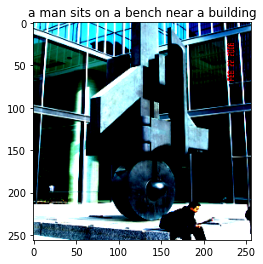

Original ['A', 'man', 'in', 'black', 'is', 'sitting', 'next', 'to', 'a', 'modern', 'art', 'structure', 'in', 'front', 'of', 'a', 'glass', 'building']
['two', 'people', 'are', 'standing', 'on', 'the', 'ice', 'looking', 'at', 'the', 'ocean', 'and', 'a', 'dog']
['three', 'men', 'are', 'standing', 'on', 'the', 'snow']
['three', 'people', 'on', 'a', 'sled', 'are', 'running', 'through', 'the', 'water']
['two', 'people', 'on', 'a', 'sled', 'walk', 'through', 'the', 'water']


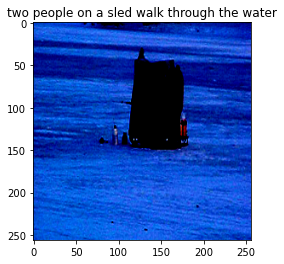

Original ['A', 'tent', 'is', 'being', 'set', 'up', 'on', 'the', 'ice']
['four', 'boys', 'in', 'a', 'field', 'of', 'grass', 'and', 'a', 'brown', 'and', 'white', 'dog']
['a', 'group', 'of', 'dogs', 'are', 'standing', 'on', 'the', 'grass']
['a', 'dog', 'and', 'two', 'black', 'dogs', 'in', 'the', 'grass']
['a', 'man', 'and', 'a', 'dog', 'are', 'playing', 'in', 'a', 'grassy', 'field']


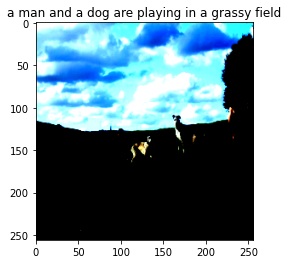

Original ['A', 'woman', 'crouches', 'near', 'three', 'dogs', 'in', 'a', 'field']
['a', 'man', 'stands', 'in', 'front', 'of', 'a', 'city']
['a', 'man', 'stands', 'in', 'the', 'city', 'near', 'a', 'city']
['a', 'man', 'stands', 'at', 'a', 'city']
['a', 'man', 'stands', 'next', 'to', 'a', 'building']


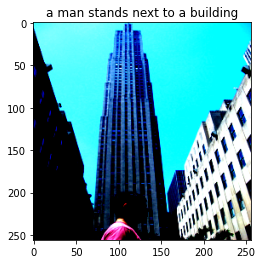

Original ['a', 'man', 'is', 'standing', 'in', 'front', 'of', 'a']
['a', 'boy', 'with', 'a', 'brown', 'and', 'white', 'guitar', 'eating', 'a', 'man', '.', '<PAD>']
['a', 'boy', 'in', 'a', 'red', 'shirt', 'eats', 'a', 'food', 'bottle', 'with', 'a', 'man']
['a', 'boy', 'in', 'a', 'red', 'shirt', 'eating', 'an', 'apple']
['young', 'girl', 'with', 'brown', 'hair', 'eating', 'eating']


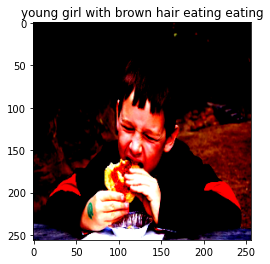

Original ['A', 'boy', 'bites', 'hard', 'into', 'a', 'treat', 'while', 'he', 'sits', 'outside']
['people', 'and', 'a', 'few', 'people', 'sitting', 'on', 'top', 'of', 'a', 'mountain']
['three', 'people', 'sit', 'on', 'a', 'rock', 'overlooking', 'a', 'scenic', 'valley', 'below', 'them']
['people', 'sitting', 'on', 'a', 'rock', 'overlooking', 'a', 'valley']
['three', 'people', 'are', 'sitting', 'on', 'a', 'hill', 'overlooking', 'a', 'valley']


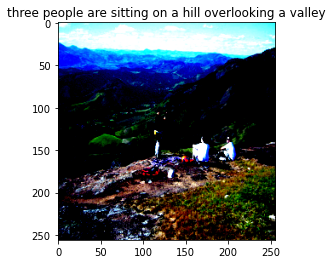

Original ['People', 'sit', 'on', 'the', 'mountainside', 'and', 'check', 'out', 'the', 'view']
['two', 'boys', 'are', 'playing', 'on', 'a', 'stage', 'in', 'a', 'pool']
['the', 'boy', 'in', 'the', 'yellow', 'shirt', 'is', 'watching', 'the', 'boy', 'in', 'the', 'air']
['a', 'boy', 'in', 'a', 'green', 'shirt', 'is', 'laying', 'on', 'the', 'floor', 'in', 'front', 'of', 'a', 'crowd', 'watching', 'people']
['the', 'boy', 'in', 'the', 'green', 'shirt', 'is', 'playing', 'with', 'a', 'crowd', 'in', 'the', 'city']


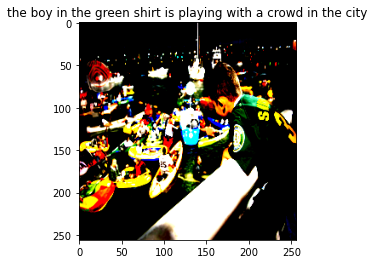

Original ['A', 'boy', 'in', 'a', 'green', 'shirt', 'is', 'looking', 'down', 'at', 'many', 'inflatable', 'boats']
['two', 'girls', 'are', 'posing', 'together', 'on', 'a', 'city', 'street']
['two', 'people', 'are', 'posing', 'for', 'a', 'picture']
['two', 'women', 'are', 'posing', 'for', 'a', 'photograph']
['two', 'girls', 'pose', 'for', 'a', 'picture', 'in', 'front', 'of', 'a', 'house']


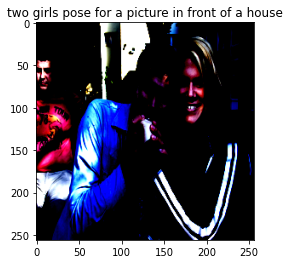

Original ['A', 'man', 'and', 'woman', 'pose', 'for', 'the', 'camera', 'while', 'another', 'man', 'looks', 'on']
['two', 'men', 'in', 'a', 'wrestling', 'area']
['a', 'group', 'of', 'people', 'sit', 'in', 'a', 'room']
['four', 'people', 'are', 'sitting', 'around', 'a', 'bonfire', 'at', 'a', 'table']
['a', 'group', 'of', 'people', 'are', 'sitting', 'around', 'a', 'table', 'at', 'a', 'meal']


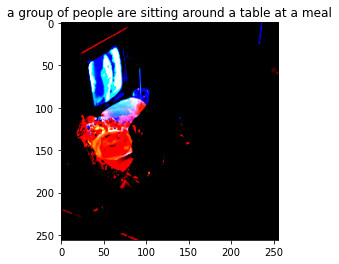

Original ['A', 'person', 'eats', 'takeout', 'while', 'watching', 'a', 'small', 'television']
['a', 'group', 'of', 'people', 'are', 'standing', 'on', 'a', 'ledge', 'overlooking', 'a', 'beach']
['a', 'bunch', 'of', 'people', 'on', 'a', 'beach']
['a', 'group', 'of', 'people', 'are', 'standing', 'on', 'a', 'ledge', 'on', 'a', 'beach']
['people', 'are', 'standing', 'on', 'a', 'beach', 'near', 'a', 'beach']


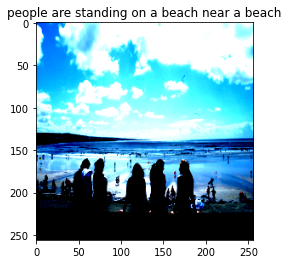

Original ['a', 'couple', 'of', 'several', 'people', 'sitting', 'on', 'a', 'ledge', 'overlooking', 'the']
['two', 'skateboarders', 'are', 'performing', 'a', 'trick', '.']
['a', 'boy', 'jumps', 'off', 'a', 'skateboard', 'while', 'another', 'man', 'watches']
['three', 'skateboarders', 'are', 'skateboarding']
['a', 'skateboarder', 'ollies', 'over', 'a', 'staircase']


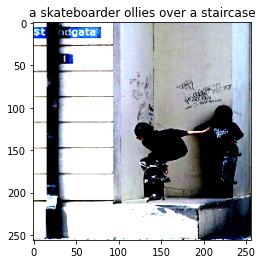

Original ['A', 'boy', 'takes', 'a', 'jump', 'on', 'his', 'skateboard', 'while', 'another', 'boy', 'with', 'a', 'skateboard', 'watches']
['a', 'woman', 'with', 'a', 'paddle', 'over', 'a', 'body', 'of', 'water']
['the', 'woman', 'with', 'the', 'red', 'shirt', 'is', 'sitting', 'in', 'the', 'water']
['a', 'girl', 'in', 'a', 'yellow', 'bathing', 'suit', 'looks', 'into', 'a', 'body', 'of', 'water']
['a', 'woman', 'with', 'a', 'paddle', 'in', 'the', 'boat']


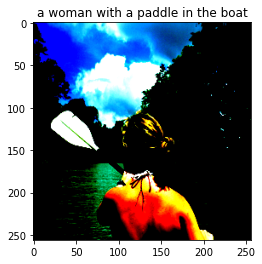

Original ['A', 'girl', 'paddling', 'down', 'a', 'large', 'river', ',', 'as', 'seen', 'from', 'behind', 'her']
['a', 'girl', 'is', 'diving', 'into', 'the', 'water']
['a', 'girl', 'in', 'a', 'pink', 'swimsuit', 'is', 'jumping', 'into', 'a', 'lake']
['a', 'young', 'girl', 'in', 'pigtails', 'is', 'playing', 'in', 'the', 'ocean']
['a', 'girl', 'in', 'pigtails', 'is', 'playing', 'in', 'the', 'ocean']


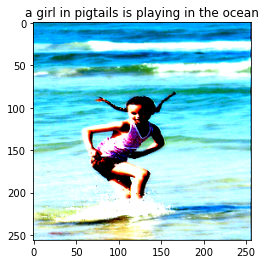

Original ['A', 'girl', 'in', 'pigtails', 'splashes', 'in', 'the', 'shallow', 'water']
['two', 'young', 'girls', 'are', 'sitting', 'on', 'a', 'couch', 'laughing', 'and', 'laughing', 'at', 'an', 'adult']
['two', 'young', 'girls', 'are', 'sitting', 'on', 'a', 'couch', 'laughing']
['two', 'little', 'girls', 'are', 'sitting', 'on', 'a', 'couch', 'laughing']
['two', 'little', 'girls', 'are', 'sitting', 'on', 'the', 'floor', 'in', 'the', 'middle', 'of', 'the', 'floor']


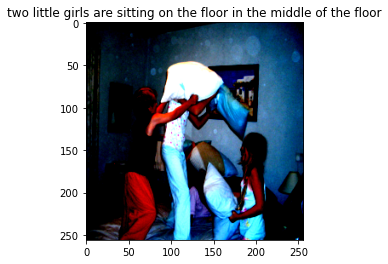

Original ['A', 'group', 'of', 'four', 'children', 'wearing', 'pajamas', 'have', 'a', 'pillow', 'fight']
['a', 'man', 'and', 'a', 'boy', 'are', 'standing', 'on', 'a', 'platform', 'and', 'looking', 'at', 'each', 'side']
['two', 'men', 'are', 'on', 'a', 'platform', 'in', 'the', 'air', 'on', 'a', 'bridge']
['a', 'man', 'and', 'a', 'woman', 'are', 'sitting', 'on', 'an', 'artificial', 'platform']
['two', 'construction', 'workers', 'are', 'sitting', 'at', 'an', 'outdoor', 'cafe']


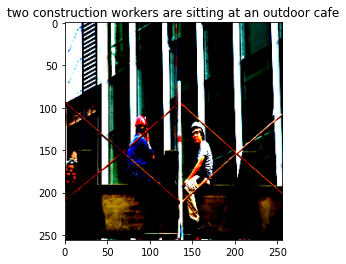

Original ['Two', 'constructions', 'workers', 'sit', 'on', 'a', 'beam', 'taking', 'a', 'break']
['two', 'boys', 'play', 'in', 'a', 'soccer', 'ball']
['two', 'boys', 'play', 'in', 'a', 'puddle']
['two', 'boys', 'play', 'in', 'the', 'water']
['three', 'boys', 'play', 'soccer', 'in', 'the', 'park']


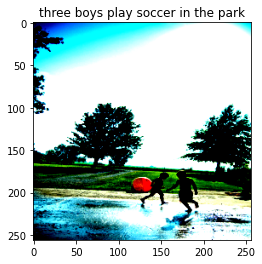

Original ['The', 'children', 'are', 'playing', 'in', 'the', 'water']
['a', 'girl', 'in', 'the', 'blue', 'dress', 'looks', 'at', 'a', 'woman', 'in', 'a', 'blue', 'dress']
['a', 'blond', 'haired', 'woman', 'in', 'a', 'blue', 'shirt', 'and', 'blue', 'jeans', 'is', 'looking', 'at', 'a', 'man', 'in', 'a', 'blue', 'shirt']
['the', 'woman', 'is', 'holding', 'a', 'blue', 'bag', 'while', 'a', 'man', 'looks', 'on']
['a', 'girl', 'in', 'a', 'blue', 'dress', 'is', 'looking', 'at', 'a', 'woman', 'in', 'a', 'blue', 'dress']


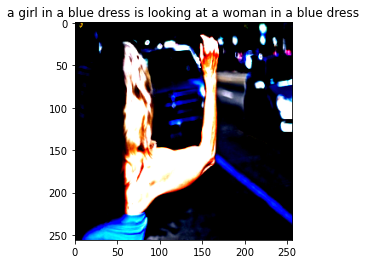

Original ['A', 'blond', 'woman', 'in', 'a', 'blue', 'shirt', 'appears', 'to', 'wait', 'for', 'a', 'ride']
['a', 'little', 'girl', 'in', 'a', 'blue', 'outfit', 'is', 'sitting', 'in', 'a', 'chair', 'outside', 'a', 'building']
['a', 'young', 'girl', 'sits', 'on', 'a', 'train', 'and', 'eats']
['a', 'young', 'girl', 'sits', 'on', 'a', 'table', 'and', 'eats', 'an', 'apple']
['a', 'young', 'girl', 'in', 'a', 'blue', 'shirt', 'sits', 'on', 'a', 'bench', 'and', 'eats', 'a', 'snack']


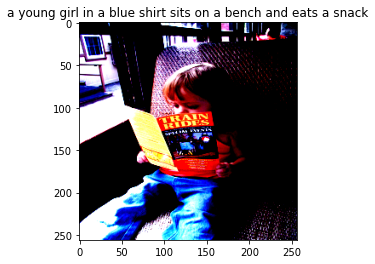

Original ['A', 'little', 'girl', 'looking', 'at', 'a', 'brochure', 'on', 'train']
['two', 'dogs', 'running', 'through', 'the', 'grass', 'near', 'a', 'body', 'of', 'water']
['three', 'dogs', 'running', 'in', 'the', 'grass']
['two', 'black', 'dogs', 'run', 'through', 'a', 'field']
['three', 'dogs', 'run', 'through', 'the', 'dry', 'grass']


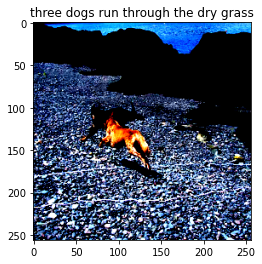

Original ['A', 'brown', 'dog', 'is', 'running', 'after', 'a', 'black', 'dog', 'on', 'a', 'rocky', 'shore']
['a', 'boy', 'is', 'jumping', 'into', 'a', 'pool', 'while', 'a', 'man', 'watches']
['three', 'people', 'are', 'wading', 'into', 'a', 'pool']
['two', 'people', 'are', 'wading', 'in', 'an', 'outdoor', 'pool']
['a', 'boy', 'jumps', 'into', 'a', 'swimming', 'pool']


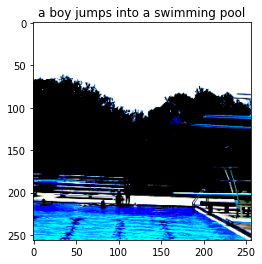

Original ['A', 'boy', 'descends', 'off', 'the', 'end', 'of', 'a', 'high', 'diving', 'board']
['a', 'man', 'in', 'a', 'suit', 'and', 'blue', 'jeans', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>']
['a', 'man', 'wearing', 'a', 'blue', 'shirt', 'is', 'standing', 'next', 'to', 'a', 'woman', 'in', 'a', 'blue', 'coat']
['a', 'man', 'stands', 'in', 'front', 'of', 'a', 'store', 'while', 'a', 'woman', 'walks', 'by']
['a', 'man', 'in', 'a', 'blue', 'shirt', 'and', 'blue', 'jeans', 'stands', 'in', 'front', 'of', 'a', 'building']


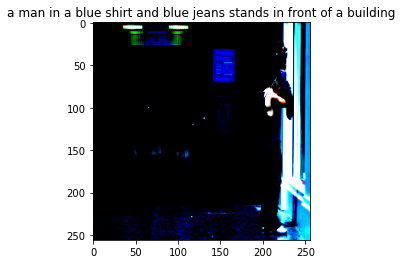

Original ['A', 'guy', 'stands', 'by', 'a', 'window', 'taking', 'his', 'overshirt', 'off']
['a', 'white', 'dog', 'is', 'jumping', 'up', 'a', 'low', 'to', 'the', 'beach']
['two', 'dogs', 'running', 'on', 'a', 'beach']
['a', 'white', 'dog', 'runs', 'along', 'the', 'beach']
['white', 'and', 'tan', 'dog', 'running', 'in', 'the']


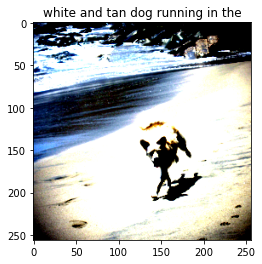

Original ['A', 'light-colored', 'dog', 'runs', 'on', 'the', 'beach']
['a', 'boy', 'in', 'a', 'swimsuit', 'jumps', 'into', 'the', 'water']
['boy', 'in', 'red', 'shirt', 'and', 'no', 'shirt', 'with', 'no', 'shirt', 'standing', 'on', 'a']
['a', 'boy', 'in', 'a', 'blue', 'shirt', 'is', 'doing', 'a', 'back', 'flip', 'in', 'the', 'water']
['a', 'boy', 'in', 'shorts', 'and', 'a', 't', '-', 'shirt', 'running', 'on', 'a', 'sandy', 'beach']


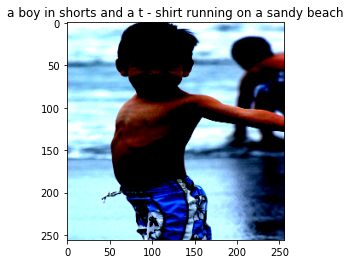

Original ['A', 'boy', 'in', 'his', 'blue', 'swim', 'shorts', 'at', 'the', 'beach']
['a', 'snowboarder', 'is', 'making', 'a', 'jump', 'over', 'a', 'snowy', 'hill']
['a', 'person', 'skiing', 'down', 'a', 'snowy', 'hill']
['two', 'people', 'are', 'skiing', 'down', 'a', 'snowy', 'hill']
['a', 'person', 'skiing', 'down', 'a', 'mountain']


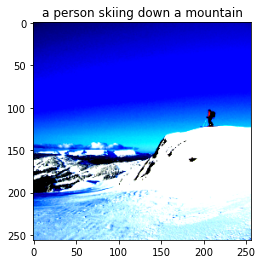

Original ['A', 'hiker', 'standing', 'high', 'on', 'a', 'bluff', 'overlooking', 'the', 'mountains', 'below']
['a', 'black', 'and', 'a', 'dog', 'in', 'the', 'grass', 'with', 'a', 'man', 'behind', 'them']
['a', 'black', 'dog', 'and', 'white', 'dog', 'with', 'a', 'green', 'toy']
['a', 'black', 'dog', 'and', 'a', 'white', 'dog', 'play', 'with', 'a', 'green']
['two', 'dogs', 'are', 'playing', 'with', 'a', 'green', 'toy']


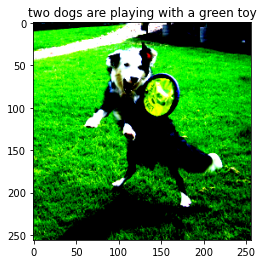

Original ['A', 'black', 'and', 'white', 'dog', 'is', 'attempting', 'to', 'catch', 'a', 'yellow', 'and', 'purple', 'object', 'in', 'a', 'low', 'cut', 'yard']
['a', 'man', 'in', 'a', 'blue', 'vest', 'is', 'sitting', 'in', 'a', '<UNK>', 'in', 'a', 'parking', 'lot', '.', '<PAD>']
['two', 'men', 'sit', 'on', 'a', 'bench', 'in', 'a', 'busy', 'city', 'street']
['two', 'people', 'are', 'sitting', 'on', 'a', 'bus', 'in', 'a', 'car']
['two', 'men', 'are', 'sitting', 'on', 'a', 'bus']


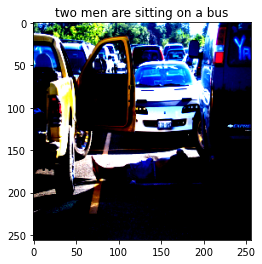

Original ['A', 'man', 'in', 'blue', 'shorts', 'is', 'laying', 'in', 'the', 'street']
['two', 'dogs', 'are', 'playing', 'in', 'the', 'sand']
['two', 'black', 'dogs', 'are', 'playing', 'in', 'the', 'snow']
['two', 'black', 'dogs', 'are', 'running', 'in', 'the', 'sand']
['three', 'dogs', 'are', 'playing', 'together', 'on', 'the', 'beach']


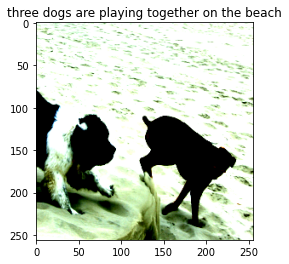

Original ['A', 'white', 'and', 'black', 'dog', 'and', 'a', 'brown', 'dog', 'in', 'sandy', 'terrain']
['a', 'dog', 'leaps', 'to', 'catch', 'a', 'ball', 'while', 'standing', 'on', 'the', 'grass', 'field']
['a', 'dog', 'leaps', 'to', 'catch', 'a', 'ball']
['a', 'dog', 'catches', 'a', 'ball', 'in', 'the', 'air']
['two', 'dogs', 'are', 'playing', 'in', 'a', 'field']


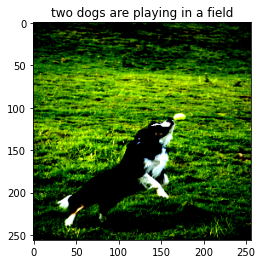

Original ['A', 'black', 'and', 'white', 'dog', 'catches', 'a', 'toy', 'in', 'midair']
['a', 'crowd', 'of', 'people', 'watching', 'fireworks']
['a', 'crowd', 'of', 'hot', 'balloons', 'is', 'at', 'a', 'fire']
['a', 'crowd', 'of', 'hot', 'air', 'balloons', 'at', 'night']
['many', 'people', 'are', 'watching', 'fireworks']


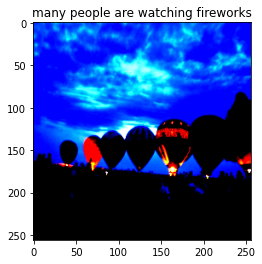

Original ['A', 'crowd', 'watching', 'air', 'balloons', 'at', 'night']
['a', 'boy', 'on', 'a', 'bike', 'is', 'riding', 'on', 'a', 'bike']
['a', 'little', 'boy', 'rides', 'a', 'bike', 'on', 'a', 'dirt', 'bike']
['a', 'little', 'boy', 'rides', 'a', 'bike', 'on', 'a', 'dirt', 'road', 'while', 'wearing', 'a', 'white', 'helmet', 'and', 'red', 'beads']
['a', 'boy', 'in', 'a', 'helmet', 'riding', 'a', 'bike']


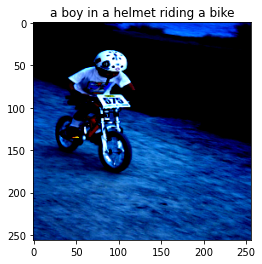

Original ['A', 'child', 'with', 'a', 'helmet', 'on', 'his', 'head', 'rides', 'a', 'bike']
['a', 'crowd', 'watches', 'people', 'at', 'a', 'bar']
['a', 'crowd', 'of', 'people', 'at', 'a', 'bar', 'on', 'a', 'busy', 'street']
['a', 'crowd', 'of', 'people', 'at', 'an', 'outdoor', 'event']
['a', 'group', 'of', 'people', 'sit', 'around', 'a', 'table', 'at', 'night']


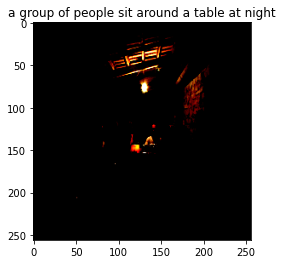

Original ['A', 'group', 'of', 'eight', 'people', 'are', 'gathered', 'around', 'a', 'table', 'at', 'night']
['a', 'man', 'and', 'two', 'boys', 'play', 'on', 'a', 'sand', 'beach']
['a', 'man', 'and', 'a', 'dog', 'are', 'jumping', 'in', 'the', 'air', 'on', 'a', 'beach']
['a', 'man', 'jumps', 'into', 'the', 'air', 'while', 'playing', 'a', 'soccer', 'ball']
['two', 'men', 'are', 'playing', 'on', 'a', 'beach']


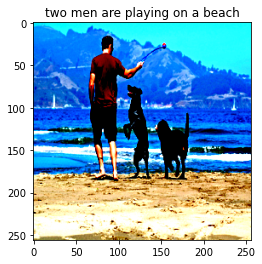

Original ['A', 'man', 'in', 'a', 'brown', 'shirt', 'and', 'dark', 'shorts', 'plays', 'on', 'the', 'beach', 'with', 'his', 'two', 'black', 'dogs']
['two', 'children', 'play', 'in', 'the', 'water']
['two', 'children', 'playing', 'in', 'a', 'mud', 'puddle']
['a', 'boy', 'covered', 'in', 'suds', 'is', 'being', 'splashed', 'by', 'a', 'water', 'gun']
['a', 'little', 'boy', 'in', 'a', 'white', 'shirt', 'is', 'splashing', 'in', 'the', 'bathtub', 'with', 'a', 'red', 'ring']


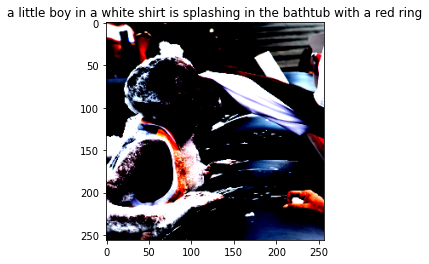

Original ['a', 'boy', 'cleans', 'the', 'bubbles', 'off', 'his', 'face']
['a', 'girl', 'in', 'blue', 'shorts', 'is', 'sliding', 'down', 'a', 'slide']
['a', 'girl', 'in', 'a', 'bikini', 'is', 'diving', 'off', 'a', 'water', 'slide']
['a', 'boy', 'in', 'a', 'blue', 'shirt', 'slides', 'down', 'a', 'slide', 'into', 'a', 'paddling', 'pool']
['a', 'little', 'girl', 'is', 'sliding', 'down', 'a', 'water', 'slide']


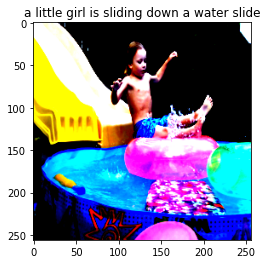

Original ['A', 'boy', 'in', 'blue', 'shorts', 'slides', 'down', 'a', 'slide', 'into', 'a', 'pool']
['two', 'men', 'in', 'swim', 'trunks', 'are', 'jumping', 'into', 'a', 'pool', 'with', 'a', 'blue', 'tarp', 'behind', 'them']
['two', 'young', 'men', 'are', 'jumping', 'into', 'a', 'pool']
['two', 'young', 'men', 'are', 'jumping', 'into', 'the', 'air', 'in', 'the', 'middle', 'of', 'a', 'boat']
['a', 'boy', 'in', 'a', 'blue', 'wetsuit', 'is', 'jumping', 'into', 'the', 'water']


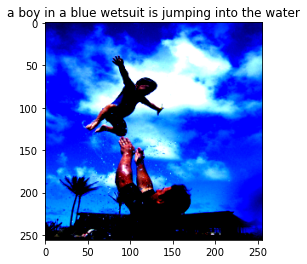

Original ['A', 'man', 'in', 'a', 'wetsuit', 'is', 'throwing', 'a', 'baby', 'wearing', 'a', 'wetsuit', 'up', 'into', 'the', 'air']
['two', 'young', 'boys', 'are', 'posing', 'for', 'a', 'picture']
['a', 'boy', 'and', 'a', 'girl', 'posing', 'for', 'a', 'photo']
['two', 'young', 'girls', 'are', 'smiling', 'and', 'laughing']
['three', 'boys', 'pose', 'for', 'a', 'picture', 'together']


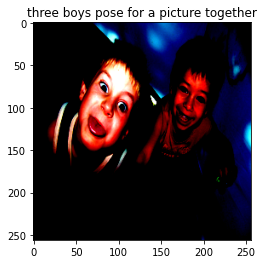

Original ['A', 'little', 'boy', 'sticks', 'his', 'tongue', 'out', 'for', 'the', 'camera', '.', 'Another', 'boy', 'looks', 'on']
['a', 'man', 'and', 'a', 'woman', 'are', 'looking', 'at', 'the', '<UNK>', 'at', 'a', 'fire']
['a', 'man', 'and', 'a', 'girl', 'are', 'standing', 'in', 'front', 'of', 'a', 'camel']
['a', 'man', 'and', 'a', 'woman', 'are', 'at', 'an', 'outdoor', 'fire']
['a', 'man', 'and', 'woman', 'are', 'looking', 'at', 'a', 'fire']


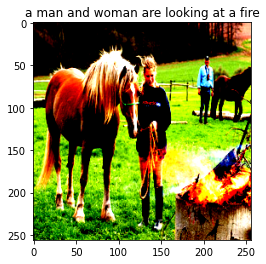

Original ['A', 'blonde', 'horse', 'and', 'a', 'blonde', 'girl', 'in', 'a', 'black', 'sweatshirt', 'are', 'staring', 'at', 'a', 'fire', 'in', 'a', 'barrel']
['a', 'brown', 'dog', 'and', 'a', 'black', 'dog', 'in', 'a']
['two', 'dogs', 'are', 'standing', 'on', 'the', 'dirt', 'road']
['a', 'dog', 'looking', 'at', 'a', 'woman']
['a', 'brown', 'and', 'white', 'dog', 'is', 'looking', 'at', 'a', 'brown', 'cow']


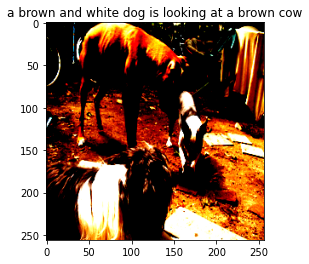

Original ['A', 'bulldog', ',', 'a', 'sheep', 'dog', ',', 'and', 'a', 'boxer', 'standing', 'in', 'a', 'yard']
['a', 'man', 'and', 'a', 'woman', 'sit', 'on', 'a', 'bench', 'in', 'a', 'city']
['a', 'woman', 'in', 'a', 'blue', 'shirt', 'and', 'a', 'man', 'in', 'a', 'blue', 'life', 'vest', 'sit', 'on', 'the', 'back', 'of', 'a', 'fountain']
['three', 'boys', 'are', 'on', 'a', '<UNK>', 'boat']
['a', 'woman', 'and', 'a', 'man', 'sit', 'on', 'a', 'dock']


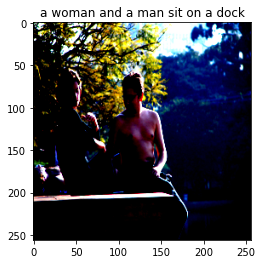

Original ['A', 'lady', 'and', 'a', 'man', 'with', 'no', 'shirt', 'sit', 'on', 'a', 'dock']
['dog', 'with', 'its', 'tongue', 'out']
['the', 'white', 'dog', 'is', 'looking', 'at', 'the', 'camera']
['a', 'dog', 'is', 'standing', 'on', 'the', 'pavement', 'with', 'a', 'tennis', 'ball']
['a', 'dog', 'is', 'standing', 'on', 'its', 'hind', 'legs']


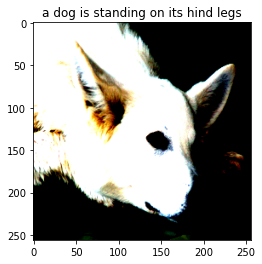

Original ['A', 'closeup', 'of', 'a', 'white', 'dog', 'that', 'is', 'laying', 'its', 'head', 'on', 'its', 'paws']
['two', 'girls', 'are', 'jumping', 'on', 'a', 'trampoline']
['a', 'man', 'and', 'woman', 'sit', 'on', 'the', 'ground', 'playing', 'a', 'game']
['two', 'girls', 'dance', 'on', 'a', 'stage']
['two', 'girls', 'are', 'wrestling', 'on', 'the', 'beach']


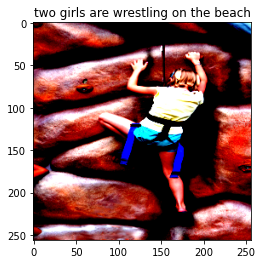

Original ['a', 'woman', 'in', 'a', 'yellow', 'shirt', 'and', 'green', 'shorts', 'is', 'climbing', 'an', 'artificial', 'red', 'wall', 'whilst', 'wearing', 'a', 'safety', 'harness']
['two', 'girls', 'are', 'jumping', 'into', 'a', 'pool', 'while', 'two', 'other', 'people', 'are', 'on', 'the', 'same']
['a', 'boy', 'in', 'a', 'yellow', 'shirt', 'is', 'paddling', 'a', 'child', 'in', 'a', 'pool']
['two', 'girls', 'are', 'jumping', 'into', 'a', 'pool']
['two', 'girls', 'jumping', 'into', 'a', 'pool']


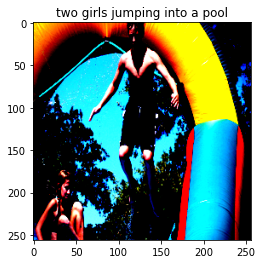

Original ['A', 'boy', 'is', 'jumping', 'on', 'an', 'inflatable', 'ring', 'and', 'a', 'girl', 'is', 'watching']
['a', 'family', 'sits', 'in', 'a', 'park', 'bench', 'while', 'the', 'man', 'sits', 'on', 'the', 'bench']
['three', 'people', 'are', 'sitting', 'on', 'a', 'bench', 'on', 'the', 'beach']
['a', 'group', 'of', 'people', 'sit', 'on', 'a', 'bench', 'overlooking', 'the', 'water']
['a', 'man', 'and', 'woman', 'sit', 'on', 'a', 'bench', 'in', 'a', 'field']


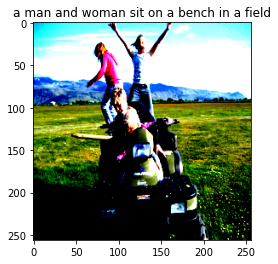

Original ['A', 'family', 'playing', 'on', 'a', 'tractor', 'on', 'a', 'beautiful']
['a', 'girl', 'in', 'bright', 'red', 'and', 'blue', 'is', 'kicking', 'a', 'ball']
['a', 'woman', 'in', 'a', 'red', 'skirt', 'and', 'blue', 'jeans', 'walks', 'down', 'the', 'street']
['the', 'woman', 'in', 'the', 'red', 'skirt', 'and', 'hat', 'walks', 'down', 'the', 'street']
['the', 'woman', 'in', 'the', 'salmon', 'colored', 'bikini', 'is', 'walking', 'down', 'the', 'street']


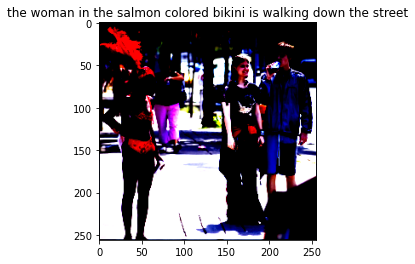

Original ['A', 'woman', 'in', 'a', 'red', 'costume', 'to', 'the', 'left', 'of', 'a', 'man', 'and', 'woman', 'standing', 'together']
['two', 'women', 'are', 'walking', 'on', 'a', 'snow', 'slope', 'while', 'their', 'friend', 'takes', 'a']
['two', 'women', 'are', 'walking', 'down', 'the', 'street', 'in', 'winter']
['a', 'group', 'of', 'skiers', 'pulling', 'a', 'sled']
['a', 'man', 'and', 'a', 'woman', 'are', 'walking', 'in', 'the', 'snow']


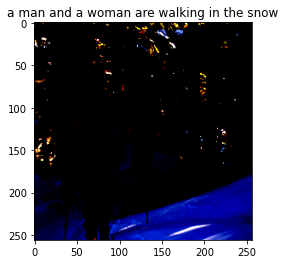

Original ['Skiiers', 'walking', 'up', 'the', 'hill', 'through', 'a', 'forest']
['a', 'man', 'is', 'skiing', 'down', 'a', 'hill']
['a', 'skier', 'is', 'going', 'down', 'a', 'hill']
['two', 'people', 'are', 'walking', 'on', 'a', 'snowy', 'slope']
['the', 'skier', 'is', 'coming', 'down', 'a', 'snowy', 'hill']


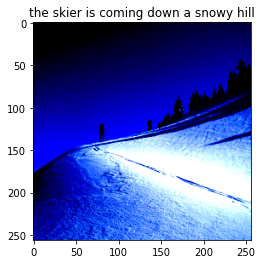

Original ['A', 'lone', 'skier', 'is', 'making', 'their', 'way', 'up', 'a', 'mountain']
['brown', 'dog', 'runs', 'through', 'the', 'field']
['a', 'brown', 'dog', 'is', 'running', 'along', 'a', 'dirt', 'path']
['a', 'brown', 'dog', 'is', 'running', 'across', 'the', 'grass']
['the', 'brown', 'dog', 'is', 'running', 'through', 'the', 'grass']


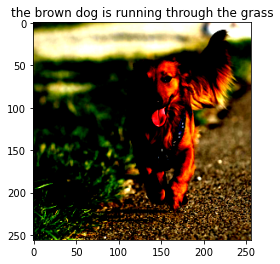

Original ['a', 'brown', 'dog', 'running', 'down', 'a', 'paved']
['three', 'men', 'in', 'orange', 'vests', 'play', 'basketball', 'on', 'a', 'city', '.']
['a', 'group', 'of', 'people', 'stand', 'around', 'in', 'an', 'urban', 'area']
['a', 'group', 'of', 'people', 'stand', 'around', 'a', 'basketball', 'court']
['several', 'people', 'are', 'walking', 'down', 'a', 'city', 'street', 'at', 'night']


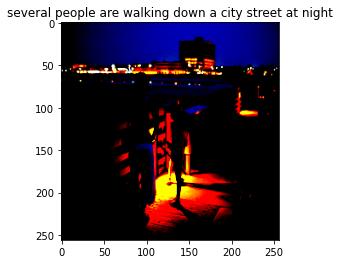

Original ['A', 'mother', 'and', 'children', 'is', 'fishing', 'on', 'a', 'boardwalk', 'at', 'night']
['a', 'woman', 'and', 'her', 'dog', 'are', 'walking', 'on', 'a', 'path', 'near', 'snow']
['two', 'brown', 'dogs', 'play', 'on', 'the', 'snow']
['a', 'woman', 'and', 'a', 'dog', 'stand', 'on', 'the', 'beach']
['a', 'woman', 'and', 'a', 'dog', 'on', 'a']


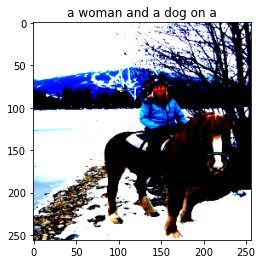

Original ['A', 'woman', 'dressed', 'in', 'a', 'blue', 'jacket', 'and', 'blue', 'jeans', 'rides', 'a', 'brown', 'horse', 'near', 'a', 'frozen', 'lake', 'and', 'snow-covered', 'mountain']
['two', 'women', 'pet', 'a', 'camel', 'in', 'a', 'rodeo']
['a', 'woman', 'and', 'a', 'woman', 'walk', 'with', 'a', 'small', 'dog']
['the', 'woman', 'in', 'the', 'blue', 'dress', 'is', 'pulling', 'a', 'man', 'in', 'a', 'brown', 'coat']
['a', 'woman', 'in', 'a', 'cowboy', 'hat', 'and', 'a', 'brown', 'dog', 'in', 'front', 'of', 'a', 'brown', 'dog']


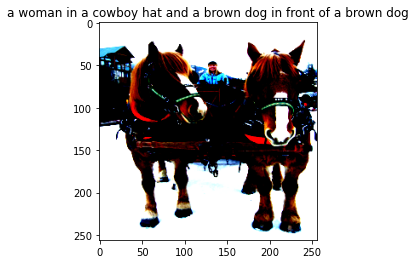

Original ['Two', 'draft', 'horses', 'pull', 'a', 'cart', 'through', 'the', 'snow']
['a', 'person', 'wearing', 'a', 'red', 'hat', 'climbs', 'a', 'steep', 'rock']
['two', 'people', 'climbing', 'a', 'rope']
['a', 'person', 'wearing', 'a', 'red', 'backpack', 'climbs', 'a', 'steep', 'rock']
['two', 'people', 'are', 'climbing', 'a', 'rock']


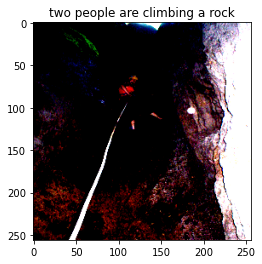

Original ['A', 'person', 'climbing', 'down', 'a', 'sheer', 'rock', 'cliff', 'using', 'a']
['three', 'young', 'people', 'are', 'standing', 'in', 'a', 'woodland']
['three', 'people', 'are', 'sitting', 'on', 'a', 'rock', 'wall']
['three', 'people', 'are', 'sitting', 'on', 'a', 'stone', 'wall', 'and', 'a', 'man', 'in', 'winter']
['a', 'group', 'of', 'people', 'sit', 'on', 'the', 'ground', 'in', 'the', 'woods']


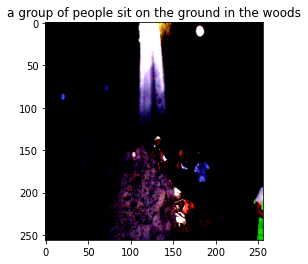

Original ['People', 'stand', 'inside', 'a', 'rock', 'dome']
['a', 'group', 'lies', 'on', 'rocky', 'terrain']
['a', 'group', 'of', 'people', 'sit', 'on', 'the', 'ground', ',', 'a', 'rock', 'in', 'the', 'background']
['several', 'hikers', 'are', 'sitting', 'on', 'a', 'mountain', 'overlooking', 'the', 'mountains']
['a', 'crowd', 'of', 'people', 'sit', 'on', 'a', 'mountain']


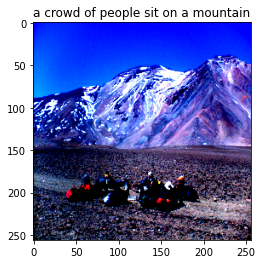

Original ['a', 'group', 'of', 'backpackers', 'lay', 'on', 'the', 'dry', 'ground']
['a', 'family', 'poses', 'for', 'a', 'picture', 'on', 'a', 'concrete', 'wall']
['a', 'woman', 'and', 'a', 'boy', 'posing', 'for', 'a', 'photo', 'on', 'a', 'concrete', 'wall', 'in', 'front', 'of', 'a', 'small', 'building']
['a', 'family', 'stands', 'in', 'the', 'middle', 'of', 'a', 'bunch', 'of', 'people', 'in', 'the', 'snow']
['a', 'man', 'and', 'a', 'woman', 'pose', 'for', 'a', 'picture', 'on', 'a', 'cement', 'platform']


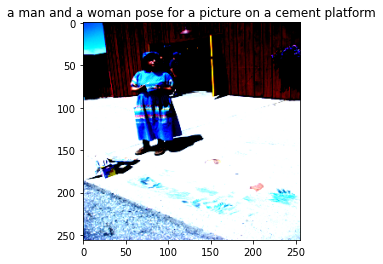

Original ['A', 'woman', 'in', 'a', 'blue', 'dress', 'stands', 'with', 'a', 'chalk', 'portrait', 'of', 'two', 'children', 'playing', 'by', 'a', 'stream']
['a', 'dog', 'runs', 'through', 'the', 'snow']
['a', 'dog', 'runs', 'in', 'the', 'snow']
['a', 'brown', 'and', 'white', 'dog', 'running', 'in', 'the', 'snow']
['a', 'dog', 'running', 'through', 'the', 'snow']


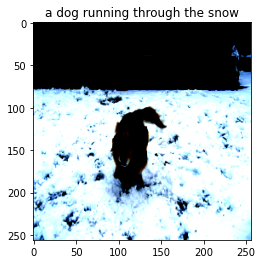

Original ['A', 'brown', 'dog', 'plays', 'in', 'a', 'deep', 'pile', 'of', 'snow']
['two', 'children', 'playing', 'in', 'a']
['two', 'children', 'playing', 'in', 'the', 'fountains']
['two', 'children', 'are', 'playing', 'in', 'a', 'water', 'fountain']
['two', 'boys', 'play', 'in', 'a', 'fountain']


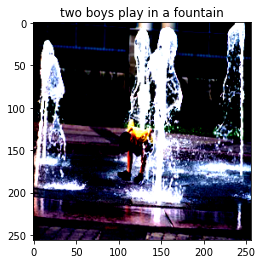

Original ['A', 'boy', 'jumping', 'in', 'a', 'fountain']
['two', 'dogs', 'are', 'running', 'around', 'a', 'corner']
['two', 'dogs', 'are', 'running', 'around', 'a', 'corner']
['a', 'small', 'dog', 'and', 'a', 'smaller', 'dog']
['a', 'black', 'and', 'brown', 'dog', 'is', 'running', 'through', 'a', 'cow', 'tunnel']


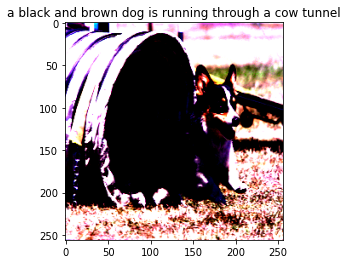

Original ['A', 'Corgi', 'runs', 'out', 'of', 'a', 'tunnel']
['two', 'dogs', 'running', 'around', 'in', 'the']
['two', 'brown', 'dogs', 'running', 'on', 'a', 'dirt', 'path']
['two', 'dogs', 'running', 'in', 'the', 'dirt']
['two', 'dogs', 'run', 'along', 'a', 'gravel', 'road']


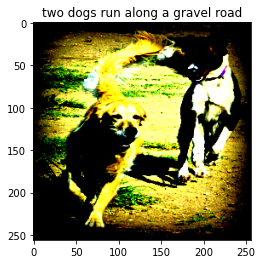

Original ['A', 'blond', 'dog', 'and', 'a', 'black', 'and', 'white', 'dog', 'run', 'in', 'a', 'dirt', 'field']
['a', 'girl', 'in', 'a', 'blue', 'shirt', 'and', 'jeans', 'is', 'walking', 'along', 'a', 'wooden', 'boardwalk', 'on', 'the', 'beach']
['a', 'girl', 'in', 'blue', 'shorts', 'and', 'a', 'white', 't', '-', 'shirt', 'is', 'standing', 'on', 'the', 'beach', 'next', 'to', 'a', 'pool']
['a', 'girl', 'in', 'a', 'blue', 'shirt', 'and', 'jeans', 'is', 'walking', 'along', 'a', 'boardwalk', 'on', 'the', 'beach']
['a', 'girl', 'in', 'a', 'blue', 'shirt', 'and', 'blue', 'shorts', 'is', 'walking', 'along', 'a', 'railroad', 'track']


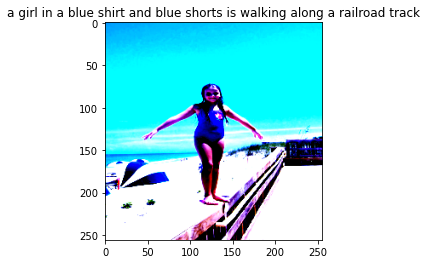

Original ['A', 'little', 'girl', 'in', 'a', 'blue', 'swimsuit', 'is', 'walking', 'along', 'a', 'wooden', 'fence', 'next', 'to', 'a', 'sandy', 'beach']
['two', 'dogs', 'are', 'playing', 'in', 'a', 'pool']
['a', 'black', 'and', 'white', 'dog', 'is', 'splashing', 'in', 'a', 'pool']
['a', 'black', 'and', 'brown', 'dog', 'is', 'splashing', 'in', 'the', 'water']
['a', 'black', 'and', 'tan', 'dog', 'is', 'splashing', 'in', 'the', 'water']


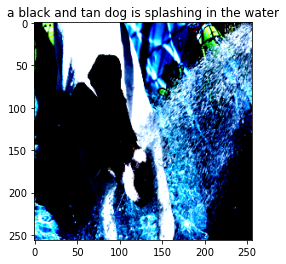

Original ['A', 'black', 'and', 'white', 'dog', 'drinking', 'water', 'from', 'a', 'water', 'spray']
['the', 'young', 'child', 'is', 'swimming', 'underwater', 'in', 'a', 'pool']
['a', 'boy', 'is', 'smiling', 'underwater', 'in', 'a', 'pool']
['a', 'boy', 'smiles', 'underwater']
['a', 'young', 'boy', 'swimming', 'underwater', 'in', 'a', 'pool']


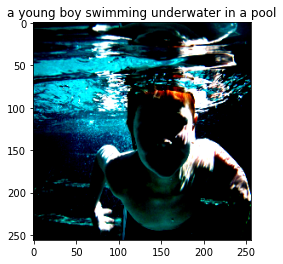

Original ['a', 'boy', 'smiles', 'underwater']
['a', 'young', 'boy', 'wearing', 'a', 'blue', 'shirt', 'and', 'a', 'red', 'shirt', 'playing', 'with', 'a', 'toy']
['a', 'little', 'boy', 'in', 'a', 'red', 'shirt', 'and', 'a', 'girl', 'in', 'his', 'lap', 'are', 'sitting', 'on', 'a', 'wall', 'with', 'a', 'baby']
['a', 'little', 'boy', 'in', 'a', 'red', 'shirt', 'is', 'playing', 'with', 'a', 'green', 'toy']
['the', 'boy', 'wearing', 'a', 'red', 'shirt', 'is', 'standing', 'in', 'the', 'sand']


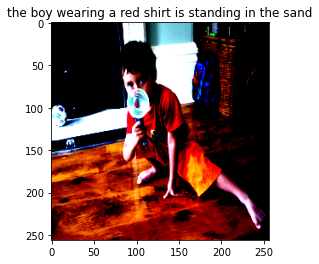

Original ['A', 'boy', 'with', 'a', 'toy', 'gun']
['a', 'boy', 'in', 'a', 'blue', 'jacket', 'is', 'jumping', 'on', 'a', 'rock']
['a', 'boy', 'in', 'a', 'blue', 'jacket', 'is', 'standing', 'on', 'top', 'of', 'a', 'cliff']
['a', 'boy', 'stands', 'on', 'a', 'cliff']
['a', 'boy', 'jumps', 'off', 'of', 'a', 'cliff']


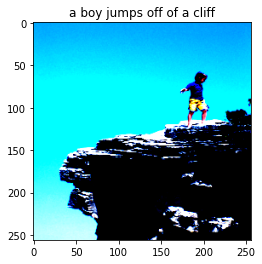

Original ['A', 'boy', 'in', 'yellow', 'shorts', 'is', 'standing', 'on', 'top', 'of', 'a', 'cliff']
['a', 'group', 'of', 'men', 'on', 'a', 'ski', 'lift']
['two', 'people', 'on', 'a', 'bike', 'jumping', 'through', 'a', 'forest']
['two', 'people', 'on', 'a', 'bike', 'jumping', 'over', 'a', 'forest']
['three', 'people', 'in', 'the', 'air', 'on', 'a', 'mountain']


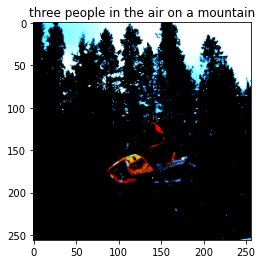

Original ['A', 'person', 'on', 'a', 'snowmobile', 'in', 'mid', 'jump']
['three', 'people', 'are', 'riding', 'a', 'yellow', 'motorcycle']
['three', 'people', 'on', 'a', 'motorcycle']
['three', 'people', 'in', 'helmets', 'are', 'on', 'a', 'sled']
['a', 'group', 'of', 'people', 'in', 'helmets', 'are', 'pulling', 'a', 'sled']


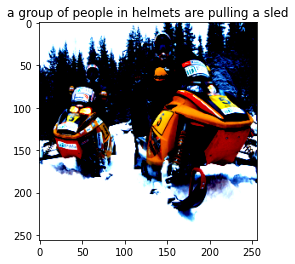

Original ['People', 'are', 'riding', 'around', 'on', 'snowmobiles']
['two', 'men', 'on', 'motorcycles', 'with', 'a', 'man', 'in', 'the', 'foreground']
['three', 'people', 'on', 'a', 'motorcycle']
['two', 'people', 'ride', 'their', 'four', 'wheelers']
['two', 'people', 'ride', 'their', 'four', 'wheelers']


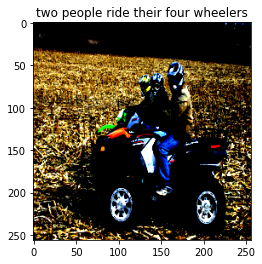

Original ['Three', 'people', 'drive', 'ATVs']
['two', 'people', 'riding', 'their', 'bikes', 'on', 'the', 'side', 'of', 'a', 'road']
['a', 'four', 'wheeler', 'jumping', 'through', 'a', 'field']
['a', 'four', 'wheeler', 'jumping', 'in', 'a', 'field']
['man', 'riding', 'four', '-', 'wheeled', 'vehicle', 'through', 'a', 'field']


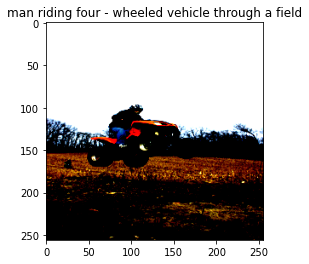

Original ['A', 'four', 'wheeler', 'jumping', 'in', 'an', 'empty', 'field']
['a', 'man', 'is', 'performing', 'a', 'stunt', 'in', 'midair', 'while', 'another', 'man', 'watches']
['a', 'man', 'is', 'performing', 'a', 'stunt', 'in', 'midair', 'while', 'other', 'people', 'sit', 'and', 'watch']
['a', 'man', 'is', 'performing', 'a', 'stunt', 'in', 'midair']
['a', 'man', 'on', 'a', 'bicycle', 'in']


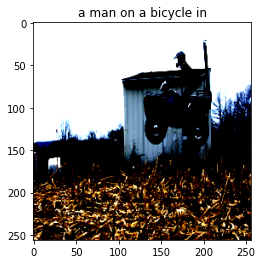

Original ['A', 'man', 'jumps', 'gin', 'the', 'air', 'while', 'riding', 'an']
['a', 'boy', 'in', 'a', 'striped', 't', '-', 'shirt', 'jumps', 'in', 'a', 'pile', 'of', 'water']
['two', 'girls', 'are', 'jumping', 'into', 'a', 'fountain']
['a', 'little', 'boy', 'in', 'a', 'striped', 'shirt', 'is', 'jumping', 'into', 'the', 'air']
['a', 'boy', 'jumps', 'into', 'the', 'air', 'while', 'another', 'watches']


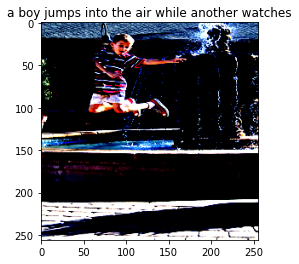

Original ['A', 'boy', 'in', 's', 'striped', 'shirt', 'is', 'jumping', 'in', 'front', 'of', 'a', 'water', 'fountain']
['a', 'boy', 'in', 'a', 'blue', 'shirt', 'is', 'playing', 'with', 'an', 'orange', 'ball']
['a', 'boy', 'in', 'a', 'blue', 'shirt', 'kicks', 'a', 'soccer']
['the', 'boy', 'is', 'running', 'through', 'a', 'field']
['a', 'little', 'boy', 'in', 'a', 'blue', 'shirt', 'is', 'kicking', 'a', 'ball']


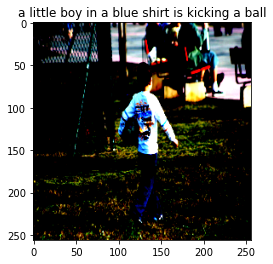

Original ['A', 'boy', 'carrying', 'a', 'soccer', 'ball']
['two', 'children', 'in', 'a', 'white', 't', '-', 'shirt', 'are', 'playing', 'with', 'a', 'large', 'blue', 'ball']
['a', 'young', 'boy', 'wearing', 'a', 'blue', 'shirt', 'is', 'holding', 'a', 'box', 'of', 'a', 'stuffed', 'animal']
['a', 'little', 'boy', 'in', 'blue', 'and', 'a', 'white', 't', '-', 'shirt', 'is', 'standing', 'in', 'front', 'of', 'a', 'statue']
['two', 'young', 'boys', 'are', 'posing', 'for', 'a', 'picture', 'on', 'a', 'wood', 'floor']


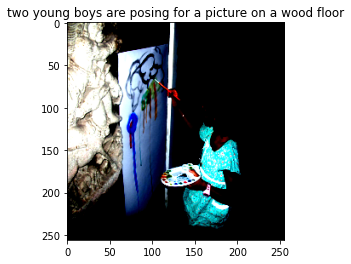

Original ['A', 'child', 'painting', 'a', 'picture']
['a', 'man', 'in', 'aerodynamic', 'gear', 'riding', 'a', 'bike', 'down', 'a', 'road']
['man', 'and', 'woman', 'riding', 'bicycles', 'on', 'paved', 'road', 'near', 'a', 'body', 'of', 'water']
['a', 'man', 'riding', 'a', 'bicycle', 'on', 'a', 'city', 'street']
['a', 'man', 'in', 'aerodynamic', 'gear', 'riding', 'a', 'bike', 'down', 'the', 'street']


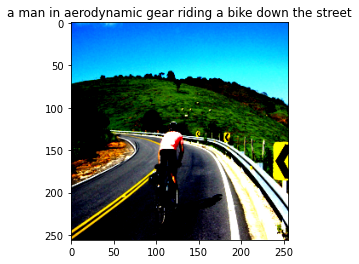

Original ['A', 'cyclist', 'is', 'riding', 'a', 'bicycle', 'on', 'a', 'curved', 'road', 'up', 'a', 'hill']
['the', 'black', 'and', 'brown', 'dog', 'is', 'jumping', 'over', 'to', 'catch', 'a', 'toy']
['a', 'black', 'dog', 'and', 'a', 'small', 'black', 'dog', 'playing', 'with', 'a', 'toy']
['a', 'large', 'black', 'dog', 'is', 'jumping', 'in', 'the', 'air', 'while', 'a', 'black', 'dog', 'watches']
['a', 'black', 'dog', 'playing', 'fetch', 'with', 'an', 'orange', 'ball']


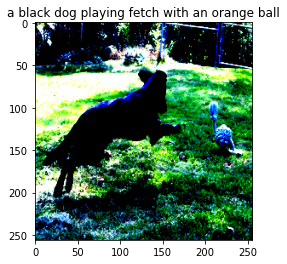

Original ['a', 'black', 'dog', 'jumping', 'to', 'catch', 'a', 'rope']
['a', 'girl', 'with', 'a', '<UNK>', 'on', 'her', 'face', 'smiles', 'at', 'a', 'fair']
['a', 'girl', 'in', 'a', 'white', 'shirt', 'is', 'holding', 'a', 'video', 'camera', 'and', 'another', 'girl', 'is', 'smiling']
['a', 'little', 'girl', 'with', 'her', 'arm', 'around', 'her', 'neck', 'to', 'her', 'mouth', 'while', 'a', 'man', 'in', 'the', 'background']
['a', 'girl', 'with', 'a', 'ponytail', 'on', 'a', 'swing']


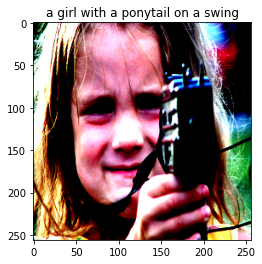

Original ['A', 'little', 'girl', 'is', 'holding', 'a', 'cine', 'camera', 'in', 'front', 'of', 'her', 'face']
['a', 'dog', 'jumps', 'up', 'to', 'catch', 'a', 'ball', 'while', 'people', 'watch']
['a', 'brown', 'dog', 'leaps', 'over', 'to', 'catch', 'a', 'ball', 'while', 'a', 'crowd', 'watches']
['a', 'dog', 'jumps', 'to', 'catch', 'a', 'frisbee']
['a', 'dog', 'catches', 'a', 'ball', 'while', 'a', 'crowd', 'watches']


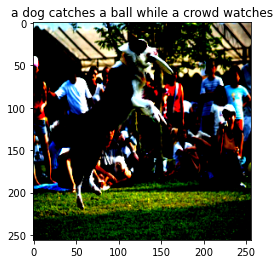

Original ['A', 'black', 'and', 'white', 'Border', 'Collie', 'catches', 'a', 'Frisbee', 'in', 'front', 'of', 'an', 'audience']
['a', 'baby', 'sits', 'on', 'a', 'pile', 'in', 'front', 'outside', 'of', 'a', 'large', 'pile', 'of', 'leaves']
['a', 'baby', 'sits', 'on', 'a', 'pile', 'of', 'birds']
['a', 'baby', 'is', 'sitting', 'on', 'a', 'pile', 'of', 'rocks']
['a', 'little', 'boy', 'in', 'a', 'red', 't', '-', 'shirt', 'is', 'sitting', 'on', 'a', 'pile', 'of', 'rocks', 'near', 'a', 'beach']


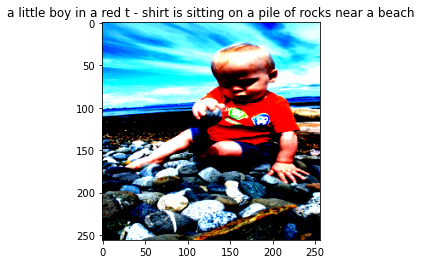

Original ['A', 'baby', 'is', 'sitting', 'on', 'and', 'playing', 'with', 'smooth', 'rocks']
['the', 'man', 'is', 'rock', 'climbing', 'on', 'a', 'mountain']
['a', 'man', 'is', 'rock', 'climbing']
['a', 'man', 'in', 'red', 'shorts', 'is', 'standing', 'on', 'top', 'of', 'a', 'cliff']
['a', 'man', 'wearing', 'a', 'white', 'shirt', 'and', 'blue', 'shorts', 'is', 'climbing', 'a', 'rock']


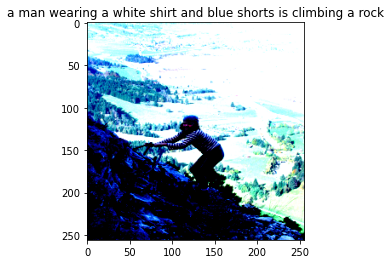

Original ['A', 'kid', 'rock', 'climbing', 'against', 'the', 'backdrop', 'of', 'a', 'green']
['two', 'men', 'climbing', 'a', 'rock']
['two', 'men', 'climb', 'a', 'cliff']
['a', 'man', 'climbing', 'a', 'rock']
['two', 'people', 'climbing', 'a', 'rock']


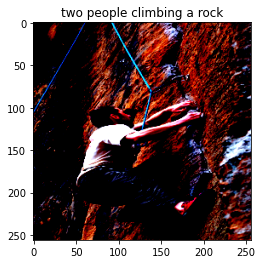

Original ['A', 'man', 'climbing', 'a', 'rock']
['the', 'man', 'in', 'a', 'red', 'hat', 'is', 'riding', 'a', 'bicycle']
['a', 'man', 'is', 'helping', 'a', 'young', 'boy', 'how', 'to', 'push', 'his', 'bike']
['a', 'man', 'wearing', 'blue', 'and', 'a', 'helmet', 'is', 'on', 'a', 'bike']
['a', 'woman', 'wearing', 'a', 'blue', 'helmet', 'is', 'riding', 'a', 'bike', 'on', 'the', 'street']


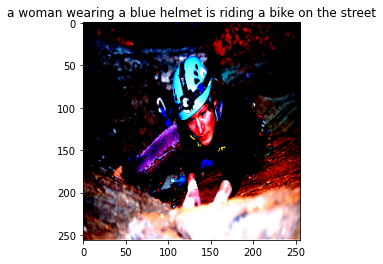

Original ['A', 'climber', 'wearing', 'a', 'blue', 'helmet', 'and', 'headlamp', 'is', 'attached', 'to', 'a', 'rope', 'on', 'the', 'rock', 'face']
['a', 'woman', 'in', 'black', 'is', 'holding', 'the', 'hand', 'of', 'a', 'man', 'and', 'a', 'dog']
['a', 'woman', 'with', 'a', 'mohawk', 'is', 'looking', 'at', 'a', 'black', 'dog']
['a', 'woman', 'is', 'petting', 'a', 'black', 'dog']
['a', 'woman', 'takes', 'a', 'picture', 'of', 'a', 'small', 'girl']


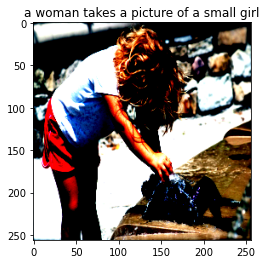

Original ['A', 'child', 'playing', 'with', 'a', 'fountain', 'at', 'the', 'beach']
['a', 'dog', 'is', 'jumping', 'over', 'the', 'sand']
['a', 'dog', 'is', 'running', 'along', 'the', 'side', 'of', 'the', 'ocean']
['a', 'group', 'of', 'people', 'on', 'a', 'beach']
['a', 'dog', 'is', 'running', 'along', 'a', 'beach']


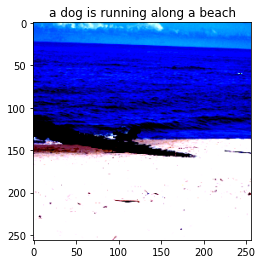

Original ['A', 'black', 'dog', 'is', 'jumping', 'over', 'a', 'log', 'along', 'a', 'beach']
['a', 'black', 'and', 'tan', 'dog', 'is', 'playing', 'with', 'a', 'toy', 'in', 'the', 'sand']
['a', 'man', 'in', 'a', 'black', 'and', 'long', 'sleeved', 'sleeve', 'shirt', 'has', 'his', 'hand', 'on', 'his', 'arm', 'in', 'the', 'air', 'while', 'sitting', 'on', 'the', 'sand']
['a', 'black', 'and', 'white', 'bird', 'with', 'a', '<UNK>', 'in', 'his', 'mouth', 'is', 'sitting', 'on', 'a', 'man']
['a', 'black', 'bird', 'with', 'his', 'eyes', 'closed', 'and', 'a', 'man', 'in', 'the', 'black', 'shirt', 'is', 'sitting', 'on', 'the', 'pavement']


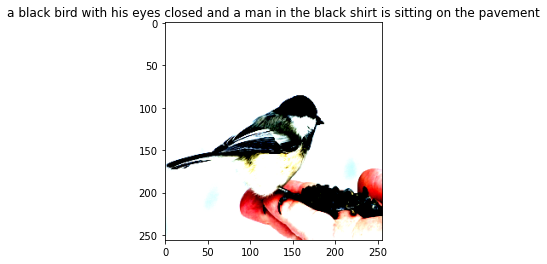

Original ['A', 'black', 'and', 'white', 'bird', 'eating', 'seeds', 'out', 'of', 'someone', "'s"]
['two', 'brown', 'dogs', 'playing', 'in', 'a', 'field']
['a', 'dog', 'is', 'playing', 'with', 'the', 'sand', 'in', 'the', 'sandy', 'sand']
['a', 'dog', 'is', 'playing', 'in', 'the', 'sand']
['a', 'brown', 'dog', 'plays', 'with', 'a', 'smaller', 'dog']


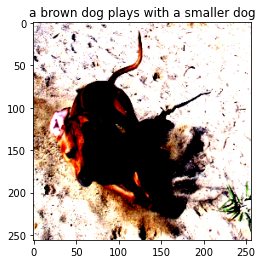

Original ['A', 'brown', 'dog', 'is', 'running', 'in', 'the', 'sand']
['a', 'little', 'boy', 'in', 'a', 'diaper', 'is', 'holding', 'onto', 'a', 'child', 'that', 'is', 'coming', 'in', 'the', 'water']
['a', 'little', 'boy', 'is', 'splashing', 'in', 'the', 'ocean']
['a', 'young', 'boy', 'plays', 'in', 'the', 'sand', 'at', 'a', 'beach']
['the', 'boy', 'is', 'swimming', 'in', 'the', 'pool']


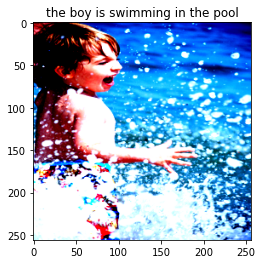

Original ['A', 'little', 'boy', 'stands', 'in', 'the', 'surf']
['a', 'little', 'dog', 'chases', 'a', 'small', 'ball', 'through', 'the', 'grass']
['two', 'small', 'dogs', 'playing', 'in', 'the', 'grass']
['a', 'little', 'dog', 'is', 'running', 'through', 'the', 'grass']
['a', 'dog', 'is', 'running', 'through', 'the', 'grass']


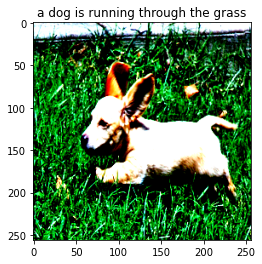

Original ['A', 'little', 'tan', 'dog', 'with', 'large', 'ears', 'running', 'through', 'the', 'grass']
['black', 'dog', 'with', 'mouth', 'open', 'running', 'in', 'a', 'grassy', 'field']
['the', 'black', 'and', 'brown', 'dog', 'is', 'running', 'through', 'a', 'field']
['two', 'dogs', 'are', 'running', 'through', 'a', 'field']
['a', 'dog', 'and', 'a', 'black', 'dog', 'running', 'in', 'a', 'field']


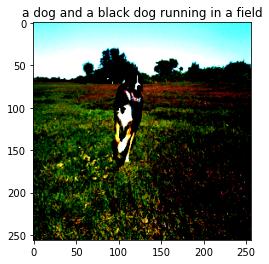

Original ['A', 'black', 'and', 'white', 'dog', 'is', 'running', 'through', 'the', 'field']
['the', 'girl', 'is', 'swimming', 'in', 'a', 'pool']
['a', 'little', 'girl', 'swimming', 'in', 'a', 'pool']
['the', 'little', 'girl', 'is', 'swimming', 'in', 'a', 'pool', 'of', 'water']
['a', 'girl', 'swimming', 'in', 'a', 'pool']


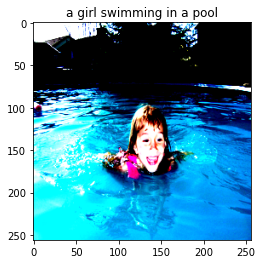

Original ['A', 'girl', 'in', 'a', 'pink', 'swimsuit', 'in', 'a']
['a', 'girl', 'jumping', 'into', 'a', 'puddle', 'of', 'water', '.', 'boy']
['a', 'girl', 'in', 'a', 'bikini', 'jumping', 'into', 'a', 'pool']
['a', 'little', 'girl', 'jumps', 'off', 'a', 'diving', 'board', 'into', 'a', 'pool']
['a', 'girl', 'is', 'jumping', 'on', 'a', 'bed']


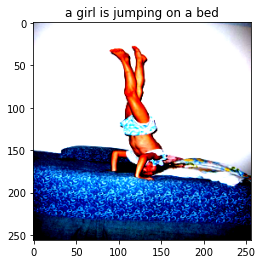

Original ['A', 'child', 'is', 'standing', 'on', 'her', 'head']
['a', 'boy', 'in', 'a', 'blue', 'shirt', 'is', 'running', 'in', 'the', 'sand']
['man', 'in', 'shorts', ',', 'holding', 'a', 'box', 'in', 'the', 'air']
['a', 'man', 'in', 'a', 'white', 'shirt', 'is', 'holding', 'a', 'small', 'white', 'dog', 'into', 'the', 'sand']
['a', 'boy', 'stands', 'in', 'the', 'sand']


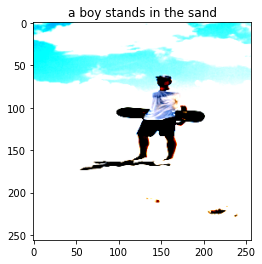

Original ['A', 'guy', 'stands', 'in', 'the', 'sand', 'with', 'a', 'snowboard', 'behind', 'him']
['three', 'people', 'are', 'riding', 'a', 'brown', 'atv', 'down', 'a', 'dirt', 'path', 'through', 'the', 'woods', 'and', 'trees']
['three', 'people', 'are', 'on', 'a', 'dirt', 'road', 'in', 'a', 'field']
['three', 'people', 'are', 'walking', 'down', 'a', 'dirt', 'road', 'in', 'front', 'of', 'a', 'forest']
['three', 'people', 'ride', 'their', 'bikes', 'down', 'a', 'dirt', 'path']


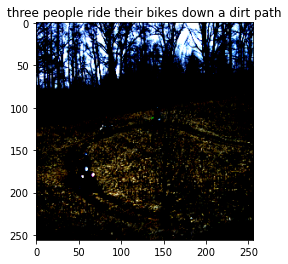

Original ['People', 'on', 'ATVs', 'and', 'dirt', 'bikes', 'are', 'traveling', 'along', 'a', 'worn', 'path', 'in', 'a', 'field', 'surrounded', 'by', 'trees']
['a', 'boy', 'in', 'pajamas', 'holds', 'a', 'drink', 'in', 'a', 'microphone']
['a', 'boy', 'in', 'a', 'white', 't', '-', 'shirt', 'holds', 'a', 'flag']
['a', 'little', 'boy', 'in', 'pajamas', 'is', 'playing', 'with', 'a', 'man', 'in', 'an', 'orange', 'shirt']
['a', 'little', 'girl', 'holds', 'a', 'picture', 'of', 'a', 'baby']


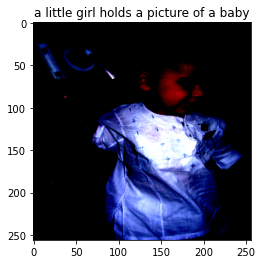

Original ['A', 'baby', 'in', 'a', 'white', 'garment', 'holds', 'a', 'flag', 'with', 'crescent', 'moon', 'and', 'star']
['a', 'man', 'in', 'a', 'blue', 'shirt', 'is', 'pushing', 'a', 'man', 'in', 'a', 'park', 'bench']
['a', 'man', 'wearing', 'a', 'blue', 'shirt', 'is', 'riding', 'a', 'bike', 'while', 'a', 'man', 'sits', 'on', 'the', 'ground']
['a', 'man', 'and', 'a', 'woman', 'are', 'sitting', 'on', 'a', 'park', 'bench']
['the', 'boy', 'in', 'the', 'blue', 'shirt', 'and', 'jeans', 'is', 'sitting', 'on', 'a', 'wooden', 'fence']


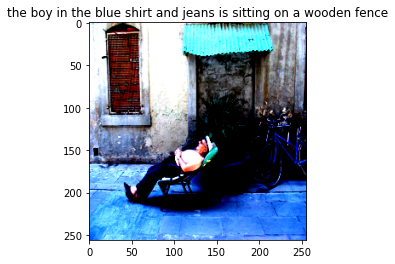

Original ['A', 'half', 'naked', 'man', 'is', 'sleeping', 'on', 'his', 'chair', 'outdoors']
['three', 'brown', 'dogs', 'are', 'playing', 'in', 'the', 'water']
['four', 'dogs', 'are', 'playing', 'in', 'the', 'water']
['three', 'dogs', 'running', 'through', 'the', 'water', 'with', 'a', 'ball', 'in', 'their', 'mouths']
['two', 'dogs', 'run', 'through', 'the', 'water']


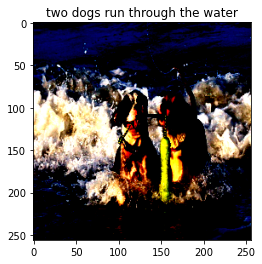

Original ['A', 'brown', 'and', 'white', 'and', 'a', 'black', 'and', 'white', 'dog', 'hauling', 'in', 'a', 'floating', 'toy', 'from', 'the', 'ocean']
['three', 'girls', 'are', 'posing', 'for', 'a', 'picture']
['three', 'girls', 'are', 'posing', 'with', 'a', 'girl', 'and', 'a', 'woman']
['two', 'young', 'women', 'are', 'posing', 'for', 'a', 'picture', 'in', 'front', 'of', 'a', 'crowd']
['three', 'girls', 'are', 'posing', 'for', 'a', 'picture']


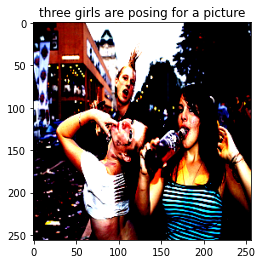

Original ['There', 'are', 'three', 'young', 'people', ',', 'one', 'dark', 'haired', 'holding', 'a', 'bottled', 'drink', ',', 'one', 'with', 'head', 'tilted', 'back', 'and', 'finger', 'in', 'her', 'mouth', ',', 'and', 'one', 'with', 'spiked', 'hair']
['a', 'brown', 'dog', 'is', 'running', 'in', 'the', 'water']
['a', 'brown', 'dog', 'with', 'a', 'toy', 'in', 'mouth', 'of', 'a', 'lake']
['a', 'brown', 'dog', 'is', 'splashing', 'in', 'a', 'stream']
['brown', 'dog', 'running', 'through', 'water', 'with', 'a', 'ball', 'in', 'its', 'mouth']


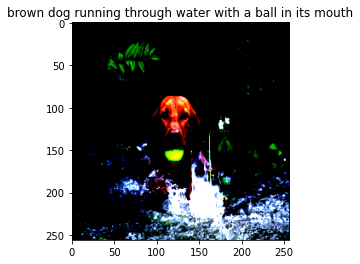

Original ['A', 'brown', 'dog', 'is', 'running', 'through', 'neck-deep', 'water', 'carrying', 'a', 'tennis', 'ball']
['two', 'dogs', 'are', 'playing', 'in', 'a', 'river', 'while', 'a', 'man', 'looks']
['two', 'dogs', 'are', 'playing', 'in', 'a', 'river']
['two', 'brown', 'dogs', 'run', 'through', 'the', 'water']
['two', 'large', 'brown', 'dogs', 'run', 'through', 'the', 'water']


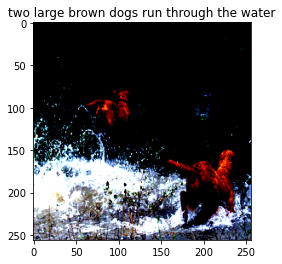

Original ['Two', 'brown', 'dogs', 'are', 'creating', 'large', 'splashes', 'as', 'they', 'run', 'in', 'a', 'river']
['two', 'dogs', 'running', 'on', 'the', 'beach']
['three', 'dogs', 'running', 'on', 'the', 'beach']
['two', 'dogs', 'running', 'on', 'the', 'shore']
['two', 'dogs', 'are', 'running', 'on', 'the', 'beach']


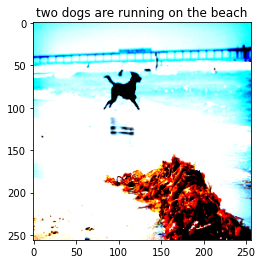

Original ['A', 'black', 'dog', 'runs', 'into', 'the', 'ocean', 'next', 'to', 'a', 'pile', 'of', 'seaweed']
['a', 'boy', 'in', 'white', 'runs', 'through', 'a', 'parking', 'lot']
['a', 'young', 'boy', 'runs', 'along', 'a', 'brick', 'road']
['the', 'little', 'boy', 'is', 'wearing', 'a', 'black', 't', '-', 'shirt']
['the', 'boy', 'is', 'wearing', 'a', 'black', 't', '-', 'shirt']


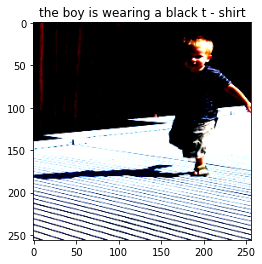

Original ['A', 'young', 'boy', 'runs', 'while', 'wearing', 'sandals']
['the', 'brown', 'dog', 'is', 'running', 'in', 'the', 'water']
['a', 'brown', 'and', 'white', 'dog', 'with', 'his', 'mouth', 'open', 'in', 'the', 'water']
['the', 'dog', 'is', 'running', 'through', 'the', 'water']
['a', 'furry', 'brown', 'dog', 'is', 'standing', 'in', 'the', 'water']


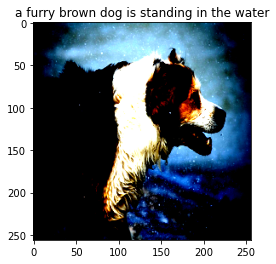

Original ['A', 'brown', 'and', 'white', 'dog', 'stands', 'outside', 'while', 'it', 'snows']
['three', 'people', 'sit', 'on', 'a', 'bench', 'in', 'front', '<UNK>', 'a']
['two', 'people', 'sitting', 'on', 'benches', 'in', 'a', 'city', 'park']
['two', 'people', 'sit', 'on', 'a', 'bench']
['two', 'people', 'sit', 'on', 'a', 'park', 'bench']


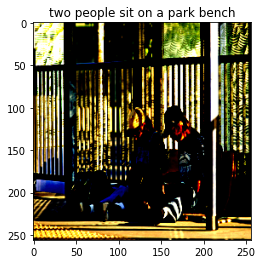

Original ['Two', 'men', 'are', 'sitting', 'on', 'the', 'ground', 'and', 'going', 'through', 'their', 'backpacks']
['two', 'boys', 'jumping', 'up', 'in', 'the', 'air', 'on', 'a', 'room']
['a', 'boy', 'in', 'a', 'blue', 'shirt', 'is', 'jumping', 'in', 'the', 'air', 'on', 'a', 'bed']
['a', 'little', 'boy', 'jumps', 'on', 'the', 'bed']
['a', 'boy', 'jumps', 'in', 'the', 'air']


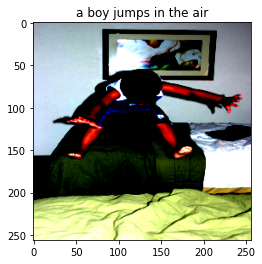

Original ['A', 'boy', 'is', 'jumping', 'on', 'a', 'bed']
['two', 'young', 'boys', 'are', 'standing', 'on', 'a', 'bed', 'with', 'a', 'pillow']
['a', 'boy', 'in', 'a', 'yellow', 'shirt', 'and', 'jeans', 'is', 'walking', 'a', 'man', 'in', 'a', 'yellow', 'jacket', 'while', 'a', 'woman', 'in', 'a', 'blue', 'shirt', 'looks', 'on']
['a', 'boy', 'and', 'a', 'little', 'girl', 'are', 'standing', 'on', 'a', 'cement', 'platform']
['a', 'boy', 'and', 'a', 'little', 'girl', 'in', 'a', 'bounce', 'house']


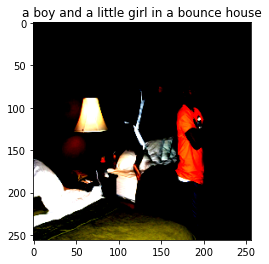

Original ['A', 'child', 'leaping', 'from', 'bed', 'to', 'bed', 'behind', 'the', 'back', 'of', 'a', 'man']
['two', 'people', 'are', 'sitting', 'on', 'a', 'boat', 'on', 'the', 'beach']
['a', 'boy', 'and', 'a', 'girl', 'in', 'the', 'snow']
['a', 'boy', 'in', 'a', 'blue', 'wetsuit', 'is', 'riding', 'a', 'sled']
['a', 'boy', 'in', 'a', 'blue', 'wetsuit', 'is', 'riding', 'a', 'sled']


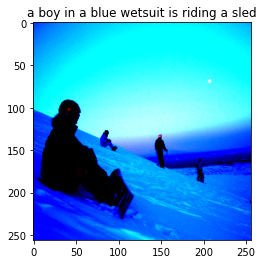

Original ['A', 'snowboarder', 'sits', 'on', 'a', 'slope', 'with', 'skiers', 'and', 'boarders', 'nearby']
['two', 'young', 'boys', 'are', 'standing', 'in', 'front', 'of', 'a', 'building']
['two', 'boys', 'are', 'standing', 'in', 'front', 'of', 'a', 'building']
['two', 'boys', 'are', 'standing', 'in', 'front', 'of', 'stores']
['a', 'man', 'and', 'a', 'woman', 'walk', 'along', 'a', 'sidewalk']


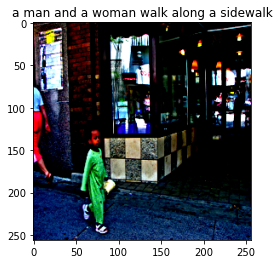

Original ['A', 'girl', 'in', 'green', 'walks', 'down', 'a', 'city', 'street']
['two', 'young', 'children', 'looking', 'at', 'a', 'blue', 'car']
['a', 'boy', 'and', 'girl', 'are', 'sitting', 'on', 'the', 'ground', 'watching', 'a', 'girl']
['two', 'young', 'boys', 'are', 'posing', 'for', 'a', 'picture', 'on', 'a', 'platform']
['a', 'little', 'girl', 'in', 'a', 'red', 'shirt', 'is', 'sitting', 'on', 'a', 'man', "'s", 'shoulders', 'with', 'a', 'child', 'in', 'the', 'background']


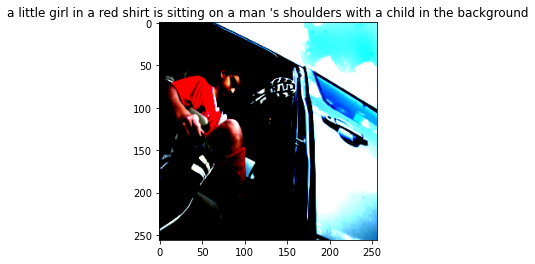

Original ['A', 'boy', 'dressed', 'in', 'soccer', 'attire', 'and', 'holding', 'his', 'shoes', 'getting', 'out', 'of', 'a', 'car']
['a', 'boy', 'is', 'jumping', 'off', 'a', 'ramp', 'with', 'his', 'hands', 'on', 'the', 'top', 'of', 'a', 'staircase']
['three', 'young', 'boys', 'play', 'on', 'a', 'swing', 'set']
['a', 'man', 'and', 'a', 'boy', 'on', 'a', 'bike', 'in', 'midair']
['a', 'boy', 'and', 'a', 'woman', 'on', 'a', 'swing']


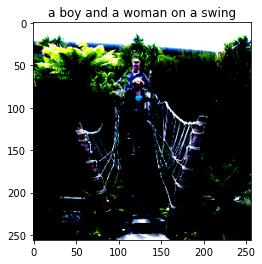

Original ['A', 'bridge', 'through', 'high', 'green', 'plants', ',', 'a', 'man', 'and', 'a', 'woman', 'on', 'it']
['a', 'group', '<UNK>', 'in', 'front', 'of', 'a', 'small', 'wagon']
['a', 'family', 'stands', 'in', 'front', 'of', 'an', 'suv', 'covered', 'with', 'graffiti']
['two', 'girls', 'and', 'a', 'woman', 'sit', 'on', 'a', 'bench', 'in', 'front', 'of', 'a', 'truck']
['a', 'bunch', 'of', 'people', 'sit', 'on', 'a', 'painted', 'truck']


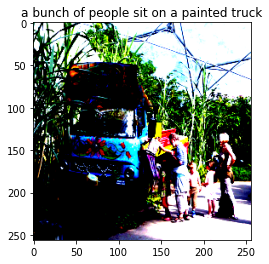

Original ['A', 'family', 'gathered', 'at', 'a', 'painted']
['a', 'girl', 'in', 'a', 'red', 'and', 'white', 'shirt', 'with', 'a', 'pink', 'purse', 'and', 'white', 'shirt', 'looks', 'at', 'a', 'woman', 'in', 'a', 'pink', 'sweater', '.', 'a', 'man', 'in', 'a', 'yellow', 'shirt', 'and', 'a', 'woman', 'in', 'a', 'pink', 'sweater', ',', 'and', 'a', 'girl', 'in', 'a', 'pink', 'sweater']
['a', 'woman', 'with', 'a', 'blonde', 'girl', 'and', 'a', 'woman', 'with', 'her', 'arms', 'around']
['an', 'asian', 'girl', 'is', 'holding', 'a', 'little', 'girl', 'who', 'is', 'wearing', 'red', 'and', 'white']
['the', 'girl', 'in', 'the', 'red', 'and', 'white', 'shirt', 'looks', 'to', 'the', 'left', 'of', 'the', 'woman', 'in', 'the', 'pink', 'and', 'white', 'shirt']


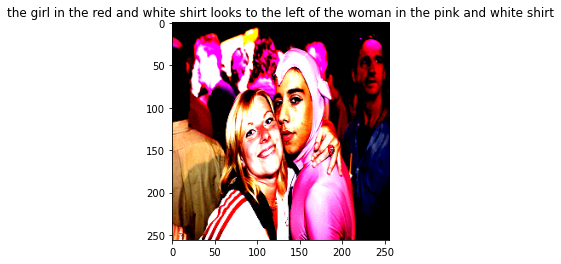

Original ['A', 'blond', 'woman', 'poses', 'with', 'a', 'person', 'in', 'a', 'pink', 'costume']
['a', 'woman', 'wearing', 'blue', 'rides', 'a', 'bike']
['a', 'woman', 'wearing', 'a', 'blue', 'helmet', 'rides', 'a', 'bicycle', 'on', 'the']
['a', 'woman', 'in', 'a', 'helmet', 'riding', 'a', 'bicycle']
['a', 'woman', 'wearing', 'a', 'blue', 'helmet', 'rides', 'a', 'bicycle', 'on', 'the', 'street']


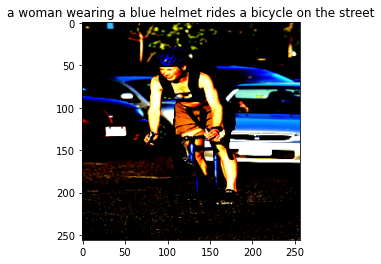

Original ['A', 'bicyclist', 'riding', 'on', 'a', 'city', 'street']
['a', 'man', 'on', 'a', 'bicycle', 'in', 'a', 'race']
['a', 'man', 'on', 'the', 'street', 'with', 'his', 'red', 'bicycle', 'in', 'the', 'street']
['the', 'man', 'is', 'riding', 'a', 'bicycle', 'in', 'the', 'city']
['someone', 'is', 'riding', 'a', 'unicycle', 'on', 'the', 'street']


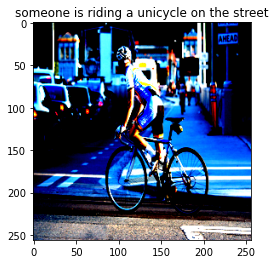

Original ['A', 'bicycle', 'rider', 'is', 'crossing', 'a', 'street']
['a', 'woman', 'wearing', 'a', 'blue', 'helmet', 'rides', 'a', 'bike', 'while', 'a', 'crowd', 'looks']
['two', 'women', 'are', 'riding', 'bicycles', 'on', 'the', 'street']
['a', 'woman', 'with', 'a', 'blue', 'helmet', 'riding', 'a', 'bike']
['a', 'woman', 'wearing', 'a', 'blue', 'helmet', 'riding', 'a', 'bike']


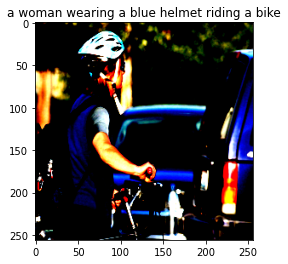

Original ['A', 'lady', 'wearing', 'a', 'helmet', 'holding', 'a', 'bike']
['the', 'woman', 'in', 'shorts', 'and', 'a', 'white', 'shirt', 'is', 'walking', 'in', 'the', 'road']
['the', 'woman', 'is', 'wearing', 'a', 'white', 'shirt', 'and', 'holding', 'a', 'red', 'cup']
['the', 'woman', 'in', 'shorts', 'and', 'a', 'white', 'shirt', 'is', 'walking', 'in', 'the', 'street']
['woman', 'in', 'blue', 'shorts', 'and', 'shorts', 'in', 'a']


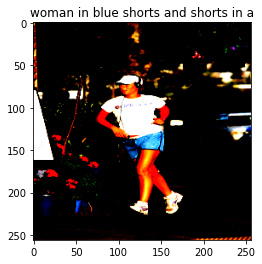

Original ['A', 'man', 'in', 'shorts', 'is', 'jogging', 'along', 'a', 'street', 'with', 'a', 'headset']
['two', 'people', 'are', 'riding', 'bicycles', 'on', 'a', 'street']
['a', 'man', 'and', 'a', 'woman', 'are', 'riding', 'a', 'bike', 'down', 'the', 'street']
['two', 'people', 'riding', 'a', 'bike', 'down', 'the', 'sidewalk']
['a', 'group', 'of', 'young', 'people', 'on', 'a', 'street']


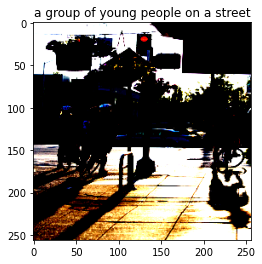

Original ['Bicyclists', 'are', 'standing', 'at', 'an', 'intersection']
['a', 'man', 'with', 'a', 'microphone', 'is', 'looking', 'at', 'a', 'woman', 'in', 'a', 'market']
['two', 'people', 'are', 'standing', 'on', 'a', 'park', 'bench', 'with', 'many', 'people', 'walking']
['two', 'guys', 'are', 'posing', 'for', 'a', 'photograph', 'in', 'a', 'city', 'park']
['a', 'group', 'of', 'people', 'are', 'posing', 'for', 'a', 'picture', 'in', 'a', 'city', 'park']


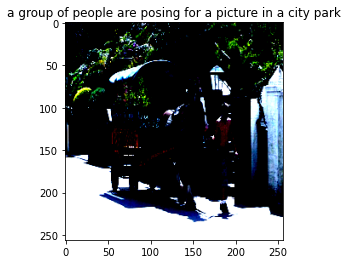

Original ['A', 'man', 'without', 'a', 'shirt', 'on', 'is', 'guiding', 'a', 'large', 'brown', 'horse', 'pulling', 'a', 'green', 'and', 'yellow', 'wagon']
['three', 'boys', 'play', 'in', 'the']
['a', 'group', 'of', 'young', 'boys', 'play', 'in', 'the', 'air', 'near', 'a', 'playground']
['a', 'group', 'of', 'children', 'playing', 'volleyball', 'in', 'the', 'park']
['a', 'man', 'and', 'a', 'boy', 'are', 'playing', 'a', 'sport', 'on', 'a', 'playground']


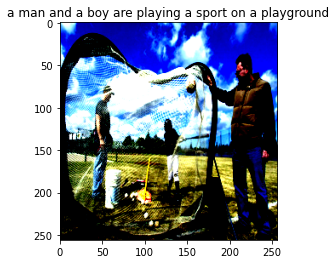

Original ['A', 'boy', 'hits', 'a', 'ball', 'off', 'of', 'a', 'tee', 'ball', 'into', 'to', 'net']
['a', 'young', 'boy', 'wearing', 'a', 'white', 'shirt', 'and', 'blue', 'shorts', 'is', 'jumping', 'into', 'the', 'air']
['a', 'little', 'girl', 'in', 'a', 'white', 't', '-', 'shirt', 'jumps', 'into', 'the', 'water']
['a', 'small', 'girl', 'wearing', 'a', 'white', 't', '-', 'shirt', 'jumps', 'into', 'the', 'ocean']
['a', 'young', 'girl', 'runs', 'through', 'the', 'water']


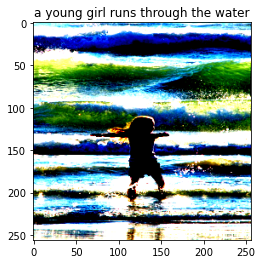

Original ['A', 'small', 'girl', 'spins', 'in', 'the', 'waves', 'in', 'the', 'bright', 'sun']
['a', 'girl', 'in', 'a', 'blue', 'shirt', 'kicks', 'a', 'soccer', 'baseball']
['a', 'girl', 'in', 'a', 'blue', 'uniform', 'is', 'playing', 'a', 'soccer', 'ball', 'in', 'a', 'game']
['the', 'little', 'boy', 'is', 'playing', 'with', 'a', 'football', 'while', 'the', 'other', 'team', 'members']
['a', 'girl', 'is', 'playing', 'a', 'softball', 'in', 'a', 'field']


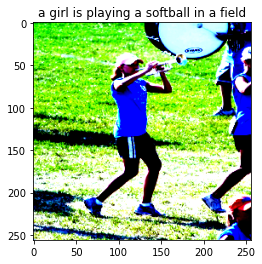

Original ['A', 'girl', 'playing', 'trumpet', 'in', 'a', 'marching', 'band']
['a', 'woman', 'in', 'a', 'green', 'hat', 'is', 'holding', 'a', 'drink', 'in', 'a', 'coffee', 'shop']
['two', 'asian', 'girls', 'are', 'sitting', 'at', 'a', 'table', 'in', 'a', '<UNK>', 'shop']
['two', 'asian', 'women', 'are', 'posing', 'for', 'a', 'photograph', 'while', 'a', 'man', 'in', 'a', 'hat', 'smiles']
['two', 'asian', 'girls', 'are', 'posing', 'in', 'front', 'of', 'a', 'computer']


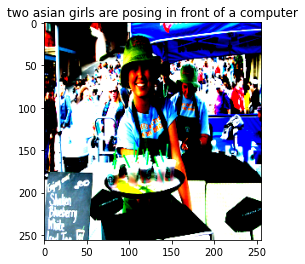

Original ['A', 'girl', 'hands', 'out', 'Starbucks', 'samples', 'at', 'a', 'street', 'fair']
['four', 'people', 'are', 'jumping', 'in', 'a', 'snow', 'covered', 'with', 'snow']
['several', 'people', 'in', 'the', 'snow']
['four', 'people', 'on', 'a', 'sled', 'walk', 'through', 'snow']
['several', 'people', 'are', 'riding', 'a', 'sled', 'through', 'the', 'snow']


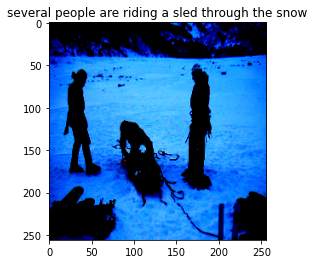

Original ['Three', 'men', 'are', 'setting', 'up', 'a', 'sledge', 'on', 'a', 'snowy', 'plain']
['a', 'boy', 'in', 'a', 'blue', 'shirt', 'is', 'kicking', 'a', 'ball', 'in', 'a', '<UNK>', 'while', 'another', 'boy', 'in', 'a', 'blue', 'top', 'is', 'running']
['the', 'boy', 'in', 'the', 'blue', 'shorts', 'is', 'playing', 'the', 'ball', 'in', 'the', 'water']
['a', 'boy', 'in', 'a', 'blue', 'and', 'white', 'uniform', 'is', 'jumping', 'into', 'the', 'air', 'while', 'holding', 'onto', 'a', 'football']
['a', 'child', 'in', 'a', 'blue', 'and', 'white', 'uniform', 'playing', 'with', 'a', 'football']


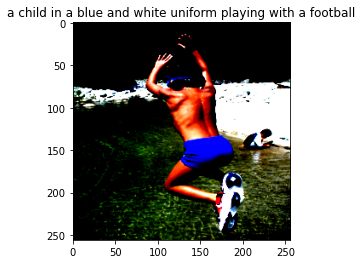

Original ['A', 'child', 'jumping', 'into', 'a', 'lake', 'in', 'a', 'wooded', 'area', 'while', 'another', 'child', 'plays', 'on', 'the', 'shore']
['a', 'boy', 'wearing', 'a', 'hat', 'and', 'sunglasses', 'sits', 'in', 'front', 'of', 'a', 'bench', '.']
['the', 'girl', 'wearing', 'a', 'hat', 'sits', 'on', 'a', 'park', 'bench']
['an', 'elderly', 'woman', 'is', 'sitting', 'on', 'a', 'bench', 'and', 'reads', 'a', 'book']
['a', 'boy', 'wearing', 'a', 'hat', 'sits', 'on', 'a', 'park', 'bench']


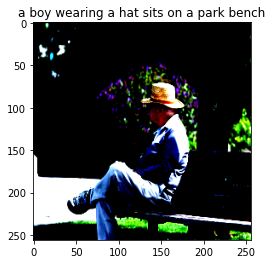

Original ['A', 'elderly', 'man', 'in', 'a', 'straw', 'hat', 'is', 'sitting', 'on', 'a', 'bench']
['three', 'girls', 'are', 'walking', 'through', 'the', 'water', 'with', 'a', 'long', 'pole']
['three', 'girls', 'are', 'walking', 'on', 'a', 'bridge', 'in', 'the', 'woods']
['three', 'people', 'walking', 'on', 'the', 'path', 'in', 'the', 'woods']
['three', 'girls', 'are', 'walking', 'on', 'a', 'bridge', 'in', 'a', 'park']


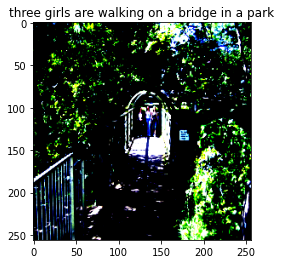

Original ['Three', 'girls', 'are', 'walking', 'across', 'a', 'bridge', 'covered', 'with', 'wood', 'and', 'surrounded', 'by', 'trees']
['a', 'little', 'girl', 'in', 'a', 'red', 'top', ',', 'and', 'a', 'red', 'hat', ',', 'with', 'a', 'helmet', ',', 'and', 'a', 'girl', 'wearing', 'a', 'red', 'hat', ',', 'sits', 'on', 'a', 'rock']
['a', 'little', 'girl', 'in', 'a', 'red', 'hat', 'and', 'black', 'hat', 'is', 'sitting', 'on', 'a', 'red', 'bench', 'with', 'a', 'little', 'girl']
['a', 'little', 'girl', 'in', 'a', 'red', 'top', 'and', 'a', 'red', 'hat', 'is', 'sitting', 'in', 'the', 'sand']
['a', 'little', 'girl', 'in', 'a', 'red', 'hat', 'and', 'hat', 'sits', 'on', 'the', 'edge', 'of', 'a', 'rock']


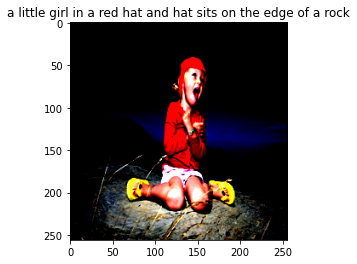

Original ['A', 'girl', 'dressed', 'in', 'a', 'red', 'top', ',', 'a', 'red', 'cap', ',', 'and', 'light', 'colored', 'shorts', ',', 'sits', 'on', 'a', 'rock', 'outside']
['a', 'woman', 'in', 'a', 'small', 'snow', 'cap', 'and', 'a', 'man', 'in', 'a', 'blue', 'jacket', 'sitting', 'near', 'a', 'rock', 'formation']
['a', 'man', 'sits', 'in', 'a', 'snowy', 'landscape']
['a', 'man', 'sits', 'in', 'the', 'snow']
['a', 'man', 'sits', 'in', 'the', 'snow']


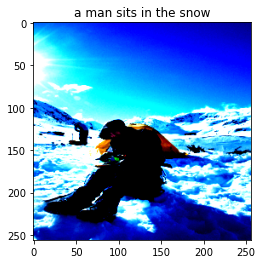

Original ['A', 'man', 'eats', 'near', 'a', 'tent', 'in', 'the', 'snow']
['two', 'black', 'dogs', 'are', 'running', 'on', 'a', 'grassy', ',', 'one', 'with', 'one', 'green', 'and', 'one', 'foot', 'in', 'the', 'other', ',', 'one', 'in', 'a', 'yellow', 'jacket']
['two', 'dogs', 'run', 'through', 'a', 'field']
['two', 'dogs', 'are', 'running', 'through', 'the', 'grass']
['two', 'dogs', 'run', 'through', 'a', 'field']


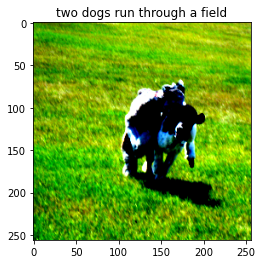

Original ['A', 'grey', 'dog', 'beside', 'a', 'black', 'and', 'white', 'dog', 'running', 'in', 'green', 'grass']
['a', 'man', 'and', 'his', 'dog', 'are', 'playing', 'in', 'a', '<UNK>']
['two', 'young', 'children', 'playing', 'with', 'a', 'cat']
['an', 'adult', 'and', 'a', 'little', 'boy', 'are', 'playing', 'in', 'the', 'snow']
['a', 'woman', 'in', 'a', 'red', 'shirt', 'is', 'laying', 'on', 'a', 'brown', 'shaggy', 'white', 'dog']


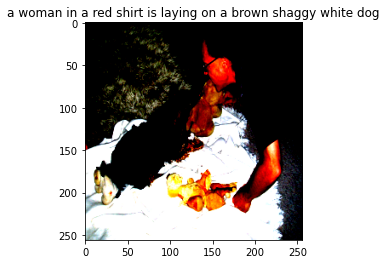

Original ['A', 'man', 'in', 'a', 'red', 'shirt', 'and', 'glasses', 'is', 'bending', 'down', 'towards', 'a', 'small', 'dog', 'on', 'a', 'blanket', 'with', 'several', 'stuffed', 'animals']
['a', 'boy', 'wearing', 'a', 'red', 'shirt', 'with', 'his', 'nose', 'to', 'his', 'nose', '.']
['young', 'boy', 'with', 'brown', 'hair', 'and', 'a', 'black', 'shirt']
['a', 'young', 'boy', 'with', 'a', '<UNK>', 'on', 'his', 'head']
['a', 'boy', 'with', 'a', 'nose', 'ring', 'and', 'his']


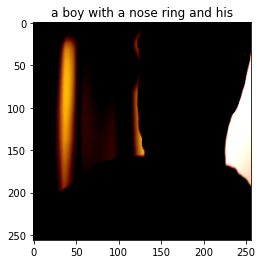

Original ['A', 'guy', 'with', 'a', 'nose', 'piercing']
['a', 'man', 'with', 'a', '<UNK>', 'on', 'the', 'shirt', 'is', 'looking', 'at', 'his', 'reflection']
['a', 'man', 'with', 'a', 'yellow', 'headband', 'and', 'a', 'shirt']
['a', 'man', 'in', 'a', 'yellow', 't', '-', 'shirt', 'looking', 'at', 'a', '<UNK>']
['a', 'man', 'is', 'wearing', 'a', 'yellow', 'shirt']


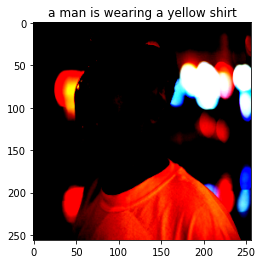

Original ['A', 'man', 'in', 'yellow', 'grimaces']
['a', 'man', 'stands', 'at', 'the', 'bar', 'while', 'a', 'man', 'in', 'a', 'yellow', 'vest', 'is', 'standing', 'behind', 'a', 'store', '.']
['a', 'man', 'and', 'a', 'woman', 'sitting', 'in', 'a', 'restaurant', 'at', 'night']
['a', 'man', 'and', 'a', 'woman', 'are', 'sitting', 'at', 'a', 'table', 'in', 'front', 'of', 'an', 'establishment']
['a', 'couple', 'sits', 'at', 'a', 'table', 'in', 'front', 'of', 'a', 'museum']


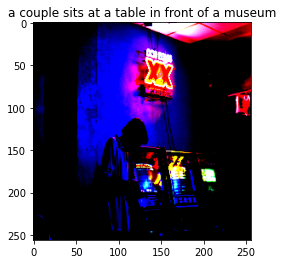

Original ['A', 'man', 'is', 'standing', 'by', 'a', 'group', 'of', 'video', 'games', 'in', 'a', 'bar']
['a', 'dog', 'chases', 'another', 'dog']
['two', 'brown', 'dogs', 'are', 'running', 'through', 'the', 'grass', ',', 'one', 'is', 'carrying', 'a', 'ball', 'in', 'his', 'mouth']
['a', 'brown', 'dog', 'and', 'a', 'brown', 'dog', 'are', 'playing', 'in', 'the', 'grass']
['two', 'brown', 'dogs', 'running', 'through', 'a', 'grassy', 'field']


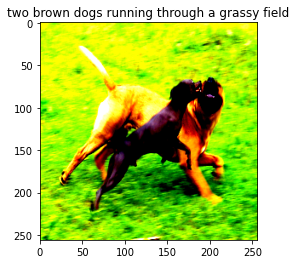

Original ['A', 'big', 'brown', 'dog', 'plays', 'with', 'a', 'smaller', 'grey', 'dog', 'on', 'the', 'grass']
['a', 'boy', 'in', 'a', 'yellow', 't', '-', 'suit', 'jumps', 'into', 'the', 'ocean']
['a', 'boy', 'in', 'shorts', 'and', 'a', 't', '-', 'shirt', 'is', 'jumping', 'into', 'the', 'water']
['the', 'boy', 'in', 'the', 'blue', 'shirt', 'is', 'running', 'in', 'the', 'water']
['a', 'boy', 'in', 'blue', 'shorts', 'is', 'jumping', 'into', 'the', 'water']


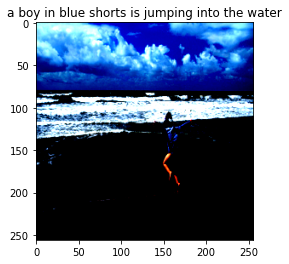

Original ['A', 'girl', 'in', 'blue', 'is', 'jumping', 'on', 'the', 'shore', 'as', 'small', 'waves', 'approach', 'her']
['a', 'group', 'walking', 'in', 'a', 'town', 'square']
['many', 'people', 'are', 'walking', 'down', 'the', 'street', 'carrying', 'flags']
['many', 'people', 'walk', 'down', 'a', 'city', 'street']
['a', 'group', 'of', 'people', 'walking', 'down', 'the', 'street', 'carrying', 'flags']


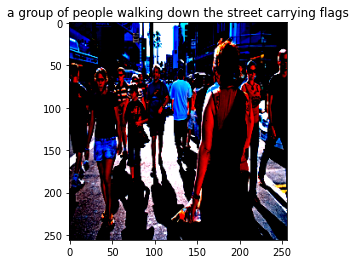

Original ['A', 'crowd', 'of', 'people', 'walk', 'down', 'a', 'busy', 'sidewalk']
['a', 'dog', 'leaps', 'to', 'catch', 'a', 'orange', 'ball']
['a', 'dog', 'jumps', 'to', 'catch', 'a', 'ball']
['a', 'dog', 'jumps', 'in', 'the', 'air', 'to', 'catch', 'a', 'soccer', 'ball']
['a', 'dog', 'catches', 'a', 'ball']


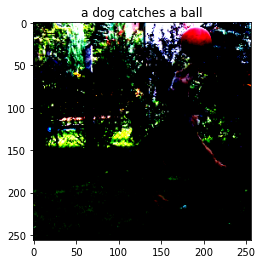

Original ['A', 'big', 'dog', 'catches', 'a', 'ball', 'on', 'his']
['two', 'boys', 'are', 'standing', 'in', 'a', 'water', 'with', 'a', 'black', 'and', 'red', 'striped', 'shirt']
['a', 'little', 'boy', 'and', 'a', 'little', 'girl', 'are', 'standing', 'on', 'a', 'water', 'fountain']
['two', 'little', 'boys', 'are', 'standing', 'in', 'a', 'water', 'fountain']
['two', 'boys', 'are', 'standing', 'near', 'a', 'water', 'fountain']


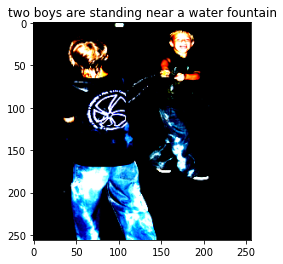

Original ['Two', 'blonde', 'boys', ',', 'one', 'in', 'a', 'camouflage', 'shirt', 'and', 'the', 'other', 'in', 'blue', ',', 'are', 'having', 'a', 'water', 'fight']
['two', 'dogs', 'are', 'playing', 'on', 'a', 'beach']
['a', 'dog', 'is', 'jumping', 'in', 'the', 'air', 'while', 'playing', 'in', 'the', 'pool']
['a', 'brown', 'dog', 'jumps', 'into', 'a', 'pool']
['a', 'dog', 'is', 'jumping', 'into', 'a', 'pool']


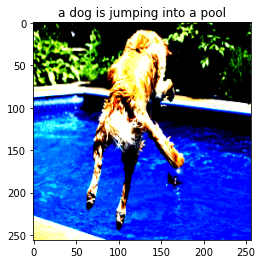

Original ['a', 'brown', 'dog', 'jumping', 'into', 'a', 'pool', 'after', 'a', 'bloe', 'ball']
['twin', 'toddlers', 'dressed', 'in', 'red', 'and', 'black', 'uniforms', 'pose', 'in', 'a']
['twin', 'kids', 'being', 'pushed', 'in', 'a', 'car', 'shaped', 'strollers', 'in', 'the', 'parade']
['twin', 'kids', 'being', 'pushed', 'in', 'a', 'car', 'shaped', 'strollers', 'in', 'a', 'parade']
['a', 'group', 'of', 'children', 'play', 'on', 'a', 'toy', 'truck']


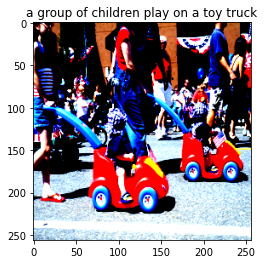

Original ['Parents', 'are', 'pushing', 'little', 'children', 'in', 'red', 'car', 'carts']
['a', 'woman', 'wearing', 'a', 'black', 'hat', 'and', 'sunglasses', 'smiles', 'for', 'her', 'picture']
['a', 'girl', 'wearing', 'sunglasses', 'and', 'a', 'blue', 'hat', 'smiles']
['a', 'woman', 'wearing', 'a', 'black', 'hat', 'and', 'sunglasses', 'smiles']
['an', 'asian', 'boy', 'with', 'a', '<UNK>', 'around', 'his']


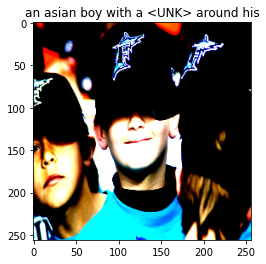

Original ['A', 'boys', 'baseball', 'team', 'wear', 'their', 'uniforms']
['a', 'dog', 'running', 'in', 'a', 'field']
['the', 'brown', 'dog', 'is', 'in', 'the', 'field', 'with', 'a', 'large', 'brown', 'dog']
['two', 'dogs', 'running', 'through', 'a', 'field']
['a', 'dog', 'is', 'running', 'through', 'a', 'field']


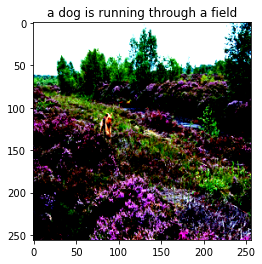

Original ['A', 'brown', 'dog', 'running', 'through', 'the', 'grass', 'and', 'flowers']
['a', 'dog', 'and', 'a', 'woman', 'are', 'looking', 'at', 'each', 'other', 'on', 'the', 'sand']
['a', 'small', 'dog', 'and', 'a', 'small', 'dog']
['two', 'dogs', 'playing', 'with', 'a', 'toy']
['a', 'brown', 'and', 'black', 'and', 'white', 'dog', 'playing', 'with', 'a', 'toy', 'in', 'the', 'snow']


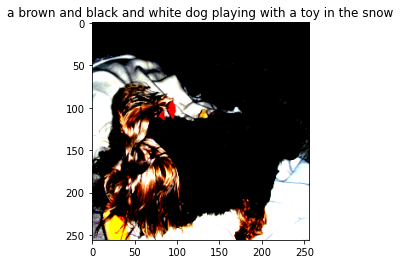

Original ['A', 'small', 'brown', 'and', 'black']
['a', 'tan', 'dog', 'is', 'jumping', 'over', 'a', 'horizontal', 'wire', 'fence', 'on', 'a', 'grassy', 'field']
['a', 'dog', 'runs', 'through', 'the', 'grass']
['a', 'brown', 'dog', 'is', 'jumping', 'over', 'a', 'log', 'in', 'a', 'field']
['a', 'dog', 'runs', 'through', 'the', 'grass']


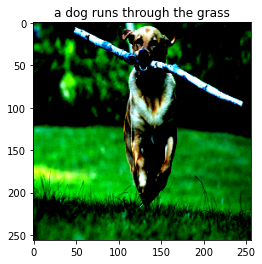

Original ['A', 'big', 'tan', 'dog', 'runs', 'on', 'grass', 'with', 'a', 'big', 'stick', 'in', 'his', 'mouth']
['two', 'dogs', 'are', 'jumping', 'into', 'a', 'swimming', 'pool']
['a', 'large', 'dog', 'jumping', 'into', 'a', 'swimming', 'pool']
['a', 'dog', 'jumps', 'into', 'a', 'swimming', 'pool']
['a', 'brown', 'dog', 'is', 'jumping', 'into', 'a', 'pool', 'while', 'two', 'people', 'look', 'on']


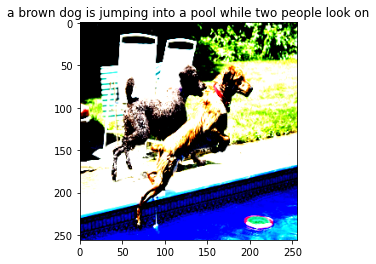

Original ['A', 'dog', 'jumping', 'into', 'a', 'swimming', 'pool']
['a', 'woman', 'and', 'a', 'man', 'are', 'standing', 'in', 'front', 'of', 'a', 'glass', 'counter']
['two', 'young', 'girls', 'are', 'looking', 'at', 'each', 'other', 'in', 'a', 'gym']
['two', 'young', 'girls', 'are', 'looking', 'at', 'each', 'other', 'in', 'a', 'gym']
['two', 'children', 'are', 'looking', 'at', 'each', 'other', 'in', 'front', 'of', 'an', 'audience']


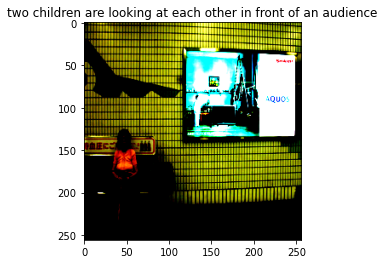

Original ['A', 'little', 'old', 'lady', 'sitting', 'next', 'to', 'an', 'advertisement']
['a', 'girl', 'in', 'a', 'purple', 'shirt', 'and', 'a', 'girl', 'in', 'a', 'black', 'outfit', 'and', 'a', 'girl', 'with', 'a', 'helmet', 'on', 'his', 'back']
['several', 'people', 'are', 'walking', 'around', 'a', 'scooter']
['a', 'girl', 'rides', 'a', 'unicycle', 'while', 'another', 'rides', 'a', 'scooter', 'on']
['the', 'girl', 'in', 'the', 'purple', 'shirt', 'is', 'pushing', 'a', 'man', 'on', 'a', 'scooter', 'in', 'the']


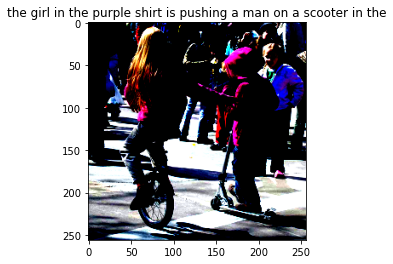

Original ['A', 'girl', 'rides', 'a', 'unicycle', 'as', 'another', 'rides', 'a', 'scooter', 'next', 'to', 'her']
['a', 'man', 'sits', 'on', 'a', 'bench', 'next', 'to', 'a', 'waterway', '.']
['two', 'people', 'sit', 'on', 'a', 'bench', 'in', 'the', 'middle', 'of', 'an', 'urban', 'city', 'street']
['two', 'people', 'sitting', 'on', 'a', 'dock']
['a', 'man', 'sits', 'in', 'a', 'boat', 'on', 'the', 'water']


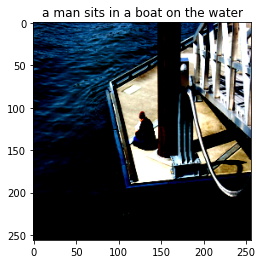

Original ['A', 'man', 'in', 'a', 'brown', 'shirt', 'sitting', 'on', 'a', 'dock', 'and', 'reading']
['a', 'group', 'of', 'people', 'sit', 'on', 'a', 'bench', 'in', 'front', 'of', 'a', 'wooden', 'building']
['a', 'man', 'and', 'a', 'woman', 'are', 'sitting', 'on', 'the', 'side', 'of', 'a', 'wooden', 'bench']
['a', 'group', 'of', 'young', 'people', 'sitting', 'on', 'steps', 'in', 'a', 'park']
['a', 'group', 'of', 'people', 'sit', 'on', 'a', 'bench', 'in', 'a', 'park']


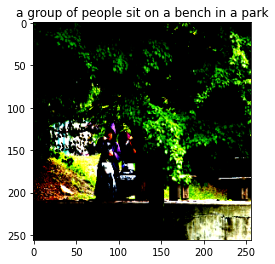

Original ['a', 'person', 'sits', 'at', 'a', 'table', 'behind', 'a', 'tree']
['a', 'man', 'and', 'woman', 'are', 'standing', 'on', 'a', 'sidewalk', 'with', 'other', 'people', 'in', 'the', 'background']
['a', 'man', 'and', 'a', 'woman', 'are', 'standing', 'in', 'a', 'city', 'street']
['a', 'man', 'in', 'a', 'blue', 'shirt', 'is', 'standing', 'with', 'a', 'woman', 'in', 'a', 'blue', 'shirt']
['a', 'man', 'in', 'a', 'blue', 'shirt', 'stands', 'next', 'to', 'a', 'woman', 'in', 'a', 'blue', 'shirt']


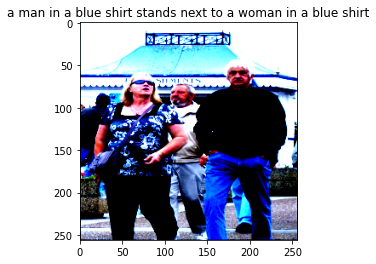

Original ['a', 'couple', 'walking', 'along', 'on', 'a']
['a', 'girl', 'is', 'sitting', 'on', 'a', 'wooden', 'bench', 'in', 'the', 'park']
['two', 'girls', 'are', 'playing', 'on', 'a', 'park', 'bench']
['a', 'girl', 'sits', 'on', 'a', 'picnic', 'picnic', 'picnic', 'table']
['a', 'girl', 'is', 'sitting', 'on', 'a', 'wooden', 'bench', 'in', 'the', 'park']


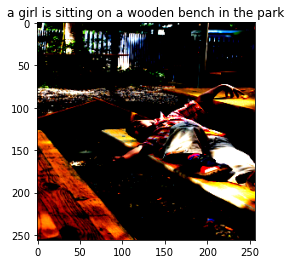

Original ['A', 'boy', 'lays', 'on', 'a', 'picnic', 'table', 'bench']
['two', 'brown', 'dogs', 'are', 'playing', 'in', 'the', 'grass', '.']
['two', 'dogs', 'are', 'playing', 'in', 'a', 'field', 'of', 'tall', 'grass']
['a', 'brown', 'dog', 'and', 'a', 'black', 'dog', 'are', 'running', 'through', 'the', 'grass']
['two', 'dogs', 'in', 'the', 'grass', 'playing', 'with', 'a', 'toy']


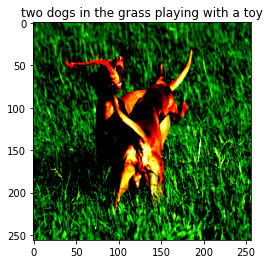

Original ['Dogs', 'fight', 'in', 'grass', 'over', 'toy']
['a', 'boy', 'is', 'standing', 'on', 'a', 'blue', 'chair', 'holding', 'a', 'little', 'girl', 'in', 'front', 'of', 'the', 'other', '.', 'boy']
['a', 'young', 'boy', 'and', 'a', 'girl', 'are', 'playing', 'on', 'a', 'swing']
['a', 'man', 'and', 'a', 'little', 'girl', 'are', 'standing', 'on', 'a', '<UNK>', 'in', 'front', 'of', 'a', 'large']
['a', 'boy', 'wearing', 'a', 'blue', 'shirt', 'is', 'standing', 'next', 'to', 'a', 'man', 'in', 'a', 'blue', 'shirt']


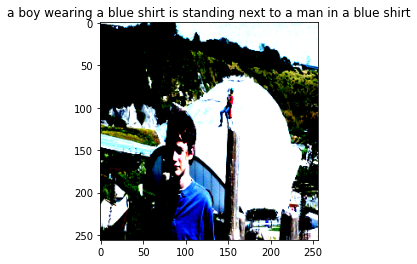

Original ['A', 'boy', 'and', 'a', 'person', 'suspended', 'above', 'a', 'dome', 'structure']
['a', 'girl', 'in', 'a', 'white', 'dress', 'and', 'pink', 'boots', 'is', 'walking', 'with', 'two', 'people', 'in', 'costumes']
['a', 'girl', 'in', 'a', 'yellow', 'dress', 'is', 'posing', 'for', 'a', 'picture', 'in', 'a', 'park']
['a', 'girl', 'in', 'a', 'white', 'dress', 'is', 'standing', 'with', 'a', 'man', 'in', 'a', 'blue', 'dress']
['a', 'group', 'of', 'children', 'stand', 'in', 'a', 'yard']


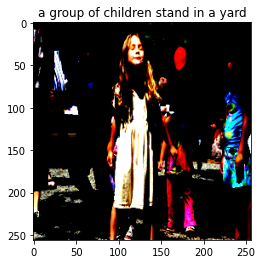

Original ['A', 'girl', 'in', 'a', 'brown', 'dress', 'surrounded', 'by', 'children', 'closes', 'her', 'eyes']
['a', 'man', 'and', 'woman', 'are', 'walking', 'on', 'an', 'outdoor', 'ice', 'rink']
['a', 'man', 'and', 'a', 'woman', 'are', 'walking', 'down', 'a', 'city', 'street']
['a', 'group', 'of', 'people', 'walk', 'down', 'the', 'street']
['a', 'group', 'of', 'people', 'walk', 'down', 'a', 'busy', 'sidewalk']


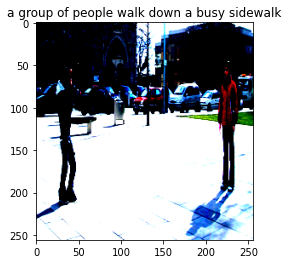

Original ['A', 'man', 'in', 'a', 'black', 'jacket', 'is', 'taking', 'a', 'photo', 'of', 'a', 'man', 'in', 'a', 'red', 'jacket']
['a', 'family', 'of', 'four', 'children', 'sitting', 'on', 'a', 'cement', 'bench']
['a', 'family', 'sits', 'in', 'front', 'of', 'a', 'fountain']
['a', 'family', 'sits', 'on', 'a', 'bench', 'in', 'a', 'city', 'street', 'while', 'other', 'people', 'look', 'on']
['two', 'young', 'women', 'pose', 'for', 'a', 'picture', 'on', 'a', 'city', 'street']


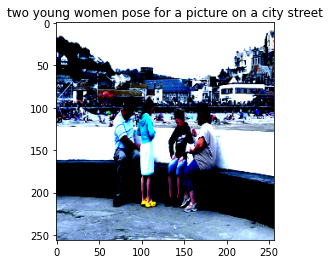

Original ['A', 'family', 'sits', 'on', 'a', 'bench', 'near', 'a', 'beach']
['people', 'are', 'walking', 'up', 'a', 'rock']
['a', 'group', 'of', 'people', 'rock', 'climbing']
['a', 'group', 'of', 'people', 'rock', 'climbing']
['a', 'group', 'of', 'people', 'climb', 'a', 'rock']


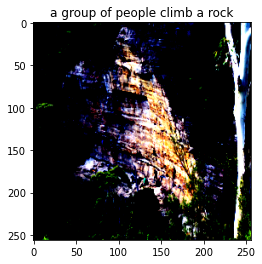

Original ['A', 'group', 'of', 'climbers', 'begin', 'up', 'a', 'sheer', 'rock', 'face']
['two', 'people', 'are', 'sitting', 'in', 'front', 'of', 'a', 'building', 'with', 'a', 'building', 'in', 'the', 'background', 'and', 'a', 'man', 'in', 'the', 'background']
['two', 'men', 'are', 'sitting', 'in', 'front', 'of', 'a', 'railing']
['two', 'people', 'are', 'sitting', 'on', 'the', 'side', 'of', 'a', 'boat']
['two', 'men', 'are', 'sitting', 'on', 'the', 'side', 'by', 'a', 'large', 'building']


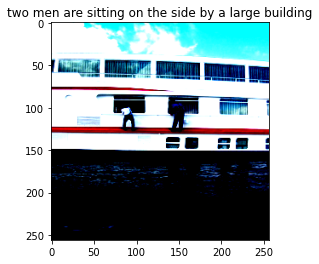

Original ['two', 'men', 'cleaning', 'the', 'outside', 'windows', 'of', 'a']
['two', 'girls', 'are', 'running', 'and', 'playing', 'in', 'a', 'muddy']
['two', 'girls', 'are', 'running', 'through', 'a', 'park']
['two', 'little', 'girls', 'are', 'walking', 'in', 'the', 'grass', 'and', 'one', 'is', 'taking', 'a', 'photo']
['two', 'girls', 'run', 'along', 'the', 'grass']


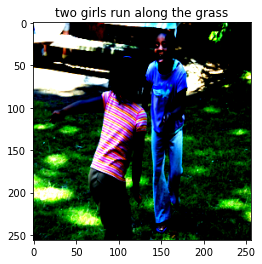

Original ['Two', 'children', 'are', 'laughing', 'in', 'the', 'grass']
['a', 'boy', 'wearing', 'a', 'red', 'and', 'black', 'striped', 'shirt', 'is', 'swinging', 'on', 'a', 'swing']
['a', 'young', 'asian', 'boy', 'is', 'swinging', 'on', 'a', 'swing']
['a', 'boy', 'with', 'a', 'red', 'shirt', 'on', 'a']
['a', 'boy', 'with', 'a', 'red', 'shirt', 'on', 'a']


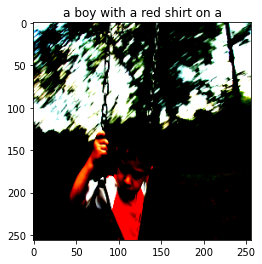

Original ['A', 'boy', 'in', 'a', 'red', 'and', 'white', 'shirt', 'is', 'on', 'a', 'swing']
['the', 'boy', 'is', 'eating', 'a', 'spoon', 'in', 'the', 'hand']
['a', 'young', 'girl', 'holds', 'a', 'spoon', 'up', 'to', 'a', 'boy', 'and', 'a', 'boy']
['a', 'little', 'boy', 'drinks', 'from', 'a', 'water', 'hose']
['a', 'little', 'girl', 'is', 'holding', 'a', 'spoon', 'up', 'to', 'her', 'mouth']


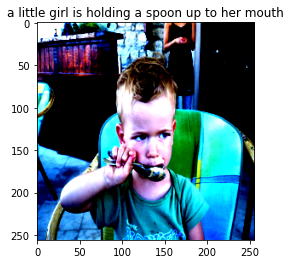

Original ['A', 'boy', 'eats', 'with', 'a', 'spoon']
['a', 'woman', 'walking', 'down', 'a', 'brick', 'sidewalk', 'at']
['a', 'woman', 'walking', 'along', 'a', 'brick', 'sidewalk', 'with', 'a', 'shop', 'on', 'the', 'left']
['a', 'girl', 'walks', 'down', 'a', 'brick', 'sidewalk', 'at', 'night']
['a', 'woman', 'walks', 'down', 'a', 'sidewalk']


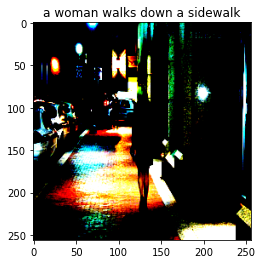

Original ['A', 'girl', 'walking', 'alone', 'at', 'night', 'on', 'a', 'street']
['two', 'black', 'dogs', 'and', 'a', 'man', 'in', 'a', 'grassy', 'field']
['a', 'black', 'dog', 'is', 'running', 'through', 'the', 'grass', 'with', 'a', 'black', 'dog']
['a', 'black', 'dog', 'and', 'two', 'black', 'dogs', 'in', 'the', 'grass']
['a', 'black', 'dog', 'and', 'a', 'brown', 'dog', 'in', 'a', 'field']


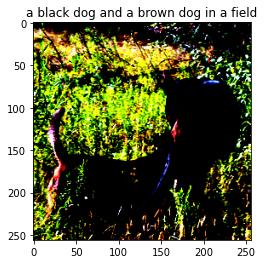

Original ['A', 'black', 'dog', 'and', 'a', 'brown', 'dog', 'playing', 'in', 'tall', 'weeds']
['a', 'brown', 'dog', 'is', 'running', 'in', 'the', 'grass', 'with', 'a', 'brown', 'object', 'in', 'its']
['a', 'brown', 'dog', 'is', 'jumping', 'in', 'the', 'air', 'with', 'his', 'mouth', 'open']
['a', 'dog', 'leaps', 'in', 'the', 'air']
['a', 'brown', 'dog', 'jumping', 'into', 'the', 'air', 'to', 'catch', 'a', 'ball']


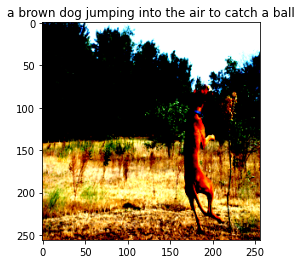

Original ['A', 'brown', 'dog', 'jumping', 'in', 'the', 'air', 'on', 'a', 'brown', 'plain']
['a', 'child', 'in', 'a', 'jacket', 'and', 'a', 'red', 'shirt', 'sitting', 'on', 'a', 'red', 'couch', '.']
['the', 'child', 'is', 'holding', 'a', 'red', 'and', 'red', 'ball']
['a', 'child', 'in', 'a', 'blue', 'shirt', 'sitting', 'on', 'a', 'toy']
['a', 'little', 'boy', 'is', 'laying', 'on', 'a', 'red', 'and', 'red', 'toy']


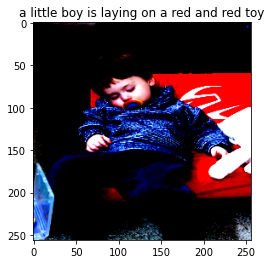

Original ['A', 'child', 'in', 'gray', 'clothes', 'is', 'sleeping', 'on', 'a', 'red', 'cushion']
['a', 'little', 'girl', 'with', 'her', 'arm', 'around', 'a', 'boy', 'in', 'a', 'brown', 'shirt', 'playing', 'on', 'a', 'playground']
['a', 'little', 'girl', 'smiles', 'at', 'the', 'camera']
['a', 'little', 'girl', 'in', 'a', 'green', 'bathing', 'suit', 'stands', 'at', 'a', 'playground']
['a', 'little', 'girl', 'smiles', 'at', 'the', 'playground']


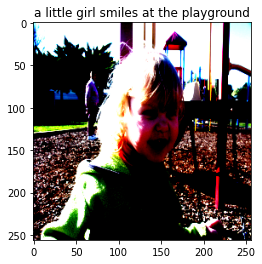

Original ['A', 'baby', 'girl', 'playing', 'at', 'a', 'park']
['two', 'women', 'are', 'riding', 'a', 'camel', 'with', 'a', 'tree']
['a', 'woman', 'wearing', 'a', 'red', 'shirt', 'and', 'black', 'pants', 'is', 'riding', 'a', 'horse', 'with', 'a', 'man']
['two', 'women', 'are', 'riding', 'on', 'a', 'horse']
['a', 'woman', 'wearing', 'a', 'red', 'shirt', 'is', 'riding', 'a', 'brown', 'horse']


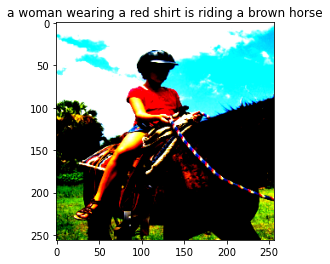

Original ['A', 'girl', 'in', 'a', 'helmet', 'rides', 'a', 'horse']
['a', 'man', 'wearing', 'a', 'hat', 'and', 'sunglasses', 'sits', 'in', 'a', 'crowd']
['a', 'man', 'with', 'sunglasses', 'on', 'his', 'head', 'stands', 'in', 'front', 'of', 'a', 'row', 'of', 'other', 'people', 'and', 'a', 'child']
['a', 'man', 'with', 'a', 'beard', 'at', 'an', 'outdoor', 'event']
['a', 'man', 'wearing', 'a', 'grey', 'hat', 'is', 'standing', 'next', 'to', 'two', 'children', 'at', 'an', 'outdoor', 'table']


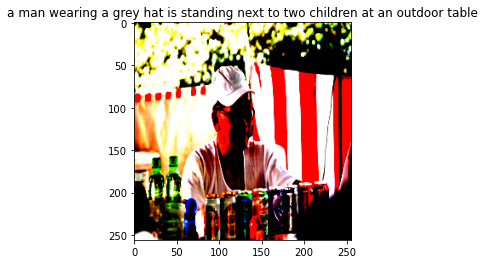

Original ['a', 'Korean', 'man', 'sells', 'soda']
['two', 'men', 'in', 'a', 'red', 'hats', 'and', 'hats', 'are', 'standing', 'in', 'front', 'of', 'a', 'christmas', 'tree']
['two', 'men', 'in', 'a', 'hats', 'are', 'looking', 'up', 'at', 'each', 'other']
['a', 'man', 'in', 'a', 'costume', 'looks', 'at', 'the', 'camera']
['a', 'man', 'in', 'a', 'costume', 'is', 'holding', 'up', 'a', 'peace', 'sign', 'between', 'two', 'ladies']


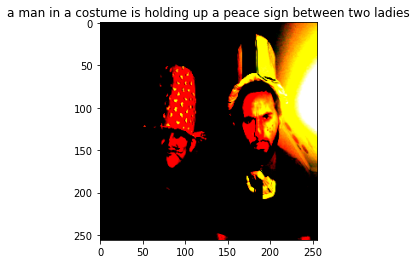

Original ['The', 'hatted', 'males', 'pose', 'for', 'a', 'picture']
['three', 'people', 'sit', 'in', 'an', 'enclosed', 'building']
['a', 'boy', 'sits', 'on', 'a', 'bench', 'in', 'front', 'of', 'a', 'brick', 'building']
['three', 'people', 'are', 'sitting', 'on', 'a', 'brick', 'wall', 'beside', 'a', 'brick', 'building']
['three', 'people', 'sitting', 'on', 'benches']


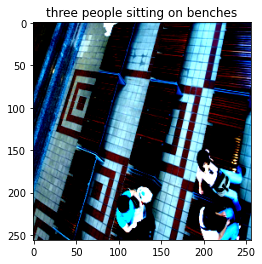

Original ['A', 'person', 'in', 'a', 'blue', 'shirt', 'sits', 'behind', 'two', 'people', 'sitting', 'on', 'a', 'wood', 'bench']
['a', 'man', 'wearing', 'a', 'white', 'hat', 'and', 'sunglasses', 'is', 'holding', 'a', 'white', 'and', 'blue', 'object', 'in', 'his', 'mouth']
['two', 'men', 'with', 'shaved', 'heads', 'and', 'hats']
['a', 'man', 'in', 'a', 'white', 'shirt', 'and', 'sunglasses', 'stands', 'next', 'to', 'a', 'girl', 'in', 'a', 'white', 'shirt']
['a', 'man', 'in', 'a', 'white', 'shirt', 'and', 'a', 'woman', 'wearing', 'a', 'blue', 'hat', 'and', 'sunglasses']


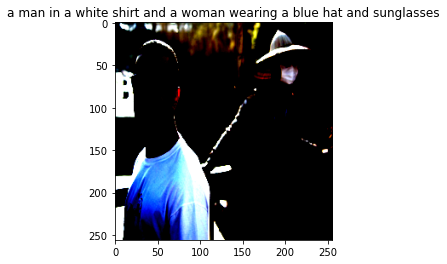

Original ['A', 'man', 'in', 'sunglasses', 'on', 'an', 'overpass']
['three', 'children', 'are', 'diving', 'into', 'a', 'pool']
['two', 'boys', 'are', 'diving', 'into', 'a', 'pool']
['a', 'boy', 'jumps', 'into', 'a', 'swimming', 'pool', 'while', 'a', 'man', 'watches']
['a', 'boy', 'jumps', 'into', 'a', 'pool']


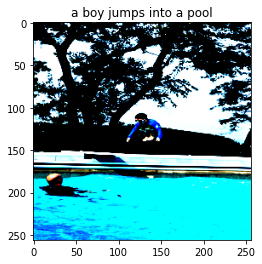

Original ['A', 'boy', 'in', 'a', 'wetsuit', 'jumps', 'into', 'a', 'pool', 'with', 'a', 'bald', 'man']
['a', 'boy', 'in', 'a', 'green', 'shirt', 'is', 'diving', 'into', 'a', 'pool']
['a', 'boy', 'is', 'jumping', 'into', 'the', 'pool']
['a', 'boy', 'jumps', 'off', 'of', 'a', 'diving', 'into', 'a', 'pool']
['a', 'boy', 'jumps', 'into', 'a', 'pool']


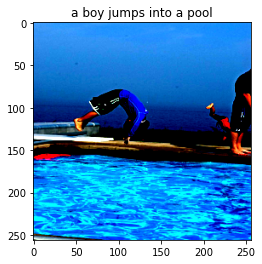

Original ['A', 'boy', 'flips', 'off', 'a', 'diving', 'board', 'into', 'a', 'pool']
['a', 'woman', 'holds', 'a', 'baby', 'points', 'to', 'a', 'woman', 'as', 'a', 'dog', 'points']
['a', 'woman', 'holds', 'a', 'child', "'s", 'hand', 'as', 'a', 'crowd', 'watches', 'children']
['a', 'woman', 'holds', 'a', 'little', 'girl', 'who', 'is', 'trying', 'to', 'catch', 'her']
['a', 'woman', 'holds', 'a', 'child', "'s", 'hand', 'as', 'a', 'crowd', 'watches']


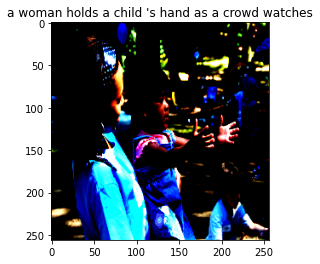

Original ['A', 'lady', 'holds', 'a', 'little', 'girl', 'who', 'is', 'trying', 'to', 'catch', 'bubbles']
['two', 'dogs', 'are', 'playing', 'together', 'on', 'the', 'grass', 'near', 'the', 'street']
['two', 'dogs', 'are', 'playing', 'with', 'a', 'green', 'ball', 'in', 'the', 'grass']
['two', 'dogs', 'run', 'through', 'a', 'field']
['two', 'dogs', 'play', 'with', 'each', 'other', 'in', 'the', 'grass']


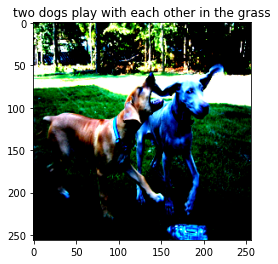

Original ['A', 'brown', 'dog', 'biting', 'a', 'gray', 'dogs', 'ear']
['a', 'girl', 'in', 'blue', 'runs', 'through', 'the', 'field', 'as', 'a', 'crowd', 'watches']
['a', 'woman', 'wearing', 'a', 'blue', 'uniform', 'and', 'a', 'boy', 'in', 'a', 'blue', 'shirt', 'runs', 'with', 'a', 'soccer', 'ball']
['two', 'girls', 'in', 'blue', 'and', 'white', 'are', 'running', 'in', 'the', 'field']
['women', 'in', 'blue', 'and', 'blue', 'uniforms', 'are', 'playing', 'soccer']


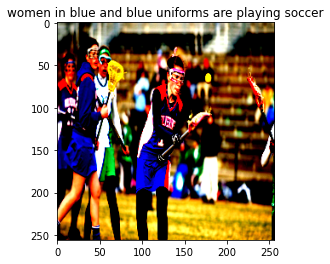

Original ['Girls', 'wearing', 'sports', 'uniforms', 'and', 'eye', 'protection']
['a', 'dog', 'is', 'running', 'through', 'a', 'field']
['a', 'dog', 'is', 'running', 'through', 'a', 'field', 'while', 'people', 'watch']
['three', 'dogs', 'run', 'through', 'the', 'grass']
['three', 'dogs', 'running', 'through', 'grass']


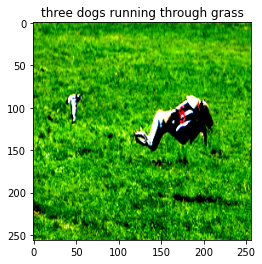

Original ['A', 'dog', 'in', 'a', 'number', 'six', 'jersey', 'is', 'running', 'through', 'a', 'field']
['two', 'brown', 'dogs', 'are', 'running', 'on', 'a', 'beach', 'with', 'a', 'man', 'behind', 'them', '.', '<PAD>']
['two', 'brown', 'dogs', 'are', 'running', 'on', 'the', 'beach']
['a', 'brown', 'dog', 'and', 'a', 'black', 'foal', 'in', 'the', 'sand']
['two', 'large', 'brown', 'dogs', 'are', 'playing', 'in', 'the', 'sand']


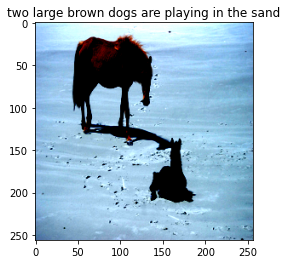

Original ['A', 'brown', 'horse', 'and', 'a', 'black', 'foal', 'on', 'the']
--------------------------------------------------------------------------------
Torch metrics
BLEU-1 0.35120707074989127
BLEU-2 0.1789211035330783
BLEU-3 0.1054519902420567
BLEU-4 0.06222680791229005
--------------------------------------------------------------------------------
Nltk metrics
BLEU-1 0.35120706761118536
BLEU-2 0.1789210935006095
BLEU-3 0.10545201298027904
BLEU-4 0.062226801193804714


In [47]:
# BLEU-1 0.37580852372628865
# BLEU-2 0.20279312314498052
# BLEU-3 0.1336495197621457
# BLEU-4 0.08562499041793889
checker()

In [23]:

def show_image2(inp, index, title=None):
    """Imshow for Tensor."""
    inp = inp.numpy().transpose((1, 2, 0))
    plt.imshow(inp)
    
 
    if title is not None:
        plt.title(title)
    name  = 'showcase' + str(index) + '.png'
    plt.savefig(name, bbox_inches='tight')
    
    plt.pause(0.001)  # pause a bit so that plots are updated

In [63]:
import nltk
def bleu_score_checker():
    gc = []
    test = []
    # Will execute only 200 times. Inner 5 times
    offset = 37500
    for i in range(0,500,5):
        temp_gc = []
        encoder.eval()
        decoder.eval()
        with torch.no_grad():
            img, caption = dataset.evaluation(dataset,i + offset)
            img = img.unsqueeze(0)
#             print(caption)
            
            encoded_output = encoder(img.to(device))
            
            caps = decoder.beam_search(encoded_output, 3)
            
            caps = [dataset.vocab.itos[idx] for idx in caps]
            
            generated_caption = ' '.join(caps)
#             show_image2(img.squeeze(0),i,title=generated_caption)
            
            caption = caption.split()[:-1]
            generated_caption = generated_caption.split()[1:]
            generated_caption = generated_caption[:-2]
            
            test.append(generated_caption)
            temp_gc.append(caption)
        for j in range(1,5):
            img, caption = dataset.evaluation(dataset, i + j + offset)
            temp_gc.append(caption)
        gc.append(temp_gc)
        decoder.train()
        encoder.train()
    print("-" * 80)
    print("Torch metrics")
    print("BLEU-1", bleu_score(test,gc, max_n = 1, weights = [1] ) )
    
    print("BLEU-2", bleu_score(test, gc, max_n = 2, weights = [0.5,0.5]))
    
    print("BLEU-3", bleu_score(test, gc, max_n = 3, weights = [0.33,0.33,0.33]))
    
    print("BLEU-4", bleu_score(test, gc, max_n = 4, weights = [0.25,0.25, 0.25, 0.25]))
    
    
    print("-"*80)
    print("Nltk metrics")
    BLEU4 = nltk.translate.bleu_score.corpus_bleu(gc, test,weights=(0.25,0.25,0.25,0.25))
    BLEU1 = nltk.translate.bleu_score.corpus_bleu(gc, test,weights=(1.0,0,0,0))
    BLEU2 = nltk.translate.bleu_score.corpus_bleu(gc, test,weights=(0.5,0.5,0,0))
    BLEU3 = nltk.translate.bleu_score.corpus_bleu(gc, test,weights=(0.33,0.33,0.33,0))
    
    
    print(f"BLEU-1 {BLEU1}")
    print(f"BLEU-2 {BLEU2}")
    print(f"BLEU-3 {BLEU3}")
    print(f"BLEU-4 {BLEU4}")
    
#     print("GC" , gc)
#     print("Predictions", test)
        
    

In [64]:
bleu_score_checker()

--------------------------------------------------------------------------------
Torch metrics
BLEU-1 0.3292583277735053
BLEU-2 0.1457195554989439
BLEU-3 0.06779695080525858
BLEU-4 0.024660026516311894
--------------------------------------------------------------------------------
Nltk metrics
BLEU-1 0.3292583142743177
BLEU-2 0.14571954510286078
BLEU-3 0.06779696887845656
BLEU-4 0.024660026930301608



# Train Eval code used earlier.(DUMP below this point)


In [ ]:
# !pip install pipreqs
import pipreqs
pipreqs